# Schwingungen
## 3. Abgabe aus dem Fach Modellbildung und Simulation
von Alexandra Mayer und Nicholas Meyer

In [1]:
import numpy as np
from scipy import integrate
import matplotlib.pyplot as plt
#print(plt.style.available)
plt.style.use('bmh')
import sympy as sy
sy.init_printing(use_latex=True)
from ipywidgets import FloatProgress
from IPython.display import display

### 1. Gedämpfte Schwingungen

Wenn auf eine Masse eine Kraft wirkt, die proportional zu Auslenkung $(F= -Dx) $ aus der Ruhelage ist, schwingt die Masse harmonisch. Die potentielle und kinetische Energie werden während der Schwingung ineinander umgewandelt. In der Realität hat man es aber mit Energie dissipierenden Reibungskräften zu tun. Die Reibungskraft wirkt immer entgegeb der Bewegungsrichtung. Betrachten Sie verschiedene Reibungskräfte, die proportional zu $v^n$ (mit $n = 0, \frac{1}{2}, 1, 2)$ sind, und stellen Sie die Amplitude als Funktion der Zeit für verschiedene Reibungsstärken dar. 

### 2. Das nichtlinear Pendel I
Schreiben Sie ein Programm zur Lösung der Differentialgleichung $ \frac{d^2 \theta}{dt^2} = - \frac{g}{l} sin( \theta) \ (g=9.81 m/s^2, l = 10 \mathrm{cm})$. Visualisieren Sie den Auslenkungswinkel $\theta$ als Funktion der Zeit für verschiedene Anfangsauslenkungen $\theta_0$ und Anfangsgeschwindigkeit $v_0 = 0$

In [2]:
def nonLinPendulum(y, t):
    g = 9.81
    l = 10
    dy = np.zeros_like(y)
    dy[0] = y[1]
    dy[1] = (-g/l)*np.sin(y[0])
    return dy

In [3]:
def coorThetas(y0, t0, tend, N):
    tvals = np.linspace(t0, tend, N)
    thetas = integrate.odeint(nonLinPendulum, y0, tvals)
    return tvals, thetas

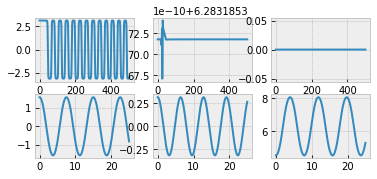

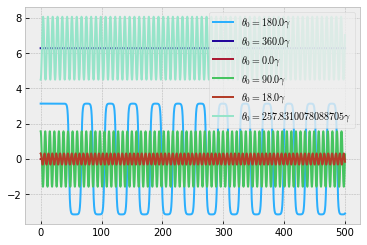

In [4]:
theta0s = [np.pi, 2*np.pi, 0, np.pi/2, np.pi/10, 4.5]
ts = []
for i in range(0, len(theta0s)):
    plt.figure(1)
    number = 330 + i + 1
    y0 = [theta0s[i], 0.]
    tvals, thetas = coorThetas(y0, 0, 500, 10000)
    ts.append(thetas)
    plt.subplot(number)
    if i < 3:
        plt.plot(tvals, thetas[:, 0])
    else:
        plt.plot(tvals[0:500], thetas[0:500, 0])
    plt.figure(2)
    plt.plot(tvals, thetas[:, 0], c=np.random.rand(3,), label=u'$\\theta_0 = '+str(theta0s[i]*(180/np.pi))+u'°$')
    plt.legend()
    #for t in ts:
#    plt.figure(2)
#    plt.plot(tvals, t)

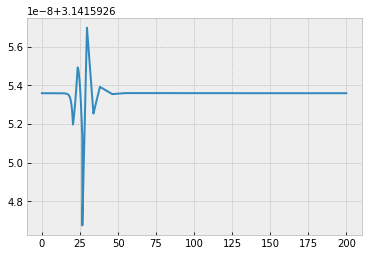

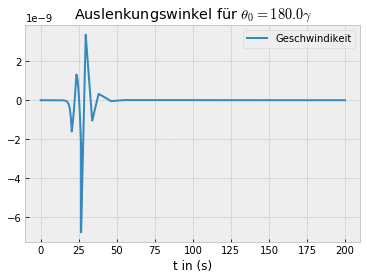

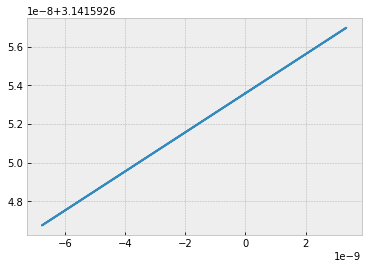

In [5]:
# Frage: Geschwindikeit Winkelgeschwindigkeit oder Geschwindigkeit des Pendels
theta0_1 = np.pi
y0 = [theta0_1, 0.]
tvals_1, thetas_1 = coorThetas(y0, 0, 200, 8000)
plt.plot(tvals_1, thetas_1[:, 0], label=u'Auslenkungswinkel $\\theta$ (rad)')
plt.show()
plt.plot(tvals_1, thetas_1[:, 1], label=u'Geschwindikeit')
plt.title(u'Auslenkungswinkel für $\\theta_0='+str(theta0_1*(180/np.pi))+'°$')
plt.legend()
plt.xlabel('t in (s)')
plt.show()
plt.plot(thetas_1[:, 1], thetas_1[:, 0])
plt.show()

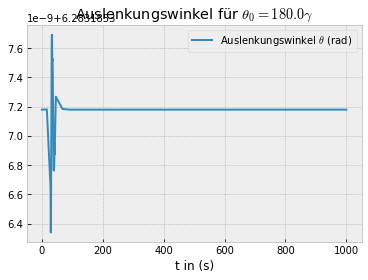

In [6]:
theta0_2 = 2*np.pi
y0 = [theta0_2, 0.]
tvals_2, thetas_2 = coorThetas(y0, 0, 1000, 10000)
plt.plot(tvals_2, thetas_2[:, 0], label=u'Auslenkungswinkel $\\theta$ (rad)')
#plt.show()
#plt.plot(tvals, thetas[:, 1], label=u'Geschwindikeit')
plt.title(u'Auslenkungswinkel für $\\theta_0='+str(theta0_1*(180/np.pi))+'°$')
plt.legend()
plt.xlabel('t in (s)')
plt.show()

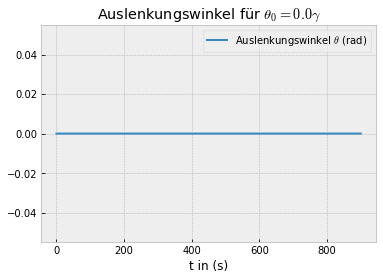

In [7]:
theta0 = 0
y0 = [theta0, 0.]
tvals_3, thetas_3 = coorThetas(y0, 0, 900, 10000)
plt.plot(tvals_3, thetas_3[:, 0], label=u'Auslenkungswinkel $\\theta$ (rad)')
#plt.plot(tvals_3, thetas_3[:, 1], ':', label=u'Geschwindikeit')
plt.title(u'Auslenkungswinkel für $\\theta_0='+str(theta0*(180/np.pi))+'°$')
plt.legend()
plt.xlabel('t in (s)')
plt.show()

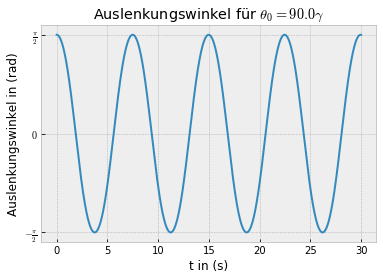

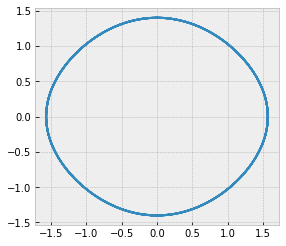

In [8]:
theta0 = np.pi/2
y0 = [theta0, 0.]
tvals_4, thetas_4 = coorThetas(y0, 0, 30, 10000)
plt.plot(tvals_4, thetas_4[:, 0], label=u'Auslenkungswinkel $\\theta$ (rad)')
#plt.plot(tvals_4, thetas_4[:, 1], label=u'Geschwindikeit')
plt.title(u'Auslenkungswinkel für $\\theta_0='+str(theta0*(180/np.pi))+'°$')
#plt.legend()
plt.xlabel('t in (s)')
plt.ylabel('Auslenkungswinkel in (rad)')
plt.yticks( [-np.pi/2, 0, np.pi/2],
            [r'$-\frac{\pi}{2}$', r'$0$', r'$\frac{\pi}{2}$'])
plt.show()
plt.plot(thetas_4[:, 0], thetas_4[:, 1])
plt.axis('scaled')
plt.show()

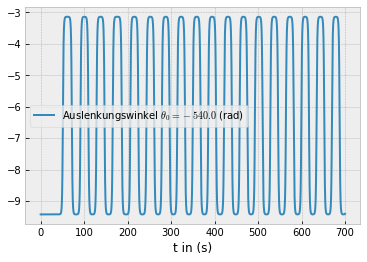

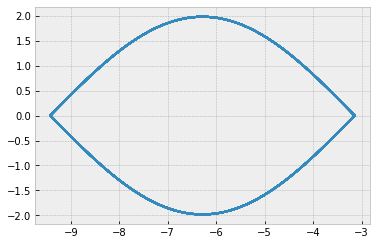

In [9]:
theta0 = -3*np.pi
y0 = [-3*np.pi, 0]
tvals_5, thetas_5 = coorThetas(y0, 0, 700, 100000)
plt.plot(tvals_5, thetas_5[:, 0], label=u'Auslenkungswinkel $\\theta_0 = '+str(theta0*(180/np.pi))+u'$ (rad)')
#plt.plot(tvals_5, thetas_5[:, 1], label=u'Geschwindikeit')
plt.legend()
plt.xlabel('t in (s)')
plt.show()
plt.plot(thetas_5[:, 0], thetas_5[:, 1])
#plt.axis('scaled')
plt.show()

In [10]:
def interactive(theta0):
    theta0 = (theta0*np.pi)/180
    zvals, tvals = coorThetas([theta0, 0], 0, 100, 100000)
    plt.plot(tvals[:, 0], tvals[:, 1])
    plt.axis('scaled')
    return plt.show()
from ipywidgets import interact, FloatSlider
interactive_plot = interact(interactive, theta0=FloatSlider(min=0, max=360, step=7.5, value=180))
interactive_plot

interactive(children=(FloatSlider(value=180.0, description='theta0', max=360.0, step=7.5), Output()), _dom_classes=('widget-interact',))

<function __main__.interactive>

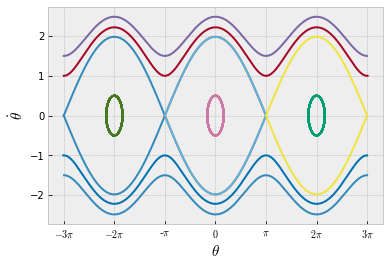

In [11]:
thetas = [-3*sy.pi, -2*sy.pi, -sy.pi, 0, sy.pi, 2*sy.pi, 3*sy.pi]
ges = {-3*sy.pi:[0, 1, 1.5], -2*sy.pi: [0.5], -sy.pi:[0], 0: [0.5], sy.pi:[0], 2*sy.pi:[0.5], 3*sy.pi:[0, -1, -1.5]}

for theta0 in thetas:
    for ges0 in ges[theta0]:
        if abs(ges0) < 1:
            tvals, ts = coorThetas([float(theta0), ges0], 0, 77, 10000)
        elif abs(ges0) < 1.5:
            tvals, ts = coorThetas([float(theta0), ges0], 0, 12.2, 10000)
        else:
            tvals, ts = coorThetas([float(theta0), ges0], 0, 9.6, 10000)
            
        plt.plot(ts[:, 0], ts[:, 1], label='theta '+str(theta0)+' ges '+str(ges0))
plt.xticks( [-3*np.pi, -2*np.pi, -np.pi, 0, np.pi, 2*np.pi, 3*np.pi],
            [ r'$-3\pi$', r'$-2\pi$', r'-$\pi$', r'$0$', r'$\pi$', r'$2\pi$', r'$3\pi$'])
plt.yticks([-2, -1, 0, 1, 2])
plt.xlabel(r'$\theta$', size=15)
plt.ylabel(r'$\dot{\theta}$', size=15)
plt.grid(True)
plt.show()

### 3. Erzwungene Schwingung
Beschreiben sie numereisch algemeine erzwungene Schwingungen eines gedämpften harmonischen Oszillators mit der Differentialgleichung:

$$ m \ddot{x} + c\dot{x} + Dx = F_0 \mathrm{cos}( \Omega t) $$

($m$: Masse, $c$: Reibungskoeffizient, $D$: Federkonstante, $F_0$: Kraftamplitude, $\Omega$: äußere Kreisfrequenz, $t$: Zeit). Stellen Sie die Amplitude im eingeschwungenen Zustand als Funktion der Frequenz $\Omega$ dar. Vergleichen Sie die Kurve mit dem analytischen Ergebnis und dem Fall eines kleinen nicht-linearen Anteils an der Federkraft $D_3x^3$.

$$ m \ddot{x} + c \dot{x} + D_1x + D_3x^3 = F_0 \mathrm{cos}( \Omega t) $$

Umformen:

$$ \ddot{x} = \frac{F_0}{m} \mathrm{cos}(\Omega t) - \frac{c}{m} \dot{x} - \frac{D}{m}x $$

Wobei $\frac{c}{m} = 2 \gamma$ und $\frac{D}{m} = \omega^2$, und somit:

$$ \ddot{x} = \frac{F_0}{m} \mathrm{cos}(\Omega t) - 2 \gamma \dot{x} - \omega^2 x$$

Substitution:
$$ y_1 = x $$
$$ y_2 = \dot{x} $$
$$ \dot{y_2} = \ddot{x} = \frac{F_0}{m} \mathrm{cos}(\Omega t) - 2 \gamma \dot{x} - \omega^2 x$$
$$ \dot{y_1} = y_2 $$

Und damit das DGL System:
$$ \begin{pmatrix} \dot{y_1} \\ \dot{y_2} \end{pmatrix} =
\begin{pmatrix} 0 & 1 \\ - \omega^2 & -2 \gamma \end{pmatrix}
\begin{pmatrix} y_1 \\ y_2 \end{pmatrix} + 
\begin{pmatrix} 0 \\ \frac{F_0}{m} \mathrm{cos}(\Omega t) \end{pmatrix}$$

In [12]:
def ODEforcedosz(y, t):
    dy = np.zeros_like(y)
    dy[0] = y[1]
    dy[1] = (F0/m)*np.cos(float(Omega)*t) - 2*gamma*y[1] - omega**2*y[0]
    return dy

In [13]:
def ODEfoszD3min(y, t):
    dy = np.zeros_like(y)
    dy[0] = y[1]
    dy[1] = (F0/m)*np.cos(float(Omega)*t) - 2*gamma*y[1] + omega**2*y[0] - (D_3)*y[0]**3
    return dy

In [14]:
def ODEfoszD3(y, t):
    dy = np.zeros_like(y)
    dy[0] = y[1]
    dy[1] = (F0/m)*np.cos(float(Omega)*t) - 2*gamma*y[1] - omega**2*y[0] - (D_3)*y[0]**3
    return dy

In [15]:
def coordForcedOsz(y0, t0, tend, N, D3=False, minus=False):
    tvals, h = np.linspace(t0, tend, N, retstep=True)
    if D3:
        if minus:
            coords = integrate.odeint(ODEfoszD3min, y0, tvals, rtol=1e-10, atol=1e-10)
        else:
            coords = integrate.odeint(ODEfoszD3, y0, tvals, rtol=1e-10, atol=1e-10)
    else:
        coords = integrate.odeint(ODEforcedosz, y0, tvals, rtol=1e-10, atol=1e-10)
    return coords[:, 0], tvals, coords[:, 1]

In [16]:
def amplitude(omega_i):
    A = (F0/m)/np.sqrt(float((omega**2-omega_i**2)**2+4*gamma**2*omega_i**2))
    return A

In [17]:
def amplitude_nan(omega):
    A = (omega*F0/m)/np.sqrt(flat(((D/m)-omega**2)**2+(c/m)**2*omega**2))

In [18]:
def coorAmp(omegas):
    aList = []
    for omega_i in omegas:
        aList.append(amplitude(omega_i))
    return aList

In [75]:
def analyticalForcedOsz(y0, t0, tend, N):
    gamma = (c/m)/2
    omega_2 = (D/m)
    print(gamma**2)
    print(omega_2)
    print(round(gamma**2, 5))
    tval = np.linspace(t0, tend, N)
    if round(gamma**2, 5) == omega_2:
        print('In same')
        eigval_1 = -gamma
        c2 = ((eigval_1*y0[0]-y0[1])/(np.exp(eigval_1*t0)*(-1-t0+eigval_1*t0)))
        c1 = (y0[1]/eigval_1*np.exp(eigval_1*t0))-c2*((1/eigval_1+t0))
        x_t = [c1*np.exp(eigval_1*t)+c2*t*np.exp(eigval_1*t) for t in tval]
    elif gamma**2 > omega_2:
        eigval_1 = -gamma + np.sqrt(gamma**2-omega_2)
        eigval_2 = -gamma - np.sqrt(gamma**2-omega_2)
        c2 = ((y0[1]-eigval_1*y0[0])/(np.exp(eigval_2*t0)))/(-eigval_1+eigval_2)
        c1 = (y0[0]-c2*np.exp(eigval_2*t0))/np.exp(eigval_1*t0)
        x_t = [c1*np.exp(eigval_1*t)+c2*np.exp(eigval_2*t) for t in tval]
    else:
        omega = np.sqrt(omega_2)
        B = (gamma*y0[0]*np.cos(omega*t0)+y0[0]*np.sin(omega*t0)+y0[1]*np.cos(omega*t0))*np.exp(gamma*t0)
        A = (np.exp(gamma*t0)/(gamma*np.cos(omega*t0)+np.sin(omega*t0)))*(-(y0[0]/2)*gamma**2*np.sin(2*omega*t0)+gamma*y0[0]*np.cos(2*omega*t0)-(gamma/2)*y0[1]*np.sin(2*omega*t0)+(y0[0]/2)*np.sin(2*omega*t0)+(y0[1]/2*np.cos(2*omega*t0)-(y0[1]/2)))
        x_t = [np.exp(-gamma*t)*(A*np.cos(omega*t)+B*np.sin(omega*t)) for t in tval]
    return x_t, tval

In [76]:
def eingeschwungen(y, ts):
    n = len(y)
    times = int(n/10)
    i = times
    #print(i, ' ', i+times, ' ', i+2*times)
    diff = np.mean(y[i:i+times])-np.mean(y[i+times:i+2*times])
    maximum = max(y[i+times:i+2*times])
    minimum = min(y[i+times:i+2*times])
    
    #print('diff1', diff)
    while abs(diff) > 1e-6 and i+3*times <= n:
        i += times
        diff = np.mean(y[i:i+times])-np.mean(y[i+times:i+2*times])
        #print('diff while', diff)
        maximum = max(y[i+times:i+2*times])
        minimum = min(y[i+times:i+2*times])
    return (maximum+abs(minimum))/2, diff

In [77]:
F0 = 2
m = 10
c = 1
D = 10
D_3 = 0.1
gamma = c/(2*m)
omega = sy.sqrt(D/m)
Omega = sy.sqrt(D/m)

In [ ]:
f = FloatProgress(min=0, max=103)
display(f)

y0 = [0., 0.]
co, ts, ges = coordForcedOsz(y0, 0, 140, 1000)
plt.plot(ts, co, label='Anfangsort: '+str(y0[0])+'\n Anfangsgeschwindikeit: '+str(y0[1]))
f.value += 1
AmpN = []
omegasn = np.linspace(0, 2, 100)
for o in omegasn:
    Omega = o
    time = 80
    steps = 100
    coa, tsa, gesa = coordForcedOsz(y0, 0, time, steps)
    cAmpN, err = eingeschwungen(coa, tsa)
    AmpN.append(cAmpN)
    f.value +=1
omegasn = np.linspace(0, 2, 100)
cAmp = coorAmp(omegasn)
f.value +=1
Omega = sy.sqrt(D/m)
y0 = [2., 0.]
co2, ts2, ges2 = coordForcedOsz(y0, 0, 140, 1000)
f.value +=1
plt.plot(ts2, co2, '--', label='Anfangsort: '+str(y0[0])+'\n Anfangsgeschwindikeit: '+str(y0[1]))
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.show()
p1 = plt.plot(co[0], ges[0], 'o')
col = p1[0].get_c()
plt.plot(co, ges, ':', color = col)
p2 = plt.plot(co2[0], ges2[0], 'o')
col2 = p2[0].get_c()
plt.plot(co2, ges2, ':', color = col2, alpha=0.5)
plt.show()

In [ ]:
F0 = 2
m = 10
c = 1
D = 10
D_3 = 0.1
gamma = c/(2*m)
omega = sy.sqrt(D/m)
Omega = sy.sqrt(D/m)
y0 = [0., -3.]
co, ts, ges = coordForcedOsz(y0, 0, 160, 1500)
p1 = plt.plot(ts, co, label='Anfangsort: '+str(y0[0])+'\n Anfangsgeschwindikeit: '+str(y0[1]))
col1 = p1[0].get_c()
y0 = [0., 5.]
co1, ts1, ges1 = coordForcedOsz(y0, 0, 160, 1500)
p2 = plt.plot(ts1, co1, '--', label='Anfangsort: '+str(y0[0])+'\n Anfangsgeschwindikeit: '+str(y0[1]))
y0 = [0., 0.]
col2 = p2[0].get_c()
co2, ts2, ges2 = coordForcedOsz(y0, 0, 160, 1500)
p3 = plt.plot(ts2, co2, color='#8BFAFF', label='Anfangsort: '+str(y0[0])+'\n Anfangsgeschwindikeit: '+str(y0[1]))
col3 = p3[0].get_c()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.show()
plt.plot(co[0], ges[0], 'o', color = col1)
plt.plot(co, ges, ':', color = col1)
plt.plot(co1[0], ges1[0], 'o', color = col2)
plt.plot(co1, ges1, ':', color=col2, alpha=0.7)
plt.plot(co2[0], ges2[0], 'o', color = col3)
plt.plot(co2, ges2, ':', color = col3, alpha=0.5)
plt.show()

In [ ]:
y0 = [3., 3.]
co, ts, ges = coordForcedOsz(y0, 0, 110, 10000)
plt.plot(ts, co, label='Anfangsort: '+str(y0[0])+'\n Anfangsgeschwindikeit: '+str(y0[1]))
y0 = [0., 0.]
co1, ts1, ges1 = coordForcedOsz(y0, 0, 110, 1000)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.show()
plt.plot(co, ges, ':')
plt.plot(co1, ges1, ':', alpha=0.5)
plt.show()

In [ ]:
#AmpN = cooAmpN(omegas)
plt.plot(omegasn, AmpN)
plt.plot(omegasn, cAmp, ':')
l = [i for i in np.arange(min(cAmp), max(cAmp), max(cAmp)/1000)]
om0 = np.sqrt(D/m)
plt.plot([om0 for h in l], l)
plt.show()

In [26]:
F0 = 2
m = 10
c = 1
D = 10
D_3 = 0.1
gamma = c/(2*m)
omega = sy.sqrt(D/m)
Omega = sy.sqrt(D/m)
om0 = Omega
f = FloatProgress(min=0, max=306)
display(f)
co, ts, ges = coordForcedOsz(y0, 0, 100, 1000)
f.value += 1
AmpN = []
omegasn = np.linspace(0, 2, 100)
for o in omegasn:
    Omega = o
    time = 800
    steps = 10000
    coa, tsa, gesa = coordForcedOsz(y0, 0, time, steps)
    cAmpN, err = eingeschwungen(coa, tsa)
    AmpN.append(cAmpN)
    f.value +=1
omegasn = np.linspace(0, 2, 100)
cAmp = coorAmp(omegasn)
f.value +=1
Omega = sy.sqrt(D/m)
F0 = 5
co1, ts1, ges1 = coordForcedOsz(y0, 0, 100, 1000)
om01 = Omega
f.value += 1
AmpN1 = []
omegasn = np.linspace(0, 2, 100)
for o in omegasn:
    Omega = o
    time = 800
    steps = 10000
    coa, tsa, gesa = coordForcedOsz(y0, 0, time, steps)
    cAmpN, err = eingeschwungen(coa, tsa)
    AmpN1.append(cAmpN)
    f.value +=1
omegasn = np.linspace(0, 2, 100)
cAmp1 = coorAmp(omegasn)
f.value +=1
Omega = sy.sqrt(D/m)
F0 = 20
co2, ts2, ges2 = coordForcedOsz(y0, 0, 100, 1000)
om02 = Omega
f.value += 1
AmpN2 = []
omegasn = np.linspace(0, 2, 100)
for o in omegasn:
    Omega = o
    time = 800
    steps = 10000
    coa, tsa, gesa = coordForcedOsz(y0, 0, time, steps)
    cAmpN, err = eingeschwungen(coa, tsa)
    AmpN2.append(cAmpN)
    f.value +=1
omegasn = np.linspace(0, 2, 100)
cAmp2 = coorAmp(omegasn)
f.value +=1

FloatProgress(value=0.0, max=306.0)

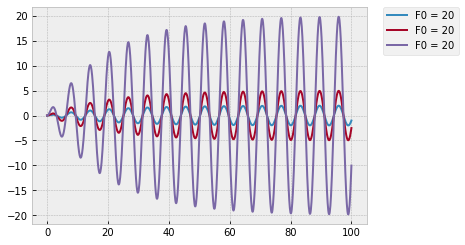

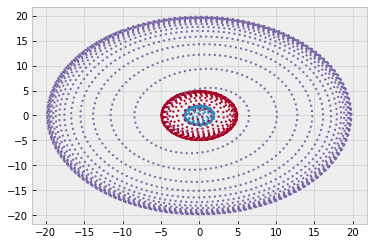

In [27]:
plt.plot(ts, co, label='F0 = '+str(F0))
plt.plot(ts1, co1, label='F0 = '+str(F0))
plt.plot(ts2, co2, label='F0 = '+str(F0))
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.show()
plt.plot(co, ges, ':')
plt.plot(co1, ges1, ':')
plt.plot(co2, ges2, ':')
plt.show()

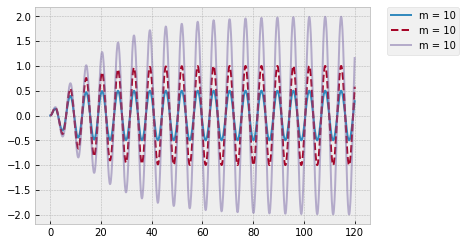

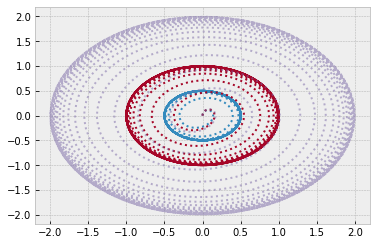

In [28]:
F0 = 2
m = 10
c = 4
D = 10
D_3 = 0.1
gamma = c/(2*m)
omega = sy.sqrt(D/m)
Omega = sy.sqrt(D/m)
y0 = [0., 0.]
co, ts, ges = coordForcedOsz(y0, 0, 120, 1000)
plt.plot(ts, co, label='m = '+str(m))
F0 = 2
m = 10
c = 2
D = 10
D_3 = 0.1
gamma = c/(2*m)
omega = sy.sqrt(D/m)
Omega = sy.sqrt(D/m)
y0 = [0., 0.]
co1, ts1, ges1 = coordForcedOsz(y0, 0, 120, 1000)
plt.plot(ts1, co1, '--', label='m = '+str(m))
F0 = 2
m = 10
c = 1
D = 10
D_3 = 0.1
gamma = c/(2*m)
omega = sy.sqrt(D/m)
Omega = sy.sqrt(D/m)
y0 = [0., 0.]
co2, ts2, ges2 = coordForcedOsz(y0, 0, 120, 1000)
plt.plot(ts2, co2, label='m = '+str(m), alpha=0.5)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.show()
plt.plot(co, ges, ':')
plt.plot(co1, ges1, ':')
plt.plot(co2, ges2, ':', alpha=0.5)
plt.show()

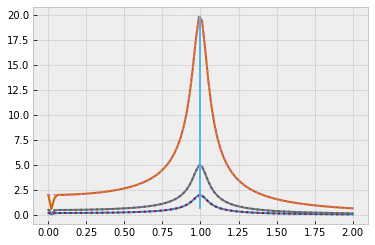

In [29]:
plt.plot(omegasn, AmpN)
plt.plot(omegasn, cAmp, ':')
plt.plot(omegasn, AmpN1)
plt.plot(omegasn, cAmp1, ':')
plt.plot(omegasn, AmpN2)
plt.plot(omegasn, cAmp2, ':')
l = [i for i in np.arange(min(cAmp2), max(cAmp2), max(cAmp2)/1000)]
plt.plot([om0 for h in l], l)
plt.show()

In [30]:
F0 = 2
m = 1
c = 1
D = 10
D_3 = 0.1
gamma = c/(2*m)
omega = sy.sqrt(D/m)
Omega = sy.sqrt(D/m)
om0 = Omega
f = FloatProgress(min=0, max=306)
display(f)
y0 = [0., 0.]
co, ts, ges = coordForcedOsz(y0, 0, 120, 1000)
f.value += 1
AmpN = []
omegasn = np.linspace(0, 5, 100)
for o in omegasn:
    Omega = o
    time = 800
    steps = 10000
    coa, tsa, gesa = coordForcedOsz(y0, 0, time, steps)
    cAmpN, err = eingeschwungen(coa, tsa)
    AmpN.append(cAmpN)
    f.value +=1
omegasn = np.linspace(0, 5, 100)
cAmp = coorAmp(omegasn)
f.value +=1
m = 5
gamma = c/(2*m)
omega = sy.sqrt(D/m)
Omega = sy.sqrt(D/m)
om01 = Omega
co1, ts1, ges1 = coordForcedOsz(y0, 0, 120, 1000)
f.value += 1
AmpN1 = []
omegasn1 = np.linspace(0, 5, 100)
for o in omegasn1:
    Omega = o
    time = 800
    steps = 10000
    coa, tsa, gesa = coordForcedOsz(y0, 0, time, steps)
    cAmpN, err = eingeschwungen(coa, tsa)
    AmpN1.append(cAmpN)
    f.value +=1
omegasn1 = np.linspace(0, 5, 100)
cAmp1 = coorAmp(omegasn1)
f.value +=1
m = 10
gamma = c/(2*m)
omega = sy.sqrt(D/m)
Omega = sy.sqrt(D/m)
om02 = Omega
co2, ts2, ges2 = coordForcedOsz(y0, 0, 120, 1000)
f.value += 1
AmpN2 = []
omegasn2 = np.linspace(0, 5, 100)
for o in omegasn2:
    Omega = o
    time = 800
    steps = 10000
    coa, tsa, gesa = coordForcedOsz(y0, 0, time, steps)
    cAmpN, err = eingeschwungen(coa, tsa)
    AmpN2.append(cAmpN)
    f.value +=1
omegasn2 = np.linspace(0, 5, 100)
cAmp2 = coorAmp(omegasn2)
f.value +=1

FloatProgress(value=0.0, max=306.0)

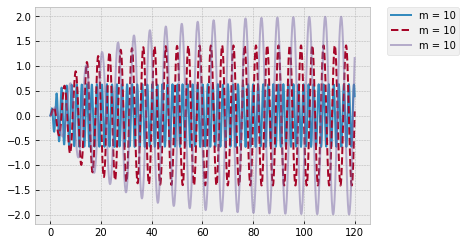

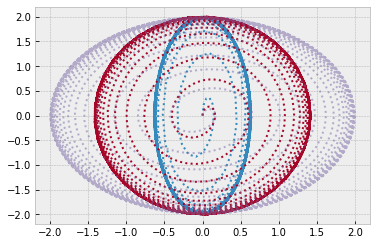

In [31]:
plt.plot(ts, co, label='m = '+str(m))
plt.plot(ts1, co1, '--', label='m = '+str(m))
plt.plot(ts2, co2, label='m = '+str(m), alpha=0.5)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.show()
plt.plot(co, ges, ':')
plt.plot(co1, ges1, ':')
plt.plot(co2, ges2, ':', alpha=0.5)
plt.show()

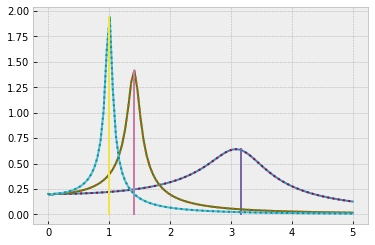

In [32]:
plt.plot(omegasn, AmpN)
plt.plot(omegasn, cAmp, ':')
l = [i for i in np.arange(0, max(cAmp), max(cAmp)/1000)]
plt.plot([om0 for h in l], l)
plt.plot(omegasn1, AmpN1)
plt.plot(omegasn1, cAmp1, ':')
l = [i for i in np.arange(0, max(cAmp1), max(cAmp1)/1000)]
plt.plot([om01 for h in l], l)
plt.plot(omegasn, AmpN2)
plt.plot(omegasn, cAmp2, ':')
l = [i for i in np.arange(0, max(cAmp2), max(cAmp2)/1000)]
plt.plot([om02 for h in l], l)
plt.show()

In [33]:
F0 = 2
m = 10
c = 1
D = 5
gamma = c/(2*m)
omega = sy.sqrt(D/m)
Omega = sy.sqrt(D/m)
om0 = Omega
f = FloatProgress(min=0, max=102)
display(f)
y0 = [0., 0.]
co, ts, ges = coordForcedOsz(y0, 0, 120, 1000)
f.value += 1
AmpN = []
omegasn = np.linspace(0, 2, 100)
for o in omegasn:
    Omega = o
    time = 800
    steps = 10000
    coa, tsa, gesa = coordForcedOsz(y0, 0, time, steps)
    cAmpN, err = eingeschwungen(coa, tsa)
    AmpN.append(cAmpN)
    f.value +=1
omegasn = np.linspace(0, 2, 100)
cAmp = coorAmp(omegasn)
f.value +=1

FloatProgress(value=0.0, max=102.0)

In [34]:
D = 10
omega = sy.sqrt(D/m)
Omega = sy.sqrt(D/m)
om01 = Omega
f = FloatProgress(min=0, max=102)
display(f)
co1, ts1, ges1 = coordForcedOsz(y0, 0, 120, 1000)
f.value += 1
AmpN1 = []
omegasn1 = np.linspace(0, 2, 100)
for o in omegasn1:
    Omega = o
    time = 800
    steps = 10000
    coa, tsa, gesa = coordForcedOsz(y0, 0, time, steps)
    cAmpN, err = eingeschwungen(coa, tsa)
    AmpN1.append(cAmpN)
    f.value +=1
omegasn1 = np.linspace(0, 2, 100)
cAmp1 = coorAmp(omegasn1)
f.value +=1

FloatProgress(value=0.0, max=102.0)

In [35]:
D = 20
omega = sy.sqrt(D/m)
Omega = sy.sqrt(D/m)
om02 = Omega
f = FloatProgress(min=0, max=102)
display(f)
co2, ts2, ges2 = coordForcedOsz(y0, 0, 120, 1000)
f.value += 1
AmpN2 = []
omegasn2 = np.linspace(0, 2, 100)
for o in omegasn2:
    Omega = o
    time = 800
    steps = 10000
    coa, tsa, gesa = coordForcedOsz(y0, 0, time, steps)
    cAmpN, err = eingeschwungen(coa, tsa)
    AmpN2.append(cAmpN)
    f.value +=1
omegasn2 = np.linspace(0, 2, 100)
cAmp2 = coorAmp(omegasn2)
f.value +=1

FloatProgress(value=0.0, max=102.0)

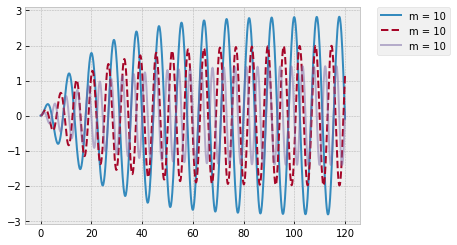

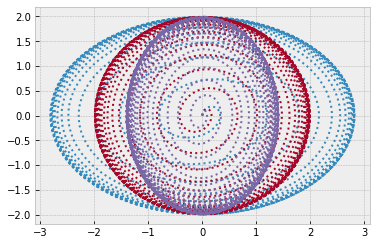

In [36]:
plt.plot(ts, co, label='m = '+str(m))
plt.plot(ts1, co1, '--', label='m = '+str(m))
plt.plot(ts2, co2, label='m = '+str(m), alpha=0.5)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.show()
plt.plot(co, ges, ':')
plt.plot(co1, ges1, ':')
plt.plot(co2, ges2, ':')
plt.show()

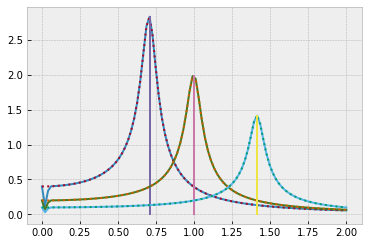

In [37]:
plt.plot(omegasn, AmpN)
plt.plot(omegasn, cAmp, ':')
l = [i for i in np.arange(0, max(cAmp), max(cAmp)/1000)]
plt.plot([om0 for h in l], l)
plt.plot(omegasn1, AmpN1)
plt.plot(omegasn1, cAmp1, ':')
l = [i for i in np.arange(0, max(cAmp1), max(cAmp1)/1000)]
plt.plot([om01 for h in l], l)
plt.plot(omegasn2, AmpN2)
plt.plot(omegasn2, cAmp2, ':')
l = [i for i in np.arange(0, max(cAmp2), max(cAmp2)/1000)]
plt.plot([om02 for h in l], l)
plt.show()

In [38]:
F0 =0.01
m = 10
c = 0
D = 10
D_3 = 10
gamma = c/(2*m)
omega = sy.sqrt(D/m)
Omega = sy.sqrt(D/m)
om0 = Omega
y0 = [0., 0.]
co, ts, ges = coordForcedOsz(y0, 0, 1000, 10000, D3=True)
co1, ts1, ges1 = coordForcedOsz(y0, 0, 1000, 10000, D3=True)

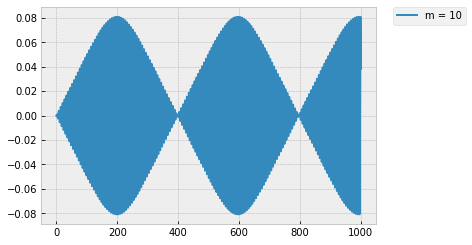

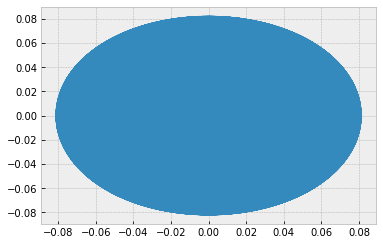

In [39]:
plt.plot(ts, co, label='m = '+str(m))
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.show()


plt.plot(co, ges)

In [40]:
omegas = np.linspace(0.1, 1.5, 100)
AmpND3 = []
f = FloatProgress(min=0, max=100)
display(f)
time = 800
steps = 150000
for o in omegas:
    Omega = o
    co, ts, ges = coordForcedOsz(y0, 0, time, steps, D3=True)
    
    cAmpND3, err = eingeschwungen(co, ts)
    f.value += 1
    AmpND3.append(cAmpND3)

FloatProgress(value=0.0)

In [41]:

#maxA = sy.sqrt((2/(3*D_3)*(omega**2-gamma**2))**2+((F0/m)**2)/(3*D_3*gamma**2))-(2/(3*D_3))*(omega**2-gamma**2)
As = np.linspace(0.000001, 0.01, 1000)
a1 = []
a2 = []
o1 = []
o2 = []
for A_i in As:
    R = (F0/m)**2-4*gamma**2*(omega**2+(3/4)*D_3*(A_i))*A_i+4*gamma**4*A_i

    om = omega**2+(3/4)*D_3*A_i-2*gamma**2+(1/sy.sqrt(A_i))*(sy.sqrt(R))
    om2 = omega**2+(3/4)*D_3*A_i-2*gamma**2-(1/sy.sqrt(A_i))*(sy.sqrt(R))
    if complex(om2).real > 0:
        
        a2.append(sy.sqrt(A_i))
        o2.append(sy.sqrt(om2))
    a1.append(sy.sqrt(A_i))
    o1.append(sy.sqrt(om))

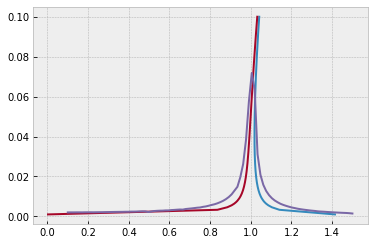

In [42]:
plt.plot(o1, a1)
plt.plot(o2, a2)
plt.plot(omegas, AmpND3)

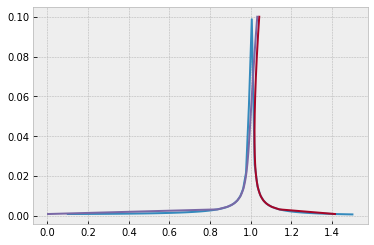

In [43]:
cAmp2 = coorAmp(omegas)
plt.plot(omegas, cAmp2)
plt.plot(o1, a1)
plt.plot(o2, a2)

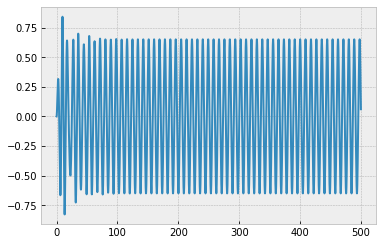

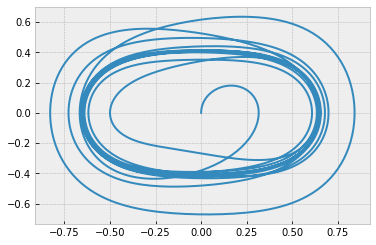

In [44]:
F0 =2
m = 10
c = 1
D = 5
D_3 = 1
gamma = c/(2*m)
omega = sy.sqrt(D/m)
Omega = sy.sqrt(D/m)
y0 = [0., 0.]
co, ts, ges = coordForcedOsz(y0, 0,500, 10000, D3=True)
plt.plot(ts, co)
plt.show()
plt.plot(co, ges)

In [45]:
omegas = np.linspace(0.1, 2, 100)
AmpND3 = []
f = FloatProgress(min=0, max=100)
display(f)
time = 800
steps = 150000
for o in omegas:
    Omega = o
    co, ts, ges = coordForcedOsz(y0, 0, time, steps, D3=True)
    cAmpND3, err = eingeschwungen(co, ts)
    
    f.value += 1
    AmpND3.append(cAmpND3)

FloatProgress(value=0.0)

In [46]:
maxA = sy.sqrt((2/(3*D_3)*(omega**2-gamma**2))**2+((F0/m)**2)/(3*D_3*gamma**2))-(2/(3*D_3))*(omega**2-gamma**2)
print('max A', (maxA))
As = np.linspace(0.001, (float(maxA))-0.001, 1000)
a1 = []
a2 = []
o1 = []
o2 = []
for A_i in As:
    #print('A_i', A_i) 
    R = (F0/m)**2-4*gamma**2*(omega**2+(3/4)*D_3*(A_i))*A_i+4*gamma**4*A_i

    om = omega**2+(3/4)*D_3*A_i-2*gamma**2+(1/sy.sqrt(A_i))*(sy.sqrt(R))
    om2 = omega**2+(3/4)*D_3*A_i-2*gamma**2-(1/sy.sqrt(A_i))*(sy.sqrt(R))
    if complex(om2).real > 0:
        
        a2.append(sy.sqrt(A_i))
        o2.append(sy.sqrt(om2))
    a1.append(sy.sqrt(A_i))
    o1.append(sy.sqrt(om))
#plt.plot(o1, a1)
#plt.plot(o2, a2)

max A 2.00142915457838


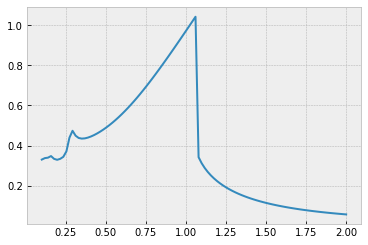

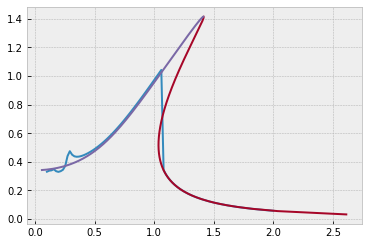

In [47]:
plt.plot(omegas, AmpND3)
plt.show()
plt.plot(omegas, AmpND3)
plt.plot(o1, a1)
plt.plot(o2, a2)

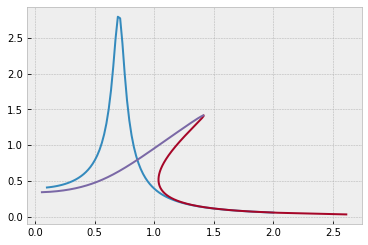

In [48]:
cAmp2 = coorAmp(omegas)
plt.plot(omegas, cAmp2)
plt.plot(o1, a1)
plt.plot(o2, a2)

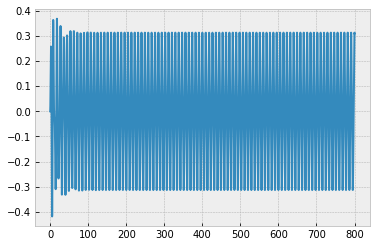

zeit 400.0400040004001
0.31369807108157066
back, best: 1.37


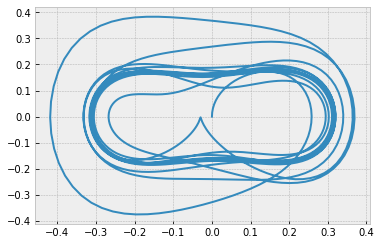

In [49]:
D_3 =10
#gamma = c/(2*m)
#omega = sy.sqrt(D/m)
Omega = sy.sqrt(D/m)
#Omega=2.2
y0 = [0., 0.]
co1, ts1, ges1 = coordForcedOsz(y0, 0, 800, 10000, D3=True)
plt.plot(ts1, co1)
plt.show()
plt.plot(co1, ges1)
print('zeit', ts1[5000])
print(abs(max(co1[5000:])))
if 0.4967985022109347 < abs(max(co1[5000:])):
    print('change, best:'+str(Omega))
if 0.4967985022109347 > abs(max(co1[5000:])):
    print('back, best: 1.37')

FloatProgress(value=0.0)

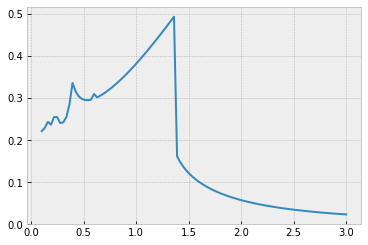

In [50]:
omegas = np.linspace(0.1, 3, 100)
AmpND3 = []
f = FloatProgress(min=0, max=100)
display(f)
time = 800
steps = 150000
for o in omegas:
    Omega = o
    co, ts, ges = coordForcedOsz(y0, 0, time, steps, D3=True)
    #print('finish coordForced')
    cAmpND3, err = eingeschwungen(co, ts)
    #print('Omega', Omega)
    #if round(o) == 1 or round(o) == 2:
    #plt.plot(ts, co)
    #plt.show()
    #plt.plot(ts[4000:8000], co[4000:8000])
    #print(max(co[2000:8000]))
    #plt.show()
    #plt.plot(ts[79000:], co[79000:])
    #print(max(co[60000:]))
    #plt.show()
    #print('max in egs', cAmpND3)
    #print('finish this plot')
    #plt.plot(ts, co)
    #plt.show()
    f.value += 1
    AmpND3.append(cAmpND3)
plt.plot(omegas, AmpND3)

max A 0.697882826261898
0.834795080401111 2.38936840987459
2.50680677080397 0.0345988425553235


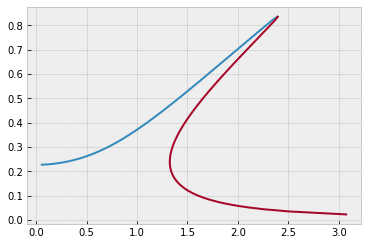

In [51]:
maxA = sy.sqrt((2/(3*D_3)*(omega**2-gamma**2))**2+((F0/m)**2)/(3*D_3*gamma**2))-(2/(3*D_3))*(omega**2-gamma**2)
print('max A',(maxA))
As = np.linspace(0.0005, (float(maxA))-0.001, 1000)
a11 = []
a21 = []
o11 = []
o21 = []
for A_i in As:
    R = (F0/m)**2-4*gamma**2*(omega**2+(3/4)*D_3*(A_i))*A_i+4*gamma**4*(A_i)
    om = omega**2+(3/4)*D_3*A_i-2*gamma**2+(1/sy.sqrt(A_i))*(sy.sqrt(R))
    om2 = omega**2+(3/4)*D_3*A_i-2*gamma**2-(1/sy.sqrt(A_i))*(sy.sqrt(R))
    if complex(om2).real > 0:
        
        a21.append(sy.sqrt(A_i))
        o21.append(sy.sqrt(om2))
    a11.append(sy.sqrt(A_i))
    o11.append(sy.sqrt(om))
plt.plot(o21, a21)
plt.plot(o11, a11)
print(a21[-1], o21[-1])
print(o11[1], a11[1])

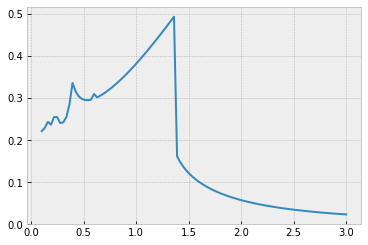

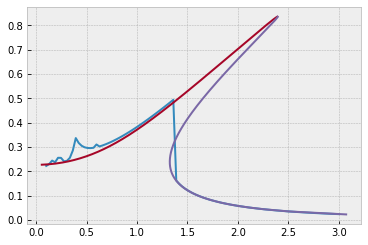

In [52]:
plt.plot(omegas, AmpND3)
plt.show()
plt.plot(omegas, AmpND3)
plt.plot(o21, a21)
plt.plot(o11, a11)

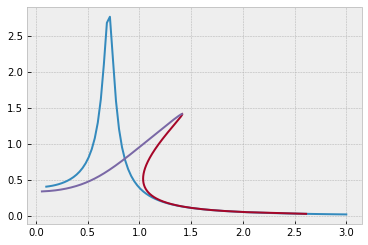

In [53]:
cAmp2 = coorAmp(omegas)
plt.plot(omegas, cAmp2)
plt.plot(o1, a1)
plt.plot(o2, a2)

In [54]:
D_3 = 100
gamma = c/(2*m)
omega = sy.sqrt(D/m)
Omega = sy.sqrt(D/m)
#Omega = 17.5
y0 = [0., 0.]
co2, ts2, ges2 = coordForcedOsz(y0, 0, 150, 2000, D3=True)

max A 0.227647256081262


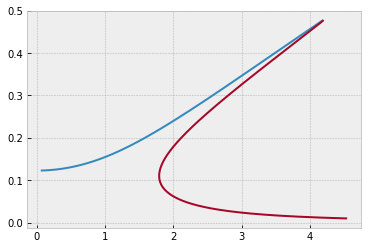

In [55]:
maxA = sy.sqrt((2/(3*D_3)*(omega**2-gamma**2))**2+((F0/m)**2)/(3*D_3*gamma**2))-(2/(3*D_3))*(omega**2-gamma**2)
print('max A', maxA)
As = np.linspace(0.01, np.sqrt(float(maxA))-0.001, 1000)
a12 = []
a22 = []
o12 = []
o22 = []
for A_i in As:
    R = (F0/m)**2-4*gamma**2*(omega**2+(3/4)*D_3*(A_i)**2)*A_i**2+4*gamma**4*A_i**2
    om = omega**2+(3/4)*D_3*A_i**2-2*gamma**2+(1/A_i)*(sy.sqrt(R))
    om2 = omega**2+(3/4)*D_3*A_i**2-2*gamma**2-(1/A_i)*(sy.sqrt(R))
    if complex(om2).real > 0:
        
        a22.append(A_i)
        o22.append(sy.sqrt(om2))
    a12.append(A_i)
    o12.append(sy.sqrt(om))
plt.plot(o22, a22)
plt.plot(o12, a12)

FloatProgress(value=0.0)

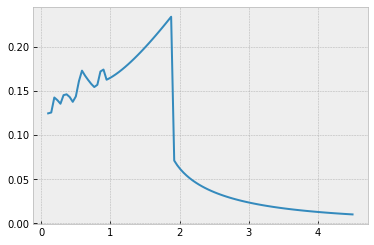

In [56]:
omegas = np.linspace(0.1, 4.5, 100)
AmpND3 = []
f = FloatProgress(min=0, max=100)
display(f)
time = 800
steps = 150000
for o in omegas:
    Omega = o
    co, ts, ges = coordForcedOsz(y0, 0, time, steps, D3=True)
    #print('finish coordForced')
    cAmpND3, err = eingeschwungen(co, ts)
    #print('Omega', Omega)
    #if round(o) == 1 or round(o) == 2:
    #plt.plot(ts, co)
    #plt.show()
    #plt.plot(ts[4000:8000], co[4000:8000])
    #print(max(co[2000:8000]))
    #plt.show()
    #plt.plot(ts[79000:], co[79000:])
    #print(max(co[60000:]))
    #plt.show()
    #print('max in egs', cAmpND3)
    #print('finish this plot')
    #plt.plot(ts, co)
    #plt.show()
    f.value += 1
    AmpND3.append(cAmpND3)
plt.plot(omegas, AmpND3)

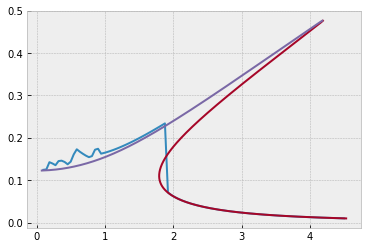

In [57]:
plt.plot(omegas, AmpND3)
plt.plot(o12, a12)
plt.plot(o22, a22)

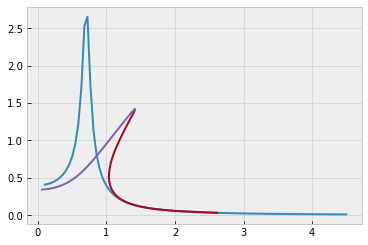

In [58]:
cAmp2 = coorAmp(omegas)
plt.plot(omegas, cAmp2)
plt.plot(o1, a1)
plt.plot(o2, a2)

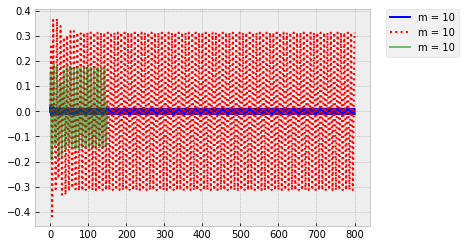

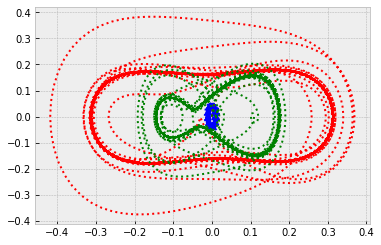

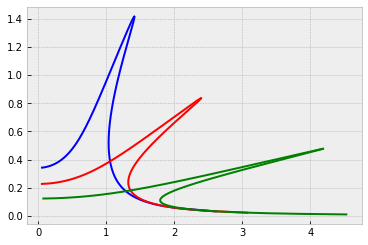

In [59]:
plt.plot(ts, co, label='m = '+str(m), color='b')
plt.plot(ts1, co1, ':', label='m = '+str(m), color='r')
plt.plot(ts2, co2, label='m = '+str(m), alpha=0.5, color='g')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.show()


plt.plot(co, ges, ':b')
plt.plot(co1, ges1, ':r')
plt.plot(co2, ges2, ':g')
plt.show()

plt.plot(o1, a1, 'b')
plt.plot(o2, a2, 'b')
plt.plot(o11, a11, 'r')
plt.plot(o21, a21, 'r')
plt.plot(o12, a12, 'g')
plt.plot(o22, a22, 'g')


0.7500000000000001
0.227647256081262
A 0.01
0.0399994950000000
0.199998737496015
0.00199998737496015
om 20.5023737496015
om2 -19.4973737496015
A 0.010466590532586705
0.0399994459903285
0.199998614971025
0.00209330360998619
om 19.6115031338227
om2 -18.6050707062161
A 0.01093318106517341
0.0399993945997570
0.199998486493666
0.00218661966559589
om 18.7967643431777
om2 -17.7888341759471
A 0.011399771597760115
0.0399993408087213
0.199998352015014
0.00227993553289958
om 18.0488131988325
om2 -17.0393199799604
A 0.011866362130346822
0.0399992845968044
0.199998211484014
0.00237325120289100
om 17.3597751905163
om2 -16.3486536079850
A 0.012332952662933527
0.0399992259427359
0.199998064847478
0.00246656666644225
om 16.7229674678981
om2 -15.7101522096902
A 0.012799543195520232
0.0399991648243922
0.199997912050082
0.00255988191429888
om 16.1326816385991
om2 -15.1181073926970
A 0.013266133728106937
0.0399991012187968
0.199997753034370
0.00265319693707486
om 15.5840124021918
om2 -14.5676138565780
A 0.

om 4.45367571664728
om2 -3.03605513824769
A 0.0538595100631503
0.0399792571028261
0.199948136032387
0.0107691086447445
om 4.42496519905872
om2 -2.99983817542234
A 0.054326100595737004
0.0399787844167471
0.199946954007174
0.0108623383372049
om 4.39684461860580
om2 -2.96414583771508
A 0.05479269112832371
0.0399783037817049
0.199945752097175
0.0109555658370809
om 4.36929973408306
om2 -2.92896388392047
A 0.05525928166091042
0.0399778150979411
0.199944530052565
0.0110487911027331
om 4.34231678523773
om2 -2.89427855378576
A 0.05572587219349712
0.0399773182648442
0.199943287621376
0.0111420140919364
om 4.31588247263479
om2 -2.86007654787589
A 0.056192462726083824
0.0399768131809492
0.199942024549491
0.0112352347618750
om 4.28998393852506
om2 -2.82634500844171
A 0.05665905325867053
0.0399762997439385
0.199940740580649
0.0113284530691370
om 4.26460874865867
om2 -2.79307150123334
A 0.05712564379125724
0.0399757778506409
0.199939435456442
0.0114216689697098
om 4.23974487498977
om2 -2.760243998204

A 0.09398629586560694
0.0398975316843802
0.199743664941795
0.0187731671905002
om 3.28274922780986
om2 -0.967735656229253
A 0.09445288639819364
0.0398959234607057
0.199739639182376
0.0188659854489091
om 3.27880235499274
om2 -0.950600192650227
A 0.09491947693078036
0.0398942955906416
0.199735564160821
0.0189587952746195
om 3.27499125249504
om2 -0.933535187373098
A 0.09538606746336706
0.0398926479010601
0.199731439440715
0.0190515965570475
om 3.27131440255947
om2 -0.916539122640569
A 0.09585265799595377
0.0398909802179802
0.199727264583432
0.0191443891845831
om 3.26777031695818
om2 -0.899610510224786
A 0.09631924852854047
0.0398892923665677
0.199723039148136
0.0192371730445847
om 3.26435753627751
om2 -0.882747890712099
A 0.09678583906112717
0.0398875841711356
0.199718762691780
0.0193299480233741
om 3.26107462922346
om2 -0.865949832808499
A 0.09725242959371388
0.0398858554551433
0.199714434769106
0.0194227140062308
om 3.25792019194709
om2 -0.849214932665048
A 0.09771902012630058
0.03988410

A 0.12898058580960986
0.0397096687819239
0.199272850087321
0.0257023289402132
om 3.28768265583235
om2 0.197716071536165
A 0.12944717634219655
0.0397060490415766
0.199263767508237
0.0257941320512492
om 3.29108711688489
om2 0.212398602560274
A 0.12991376687478326
0.0397023943028116
0.199254596691799
0.0258859152233474
om 3.29456406038988
om2 0.227073963149453
A 0.13038035740736997
0.0396987043285162
0.199245337030798
0.0259776782538273
om 3.29811305411093
om2 0.241742585540100
A 0.13084694793995666
0.0396949788807246
0.199235987915649
0.0260694209385648
om 3.30173367195881
om2 0.256404895821447
A 0.13131353847254337
0.0396912177206177
0.199226548734394
0.0261611430719858
om 3.30542549388222
om2 0.271061314044804
A 0.1317801290051301
0.0396874206085235
0.199217018872694
0.0262528444470611
om 3.30918810576084
om2 0.285712254330472
A 0.13224671953771677
0.0396835873039167
0.199207397713832
0.0263445248552995
om 3.31302109930073
om2 0.300358124972395
A 0.1327133100703035
0.0396797175654189
0

A 0.17284009587276014
0.0391820499413973
0.197944562798268
0.0342127572115442
om 3.88077418296594
om2 1.59028062822979
A 0.17330668640534685
0.0391739895728699
0.197924201584521
0.0343015875360372
om 3.88968652954311
om2 1.60559460337708
A 0.17377327693793357
0.0391658681882895
0.197903684120052
0.0343903717076312
om 3.89864782167950
om2 1.62092494498267
A 0.17423986747052025
0.0391576854703488
0.197883009554506
0.0344791093594448
om 3.90765792363116
om2 1.63627178879051
A 0.17470645800310697
0.0391494411008877
0.197862177034641
0.0345678001225058
om 3.91671670108778
om2 1.65163526911092
A 0.17517304853569368
0.0391411347608927
0.197841185704324
0.0346564436257427
om 3.92582402115352
om2 1.66701551883975
A 0.1756396390682804
0.0391327661304974
0.197820034704520
0.0347450394959765
om 3.93497975232819
om2 1.68241266947718
A 0.17610622960086708
0.0391243348889821
0.197798723173286
0.0348335873579130
om 3.94418376448870
om2 1.69782685114630
A 0.1765728201334538
0.0391158407147740
0.1977772

A 0.21576642487073702
0.0381428516275152
0.195301949881498
0.0421396034962147
om 4.89179075511364
om2 3.08148176011127
A 0.21623301540332374
0.0381277423981858
0.195263264333530
0.0422223644443354
om 4.90477620737537
om2 3.09873133518674
A 0.21669960593591045
0.0381125393893380
0.195224330935819
0.0423050355828936
om 4.91780235326820
om2 3.11600552864863
A 0.21716619646849716
0.0380972422051763
0.195185148526153
0.0423876163125633
om 4.93086913563293
om2 3.13330439765616
A 0.21763278700108385
0.0380818504490525
0.195145715938251
0.0424701060309634
om 4.94397649778182
om2 3.15062799889705
A 0.21809937753367056
0.0380663637234650
0.195106032001743
0.0425525041326445
om 4.95712438349351
om2 3.16797638859268
A 0.21856596806625728
0.0380507816300591
0.195066095542150
0.0426348100090750
om 4.97031273700791
om2 3.18534962250312
A 0.21903255859884396
0.0380351037696271
0.195025905380868
0.0427170230486275
om 4.98354150302122
om2 3.20274775593218
A 0.21949914913143068
0.0380193297421081
0.19498

A 0.25356025801026016
0.0365799697706148
0.191258907689589
0.0484956579805328
om 6.07125404303500
om2 4.56266662329945
A 0.25402684854284685
0.0365559092344300
0.191195996910056
0.0485689165490693
om 6.08738357043570
om2 4.58206239665587
A 0.25449343907543354
0.0365317200951632
0.191132729000460
0.0486420255231998
om 6.10355033891181
om2 4.60148624095440
A 0.2549600296080203
0.0365074018879155
0.191069102389464
0.0487149840023956
om 6.11975431712750
om2 4.62093818753089
A 0.25542662014060696
0.0364829541469348
0.191005115499389
0.0487877910815751
om 6.13599547395106
om2 4.64041826751702
A 0.25589321067319365
0.0364583764056160
0.190940766746172
0.0488604458510793
om 6.15227377845295
om2 4.65992651184238
A 0.2563598012057804
0.0364336681965006
0.190876054539328
0.0489329473966459
om 6.16858919990369
om2 4.67946295123640
A 0.2568263917383671
0.0364088290512773
0.190810977281909
0.0490052947993843
om 6.18494170777198
om2 4.69902761623040
A 0.2572929822709538
0.0363838585007813
0.190745533

0.0536262668486216
om 7.42014346171329
om2 6.14032832621131
A 0.28995431955202317
0.0342804683122585
0.185149853665236
0.0536849998346603
om 7.43906141163690
om2 6.16196470239462
A 0.2904209100846099
0.0342449157412853
0.185053818499607
0.0537434983832879
om 7.45801466246035
om2 6.18363108969561
A 0.2908875006171966
0.0342091957431573
0.184957280860088
0.0538017611503437
om 7.47700319384640
om2 6.20532750845153
A 0.2913540911497833
0.0341733077864312
0.184860238522055
0.0538597867843256
om 7.49602698555027
om2 6.22705397890716
A 0.29182068168237
0.0341372513388107
0.184762689249780
0.0539175739263386
om 7.51508601741860
om2 6.24881052121587
A 0.2922872722149567
0.0341010258671463
0.184664630796334
0.0539751212100425
om 7.53418026938839
om2 6.27059715544064
A 0.2927538627475434
0.0340646308374352
0.184566060903502
0.0540324272615986
om 7.55330972148601
om2 6.29241390155511
A 0.29322045328013013
0.0340280657148219
0.184466977301689
0.0540894906996167
om 7.57247435382616
om2 6.31426077944

A 0.32448201896343937
0.0311619254029597
0.176527406945663
0.0572799694081094
om 8.93567186513318
om2 7.84761522945530
A 0.32494860949602605
0.0311124924909257
0.176387336537875
0.0573168197406902
om 8.95718600986894
om2 7.87155381214118
A 0.3254152000286128
0.0310628505206281
0.176246561727110
0.0573533101387829
om 8.97873412222036
om2 7.89552373922895
A 0.3258817905611995
0.0310129988974920
0.176105079135986
0.0573894385157569
om 9.00031618618981
om2 7.91952502671621
A 0.32634838109378617
0.0309629370260891
0.175962885365321
0.0574252027715640
om 9.02193218580437
om2 7.94355769057589
A 0.3268149716263729
0.0309126643101383
0.175819976993908
0.0574606007926135
om 9.04358210511493
om2 7.96762174675710
A 0.3272815621589596
0.0308621801525050
0.175676350578287
0.0574956304516467
om 9.06526592819536
om2 7.99171721118599
A 0.3277481526915463
0.0308114839552019
0.175532002652513
0.0575302896076088
om 9.08698363914158
om2 8.01584409976659
A 0.328214743224133
0.0307605751193883
0.175386929727

A 0.35807653730968214
0.0270320646683041
0.164414307979276
0.0588729060853866
om 10.5705701720186
om2 9.65225081373524
A 0.3585431278422688
0.0269660089468087
0.164213303196814
0.0588775513614965
om 10.5944896250035
om2 9.67848655343410
A 0.35900971837485557
0.0268996991770447
0.164011277591039
0.0588816425782590
om 10.6184419009402
om2 9.70475478219879
A 0.35947630890744225
0.0268331347030116
0.163808225382645
0.0588851762292318
om 10.6424269831014
om2 9.73105551675638
A 0.35994289944002894
0.0267663148678556
0.163604140741778
0.0588881487789903
om 10.6664448547066
om2 9.75738877388764
A 0.3604094899726157
0.0266992390138702
0.163399017787348
0.0588905566627646
om 10.6904954989195
om2 9.78375457042863
A 0.36087608050520237
0.0266319064824953
0.163192850586339
0.0588923962860693
om 10.7145788988474
om2 9.81015292327218
A 0.3613426710377891
0.0265643166143180
0.162985633153103
0.0588936640243276
om 10.7386950375390
om2 9.83658384936959
A 0.3618092615703758
0.0264964687490720
0.162777359

A 0.3916710556559249
0.0215867037827574
0.146924142953966
0.0575459341721218
om 12.3755874556861
om2 11.6253449201078
A 0.39213764618851166
0.0215006289678617
0.146630927733073
0.0574995068596851
om 12.4018222058514
om2 11.6539678278885
A 0.39260423672109834
0.0214142506920565
0.146336088139790
0.0574521681888737
om 12.4280883128020
om2 11.6826246909015
A 0.39307082725368503
0.0213275682379156
0.146039611879502
0.0574039110532830
om 12.4543857498860
om2 11.7113155357984
A 0.39353741778627177
0.0212405808871600
0.145741486499761
0.0573547282614487
om 12.4807144901774
om2 11.7400403895056
A 0.39400400831885846
0.0211532879206574
0.145441699387271
0.0573046125352914
om 12.5070745064689
om2 11.7687992792302
A 0.39447059885144514
0.0210656886184224
0.145140237764799
0.0572535565085215
om 12.5334657712666
om2 11.7975922324660
A 0.3949371893840319
0.0209777822596166
0.144837088688003
0.0572015527250058
om 12.5598882567836
om2 11.8264192770002
A 0.39540377991661857
0.0208895681225481
0.1445322

om2 14.0253119696103
A 0.42946488879544803
0.0135688002534219
0.116485193279755
0.0500263005782063
om 14.5992401363051
om2 14.0567734699079
A 0.42993147932803477
0.0134557478554064
0.115998913164764
0.0498715843373711
om 14.6278886771242
om2 14.0882728604547
A 0.43039806986062146
0.0133423311208282
0.115509008829737
0.0497148544518322
om 14.6565645439083
om2 14.1198102370540
A 0.43086466039320814
0.0132285492631577
0.115015430543722
0.0495560844211994
om 14.6852676385521
om2 14.1513856978111
A 0.4313312509257949
0.0131144014950120
0.114518127364239
0.0493952471296966
om 14.7139978605660
om2 14.1829993432156
A 0.43179784145838157
0.0129998870281552
0.114017047094525
0.0492323148248746
om 14.7427551069900
om2 14.2146512762277
A 0.4322644319909683
0.0128850050734981
0.113512136238810
0.0490672590953506
om 14.7715392723033
om2 14.2463416023679
A 0.432731022523555
0.0127697548410987
0.113003339955502
0.0489000508475212
om 14.8003502483304
om2 14.2780704298118
A 0.4331976130561417
0.01265413

A 0.4705248556630781
0.00213720883516782
0.0462299560368364
0.0217523433915429
om 17.1977748740684
om2 17.0012710954457
A 0.4709914461956648
0.00198899036473028
0.0445980982187613
0.0210053227776307
om 17.2271605054894
om2 17.0377808529331
A 0.47145803672825154
0.00184033507732906
0.0428991267665096
0.0202251380826950
om 17.2564434901364
om2 17.0744585692123
A 0.4719246272608382
0.00169124211135891
0.0411247141188716
0.0194077653817570
om 17.2856065833735
om2 17.1113214889186
A 0.4723912177934249
0.00154171060436135
0.0392646228093605
0.0185482629851133
om 17.3146285656385
om2 17.1483908316147
A 0.47285780832601165
0.00139173969302485
0.0373060275696147
0.0176404464339178
om 17.3434828284371
om2 17.1856932057948
A 0.47332439885859834
0.00124132851318474
0.0352324922931197
0.0166763982349311
om 17.3721352395194
om2 17.2232627437086
A 0.4737909893911851
0.00109047619982314
0.0330223590893071
0.0156456961849538
om 17.4005407798079
om2 17.2611444644338
A 0.47425757992377177
0.0009391818870

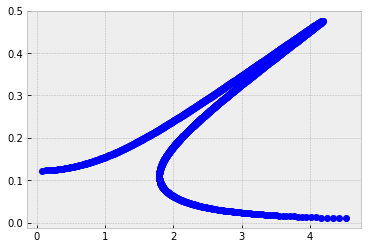

In [60]:
print(3*D_3*gamma**2)
maxA = sy.sqrt((2/(3*D_3)*(omega**2-gamma**2))**2+((F0/m)**2)/(3*D_3*gamma**2))-(2/(3*D_3))*(omega**2-gamma**2)
print(maxA)
As = np.linspace(0.01, np.sqrt(float(maxA))-0.001, 1000)
a1 = []
a2 = []
o1 = []
o2 = []
for A_i in As:
    print('A', A_i)
    #print('r 0', (F0/m)**2)
    #print('r 1', -4*gamma**2*(omega**2+(3/4)*d*(A_i)**2)*A_i**2)
    #print('r 2', 4*gamma**4*A_i**2)
    R = (F0/m)**2-4*gamma**2*(omega**2+(3/4)*D_3*(A_i)**2)*A_i**2+4*gamma**4*A_i**2
    print(R)
    print(sy.sqrt(R))
    print(A_i*sy.sqrt(R))
    om = omega**2+(3/4)*D_3*A_i**2-2*gamma**2+(1/A_i)*(sy.sqrt(R))
    print('om', om)
    om2 = omega**2+(3/4)*D_3*A_i**2-2*gamma**2-(1/A_i)*(sy.sqrt(R))
    print('om2', om2)
    #o1 = om_2[0].subs(A, A_i)
    #o2 = om_2[1].subs(A, A_i)
    #print('o1', o1)
    #print('o2', o2)
    #plt.plot(A_i, complex(om).real, 'ob')
    #if complex(om2).real > 0:
    #    plt.plot(A_i, complex(om2).real, 'or', alpha=0.5)
    #if np.sqrt(complex(o1).real) <= 50:
    #    plt.plot(np.sqrt(complex(o1).real), np.sqrt(A_i), 'ob')
    #if complex(o2).real > 0 and np.sqrt(complex(o2).real) <= 50:
    #    plt.plot(np.sqrt(complex(o2).real), np.sqrt(A_i), 'ob')
    plt.plot(sy.sqrt((om)), A_i, 'ob')
    if complex(om2).real > 0:
        plt.plot(sy.sqrt((om2)), A_i, 'ob')
        
        a2.append(A_i)
        o2.append(sy.sqrt(om2))
    a1.append(A_i)
    o1.append(sy.sqrt(om))
plt.show()

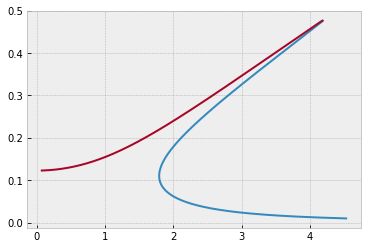

In [61]:
plt.plot(o1, a1)
plt.plot(o2, a2)

In [62]:
F0 = 100       # Kraftamplitude
m = 10       # Masse
c = 1         # Reibungskoeffizient
D = 2        # Federkonstante
Om = np.pi**2 # äußere Kreisfrequenz
D_3 = 0.00001
gamma = c/(2*m)
omega = np.sqrt(D/m)
Omega = np.sqrt(D/m)
#Omega = 0.001

In [63]:
y0 = [0., 0.]

In [64]:
#plt.plot(ts, co, alpha = 0.5)
#xs, ts_a = analyticalForcedOsz(y0, 0, 500, 10000)
#plt.plot(ts_a, xs, ':')
#plt.show()
#plt.plot(ts, abs(co))
#plt.show()

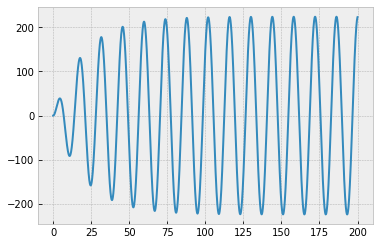

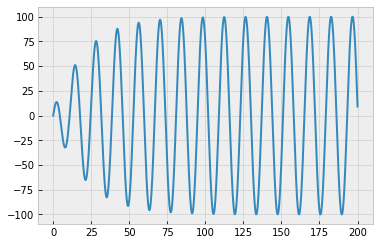

array([0.00000000e+00, 1.99904031e-03, 7.99051469e-03, ...,
       2.22233498e+02, 2.22445251e+02, 2.22639205e+02])

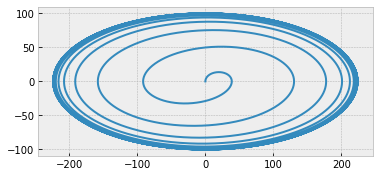

In [65]:
co, ts, ges = coordForcedOsz(y0, 0, 200, 10000)
plt.plot(ts, co)
plt.show()
plt.plot(ts, ges)
plt.show()
plt.plot(co, ges)
plt.axis('scaled')
co

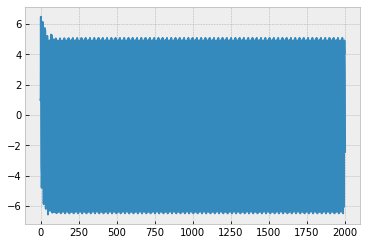

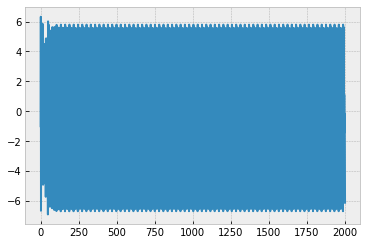

array([ 1.        ,  0.98195915,  0.96783386, ..., -2.19751904,
       -2.31766679, -2.4392618 ])

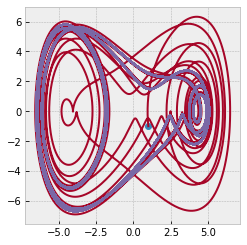

In [66]:
D_3 = 0.1
y0 =[1, -1]
co, ts, ges = coordForcedOsz(y0, 0, 2000, 100000, D3=True)
plt.plot(ts, co)
plt.show()
plt.plot(ts, ges)
plt.show()
plt.plot(co[0], ges[0], 'o')
plt.plot(co[0:10000], ges[:10000])
plt.plot(co[10000:], ges[10000:])
plt.axis('scaled')
co

FloatProgress(value=0.0)

calculate cAmp finished


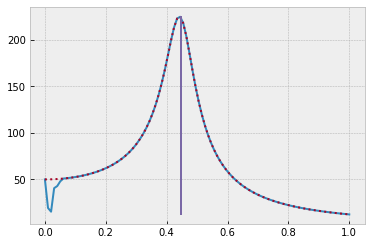

0.4472135954999579
0.2


In [67]:
AmpN = []
i = 0
omegasn = np.linspace(0, 1, 100)
from ipywidgets import FloatProgress
from IPython.display import display
f = FloatProgress(min=0, max=100)
display(f)
for o in omegasn:
    Omega = o
    time = 800
    steps = 100000
    co, ts, ges = coordForcedOsz(y0, 0, time, steps)
    cAmpN, err = eingeschwungen(co, ts)
    AmpN.append(cAmpN)
    i += 1
    #print('o=', o)
    f.value +=1
omegasn = np.linspace(0, 1, 100)
cAmp = coorAmp(omegasn)
print('calculate cAmp finished')
#AmpN = cooAmpN(omegas)
plt.plot(omegasn, AmpN)
plt.plot(omegasn, cAmp, ':')
l = [i for i in np.arange(min(cAmp), max(cAmp), max(cAmp)/1000)]
om0 = np.sqrt(D/m)
plt.plot([om0 for h in l], l)
plt.show()
#plt.show()
print(om0)
print(D/m)

FloatProgress(value=0.0)

Omega 0.0


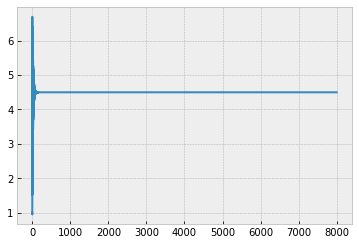

4.4989269605357425


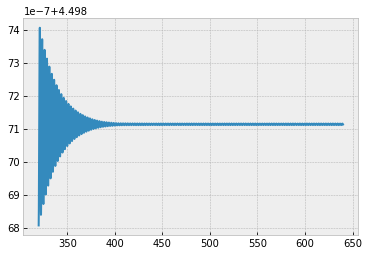

4.498007116288406


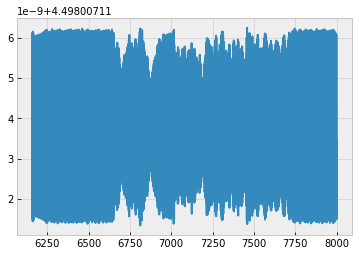

max in egs 4.498007113802884
finish this plot
Omega 0.010101010101010102


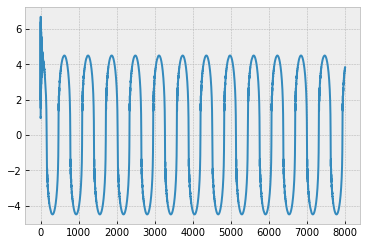

4.498162398195103


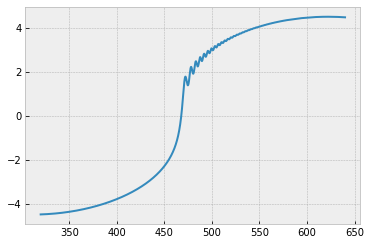

4.498162765569525


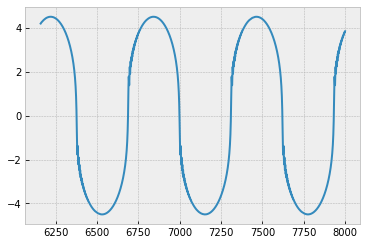

max in egs 4.498162416455321
finish this plot
Omega 0.020202020202020204


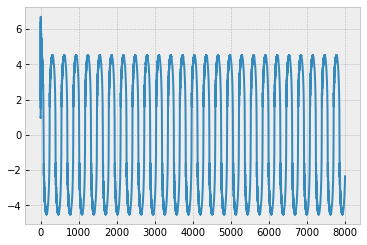

4.5088402690404505


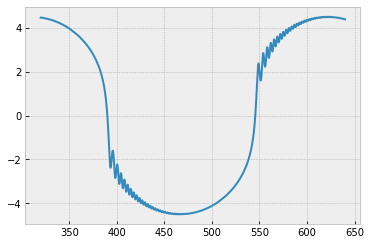

4.508845358494117


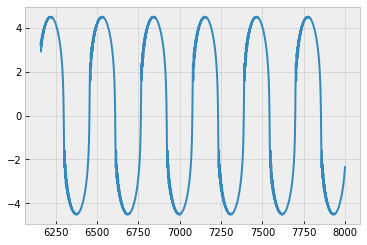

max in egs 4.508843154873599
finish this plot
Omega 0.030303030303030304


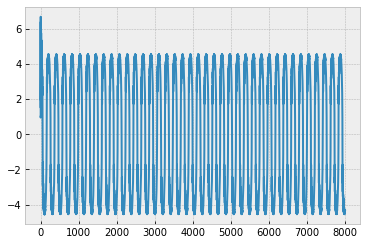

4.55025160795966


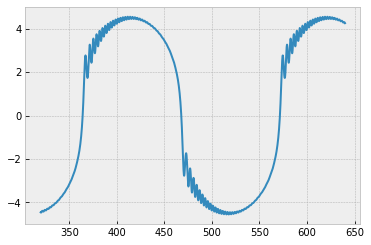

4.5502516517941975


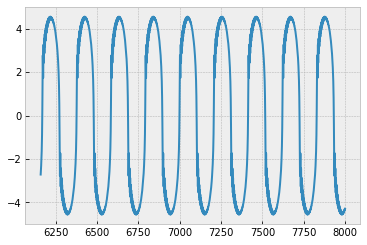

max in egs 4.55024592666898
finish this plot
Omega 0.04040404040404041


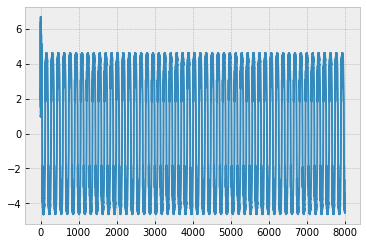

4.620142847550735


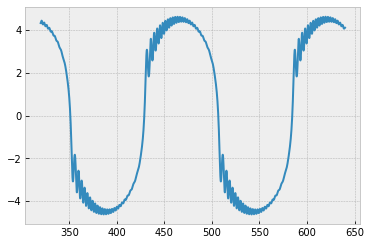

4.620259656016063


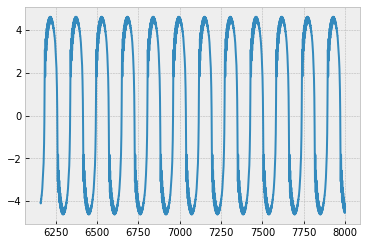

max in egs 4.620255020048356
finish this plot
Omega 0.05050505050505051


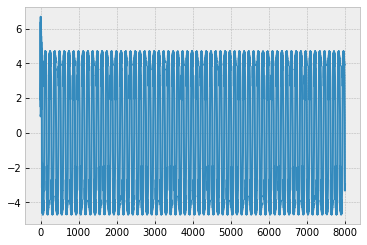

4.697696258757938


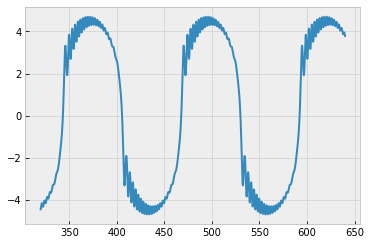

4.697737472746092


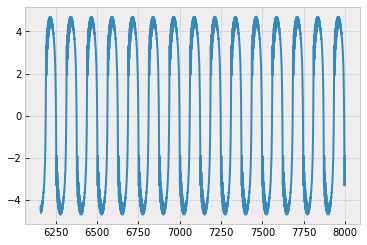

max in egs 4.6975235486437015
finish this plot
Omega 0.06060606060606061


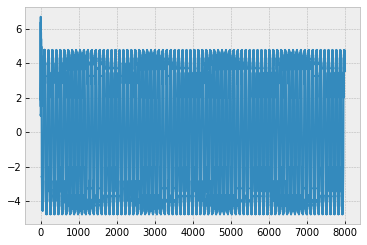

4.767606128748764


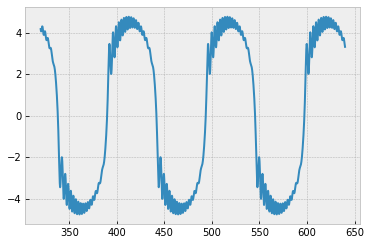

4.767610884369468


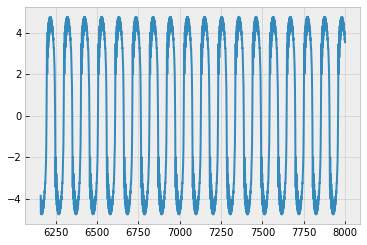

max in egs 4.767607586769826
finish this plot
Omega 0.07070707070707072


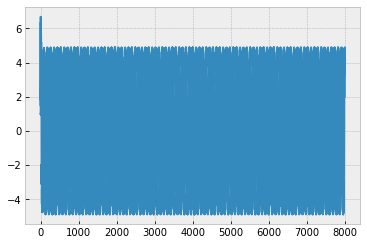

4.892527757193754


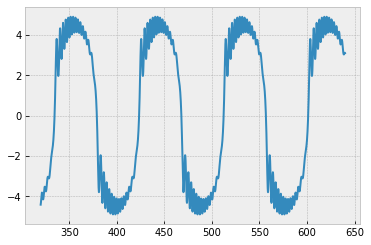

4.892224422610442


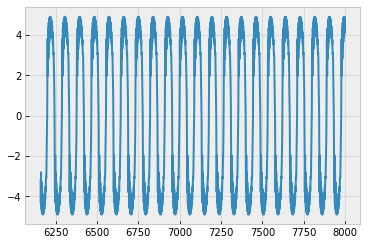

max in egs 4.892206351326643
finish this plot
Omega 0.08080808080808081


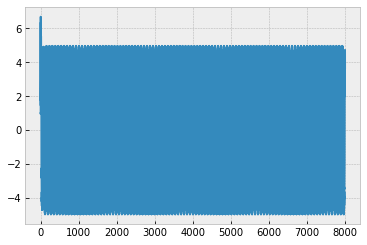

4.968272798789662


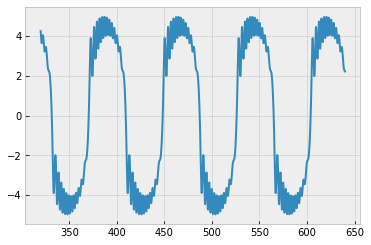

4.968279245305017


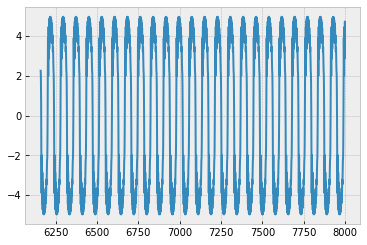

max in egs 4.968275193210049
finish this plot
Omega 0.09090909090909091


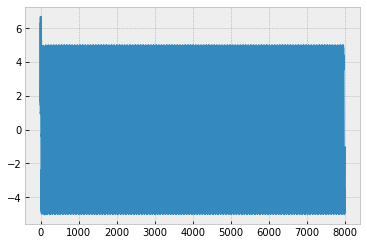

4.99884071342489


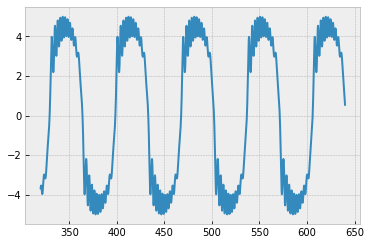

4.998973556335038


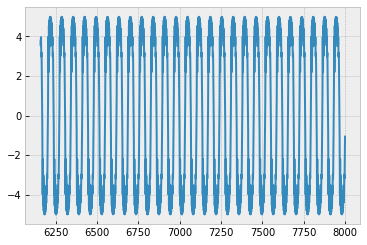

max in egs 4.998849749840911
finish this plot
Omega 0.10101010101010102


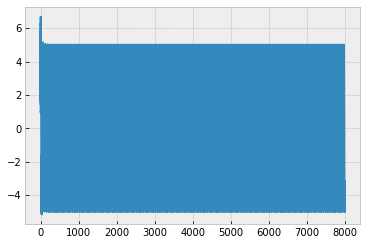

5.021256531985063


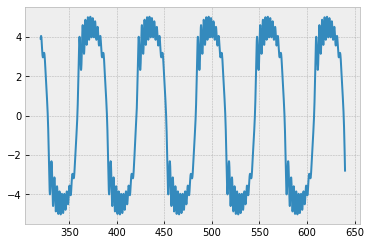

5.015943416809762


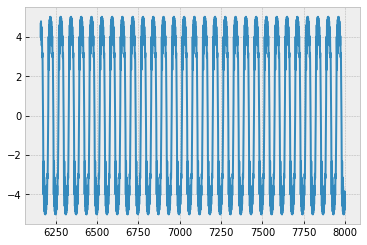

max in egs 5.015933585721639
finish this plot
Omega 0.11111111111111112


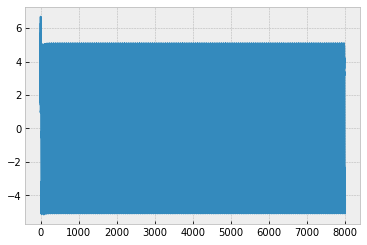

5.088190632818699


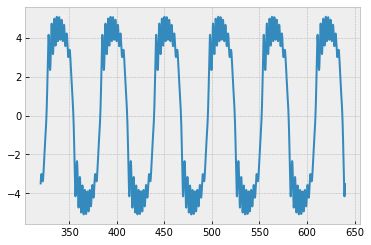

5.088268333750325


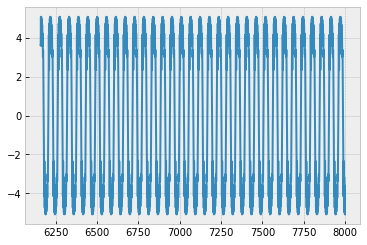

max in egs 5.0882600999593794
finish this plot
Omega 0.12121212121212122


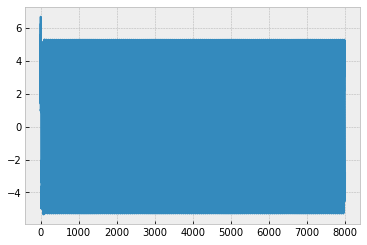

5.281368429934046


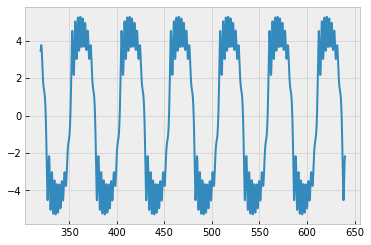

5.281412437382878


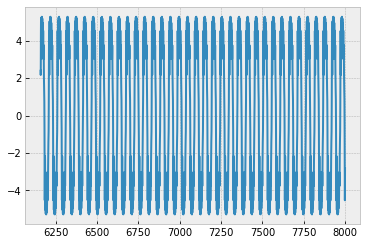

max in egs 5.281395223227508
finish this plot
Omega 0.13131313131313133


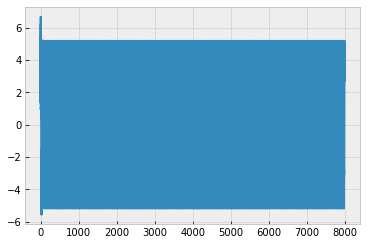

5.187074528744213


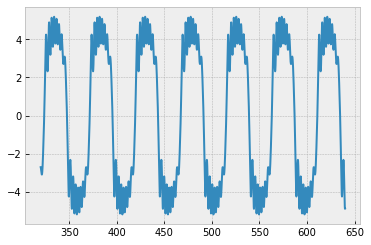

5.187090081144642


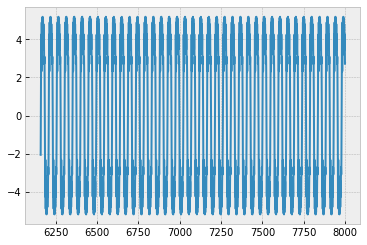

max in egs 5.1870890693740375
finish this plot
Omega 0.14141414141414144


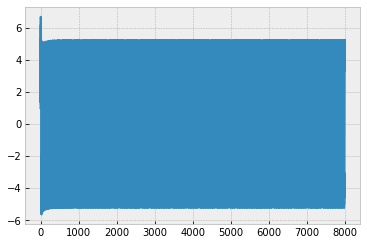

5.212118504232117


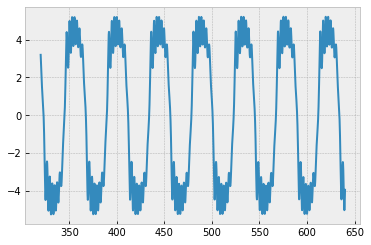

5.2181566073564065


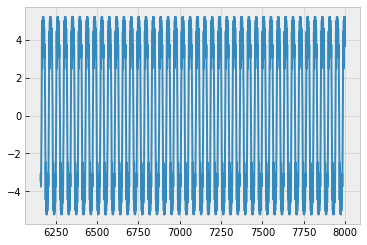

max in egs 5.21814852846372
finish this plot
Omega 0.15151515151515152


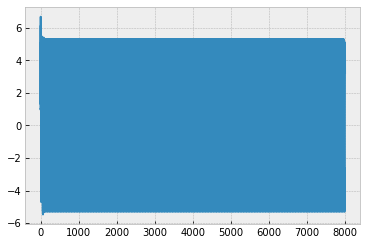

5.298121507244272


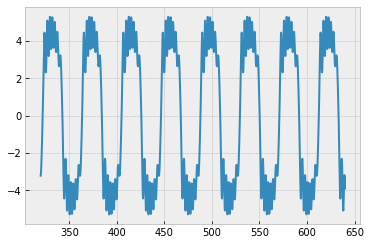

5.298126827899254


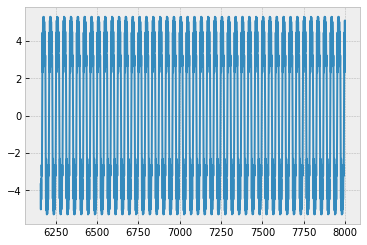

max in egs 5.2981196539566895
finish this plot
Omega 0.16161616161616163


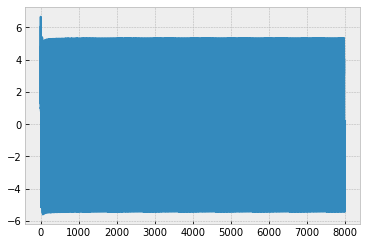

5.315725111074992


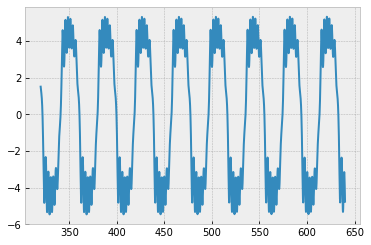

5.340904545048255


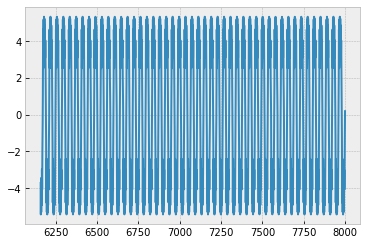

max in egs 5.384575901494358
finish this plot
Omega 0.17171717171717174


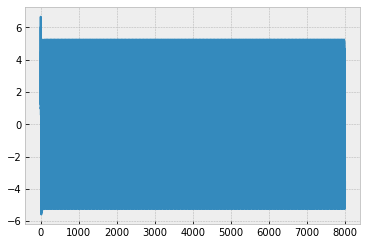

5.249319796680994


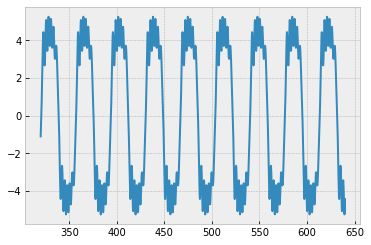

5.249320367280423


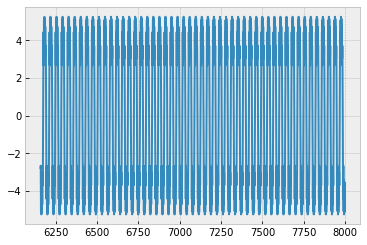

max in egs 5.249297467230378
finish this plot
Omega 0.18181818181818182


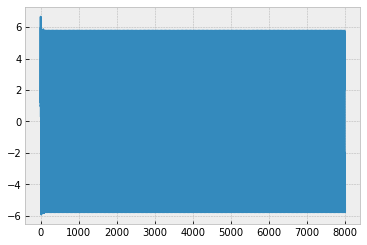

5.767382159406292


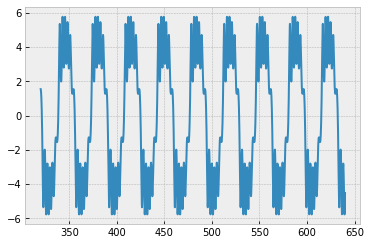

5.767662712054341


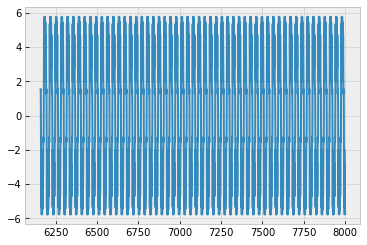

max in egs 5.76765884603956
finish this plot
Omega 0.19191919191919193


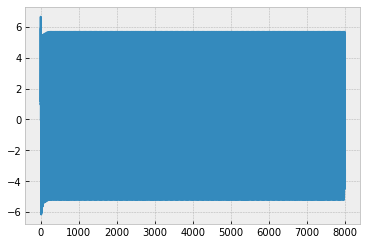

5.676976071124548


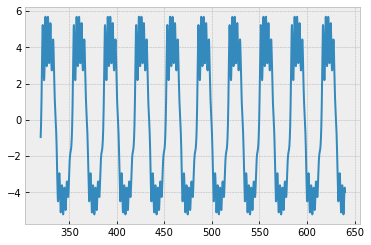

5.676987906329386


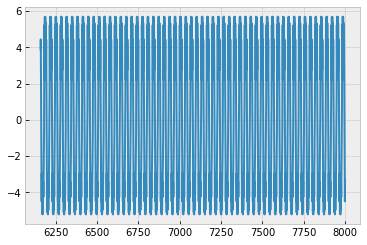

max in egs 5.443777455056786
finish this plot
Omega 0.20202020202020204


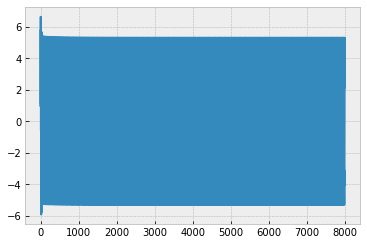

5.373443317121344


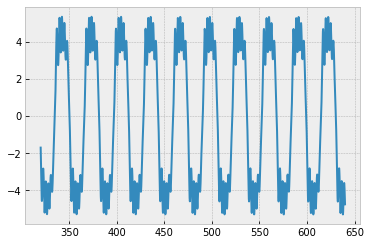

5.319276321793358


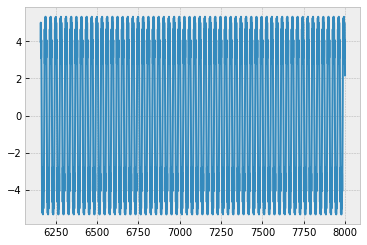

max in egs 5.319266678747643
finish this plot
Omega 0.21212121212121213


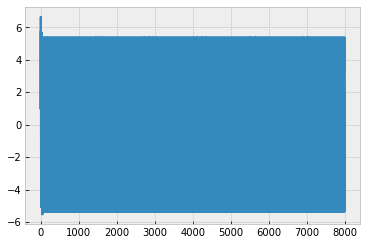

5.3785471045126245


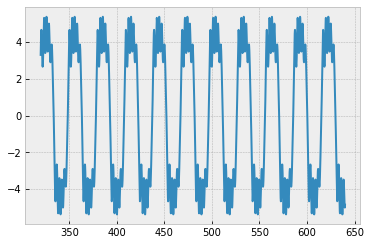

5.37866438934829


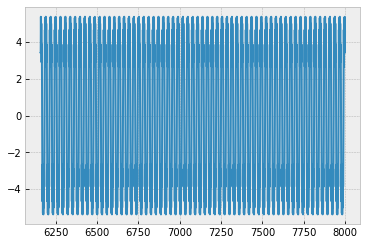

max in egs 5.378662333423488
finish this plot
Omega 0.22222222222222224


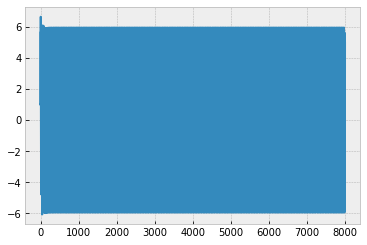

5.942468771618331


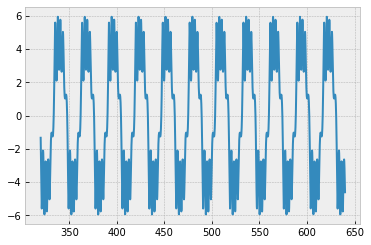

5.942676449080237


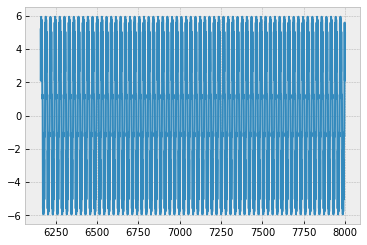

max in egs 5.942662602910763
finish this plot
Omega 0.23232323232323235


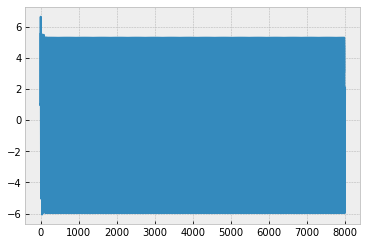

5.3064622011227245


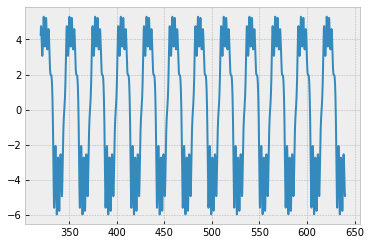

5.290936693248964


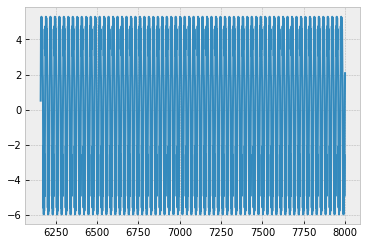

max in egs 5.628450269528168
finish this plot
Omega 0.24242424242424243


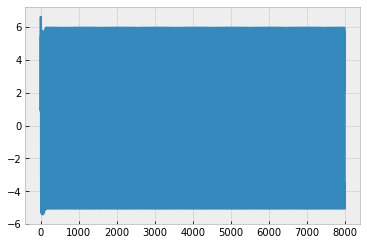

5.968808065396379


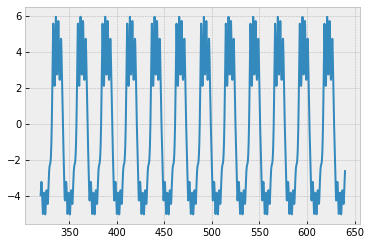

5.965863339255835


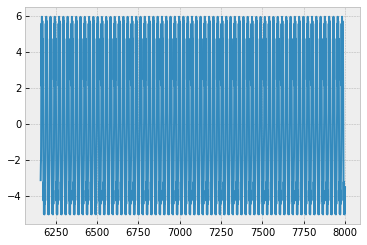

max in egs 5.508740747287117
finish this plot
Omega 0.25252525252525254


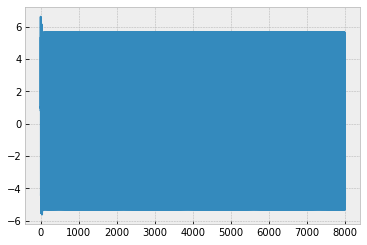

5.667833394116217


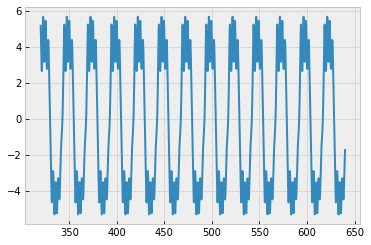

5.672665842479758


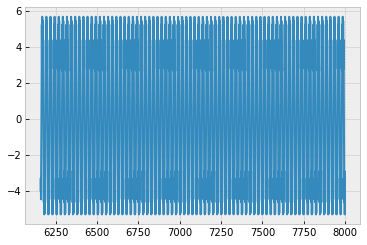

max in egs 5.501511101109193
finish this plot
Omega 0.26262626262626265


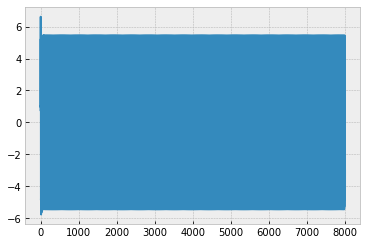

5.445416503480062


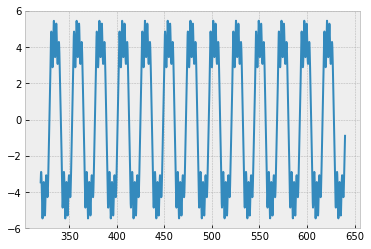

5.4454231919180565


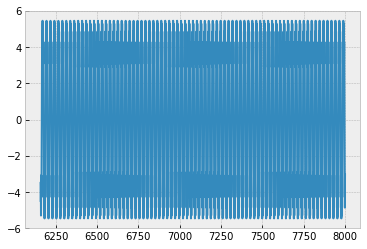

max in egs 5.445419269444701
finish this plot
Omega 0.27272727272727276


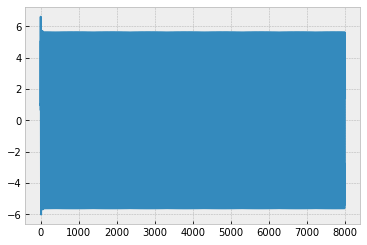

5.609368756011604


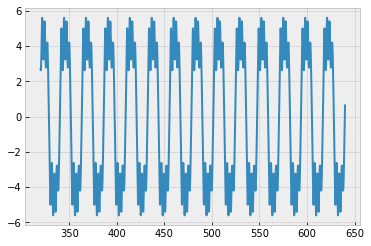

5.610946456413727


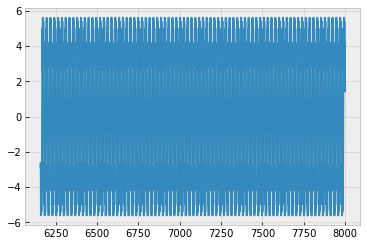

max in egs 5.610945302278704
finish this plot
Omega 0.2828282828282829


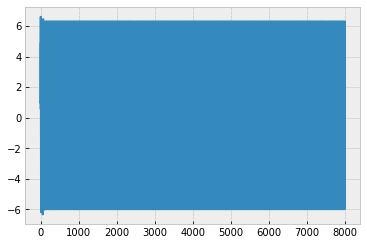

6.293013402633133


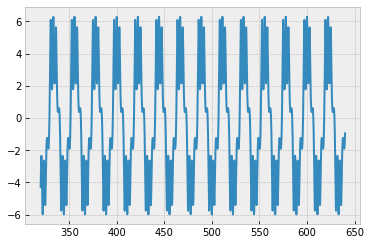

6.293048266951346


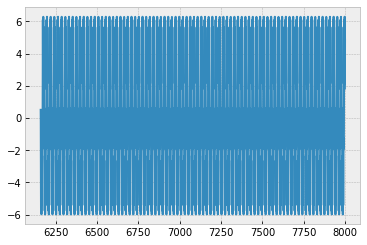

max in egs 6.143515213394242
finish this plot
Omega 0.29292929292929293


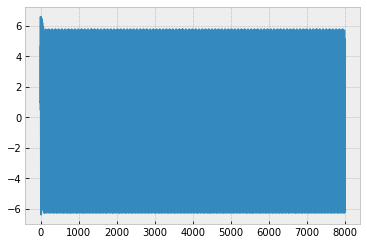

5.77624453889249


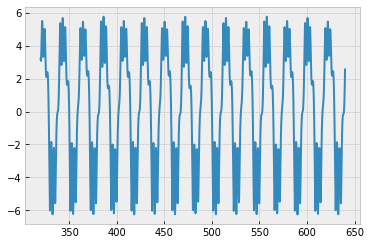

5.776183716751921


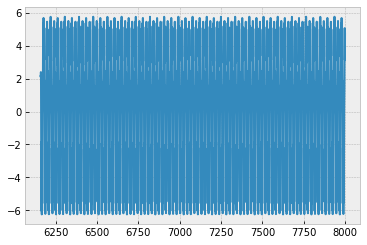

max in egs 6.01680642992073
finish this plot
Omega 0.30303030303030304


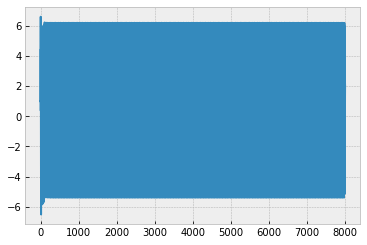

6.18949912910657


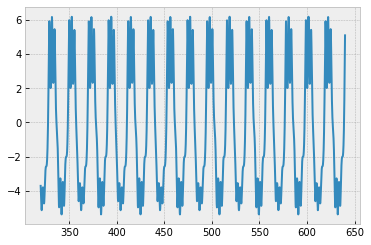

6.188936247986197


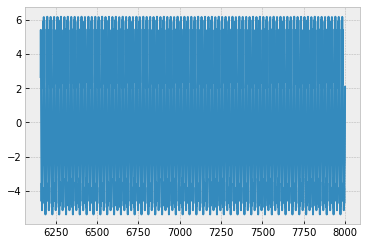

max in egs 5.7900316264572265
finish this plot
Omega 0.31313131313131315


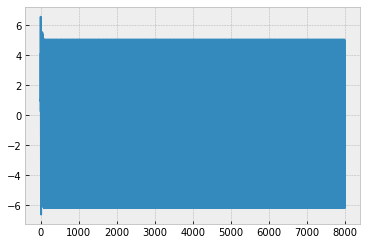

5.057241968250607


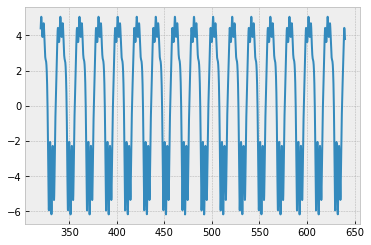

5.057158968185135


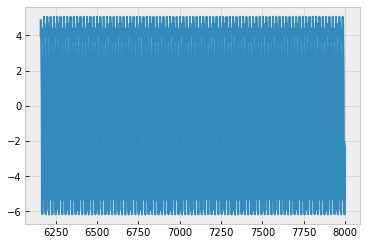

max in egs 5.612845181339173
finish this plot
Omega 0.32323232323232326


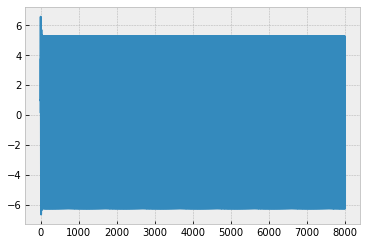

5.281401743614064


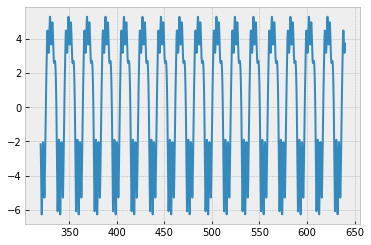

5.282370940627755


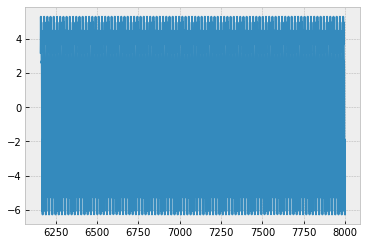

max in egs 5.769537643955558
finish this plot
Omega 0.33333333333333337


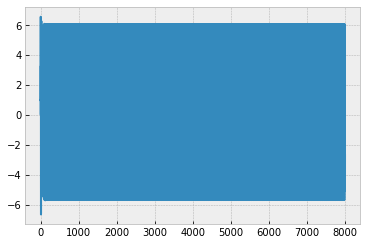

6.07200750612927


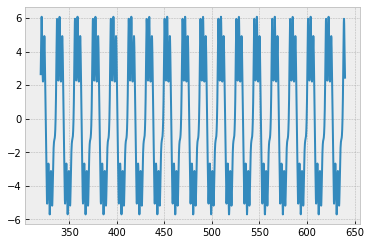

6.071972394584419


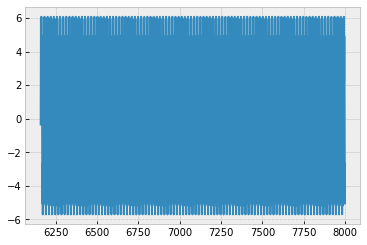

max in egs 5.885521236280134
finish this plot
Omega 0.3434343434343435


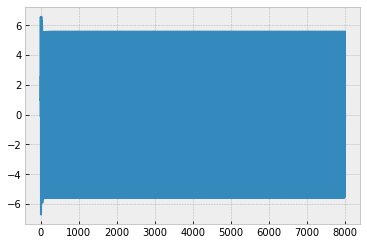

5.574075574397712


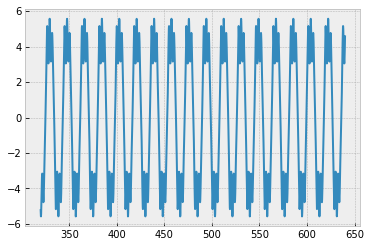

5.574101713648775


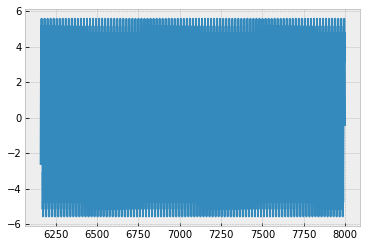

max in egs 5.574097182888611
finish this plot
Omega 0.3535353535353536


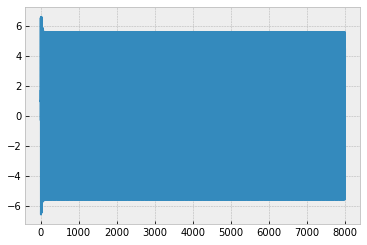

5.600370737381202


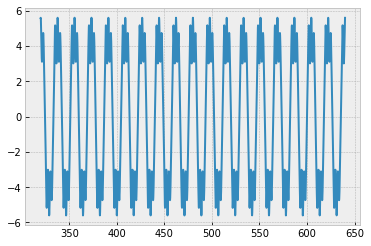

5.600372098887028


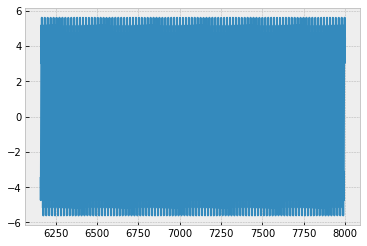

max in egs 5.600370149990595
finish this plot
Omega 0.36363636363636365


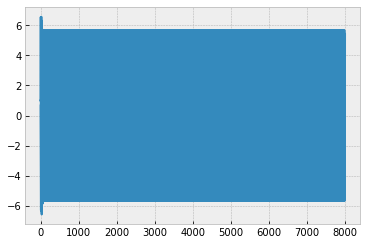

5.667036565237918


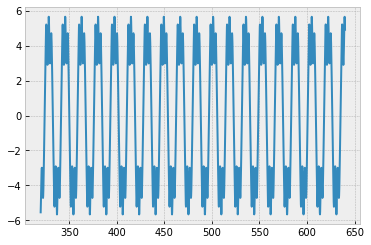

5.6670351425981025


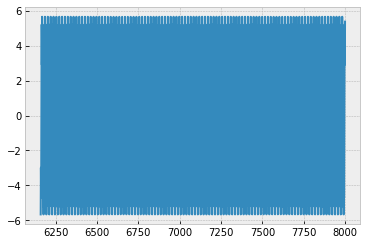

max in egs 5.666887378358053
finish this plot
Omega 0.37373737373737376


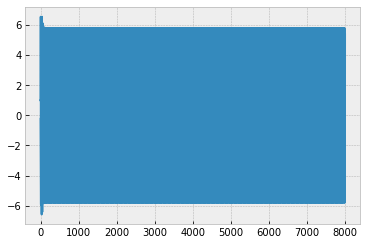

5.788208582792372


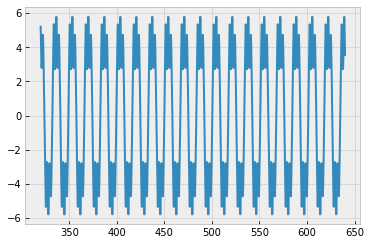

5.788270829087946


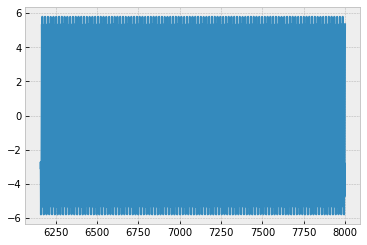

max in egs 5.788270816298433
finish this plot
Omega 0.38383838383838387


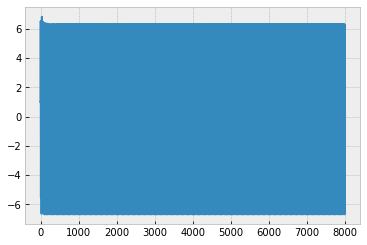

6.360751966626282


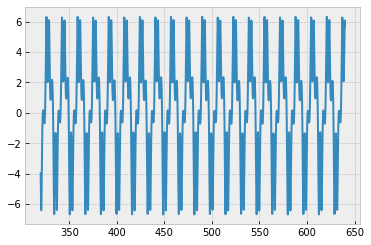

6.325154035492013


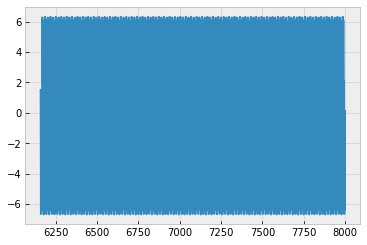

max in egs 6.506602344603241
finish this plot
Omega 0.393939393939394


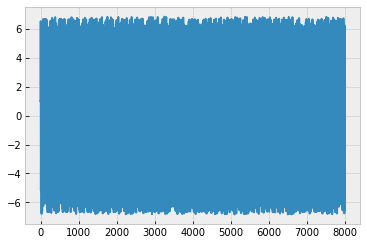

6.798681824017401


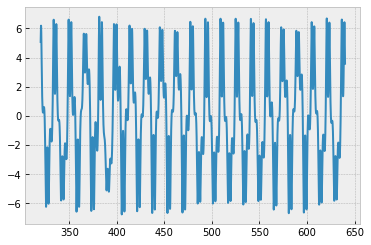

6.824728790841024


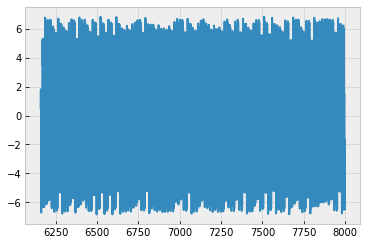

max in egs 6.818543640061268
finish this plot
Omega 0.4040404040404041


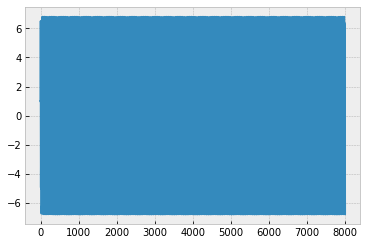

6.798471318728248


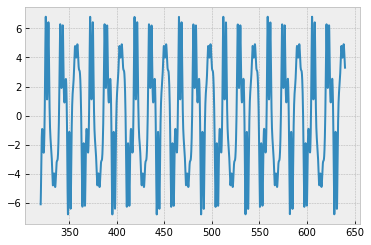

6.797654331198862


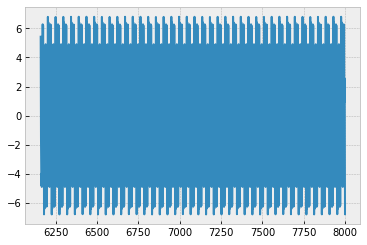

max in egs 6.797625821209872
finish this plot
Omega 0.4141414141414142


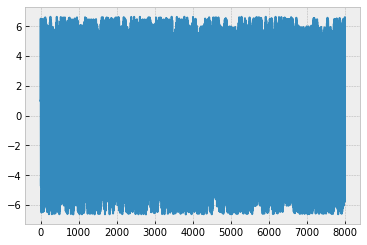

6.629885987319115


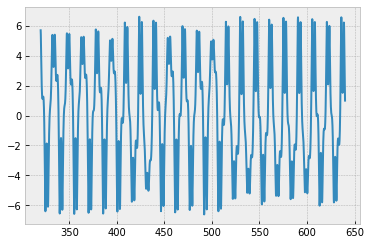

6.62971161731589


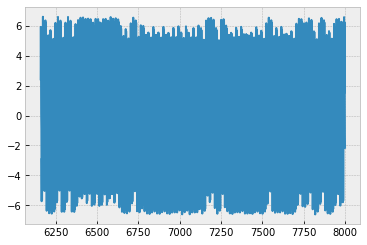

max in egs 6.610605300688606
finish this plot
Omega 0.42424242424242425


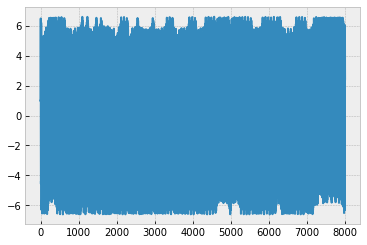

6.582904099881409


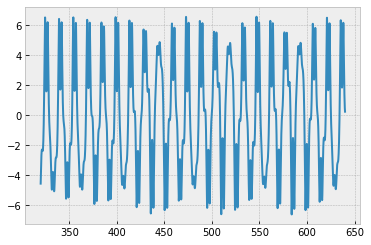

6.59900559428745


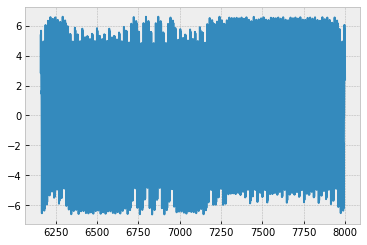

max in egs 6.553562319095128
finish this plot
Omega 0.43434343434343436


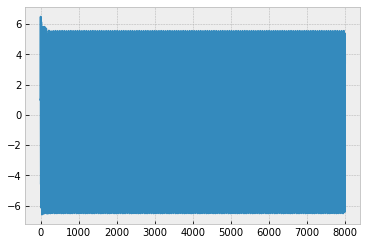

5.561604401127198


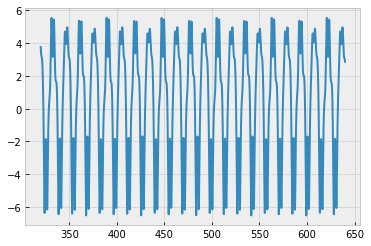

5.545384951561638


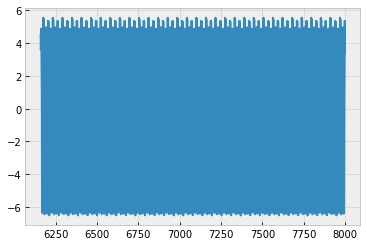

max in egs 6.030071635261573
finish this plot
Omega 0.4444444444444445


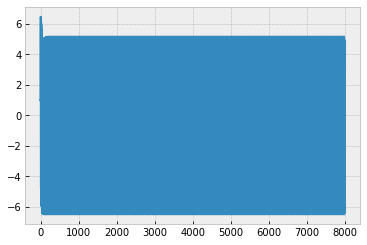

5.165524782061329


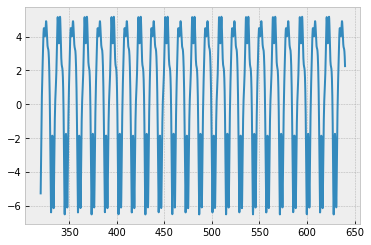

5.165534485958504


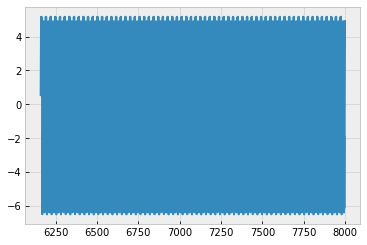

max in egs 5.830316487202874
finish this plot
Omega 0.4545454545454546


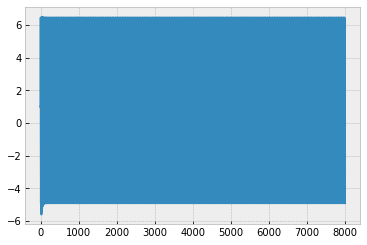

6.45737255614037


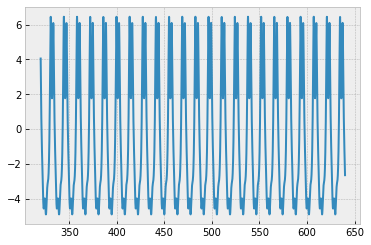

6.457179623026085


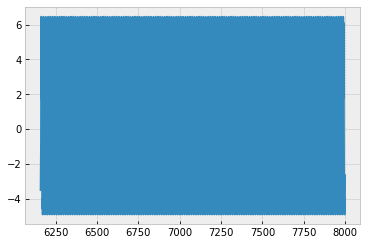

max in egs 5.6860451506591385
finish this plot
Omega 0.4646464646464647


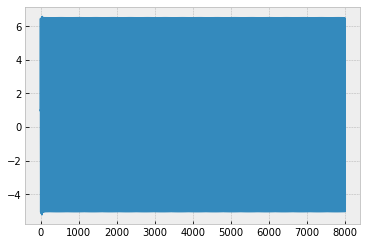

6.493192940314998


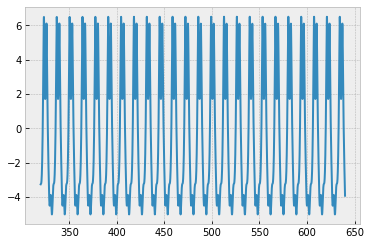

6.493201205700378


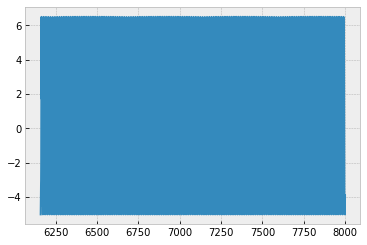

max in egs 5.750633379146013
finish this plot
Omega 0.4747474747474748


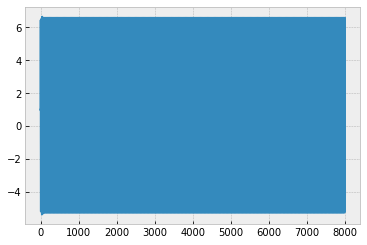

6.581598660253591


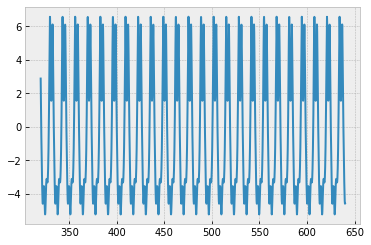

6.581615641011413


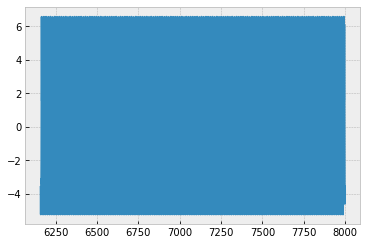

max in egs 5.912478410026573
finish this plot
Omega 0.48484848484848486


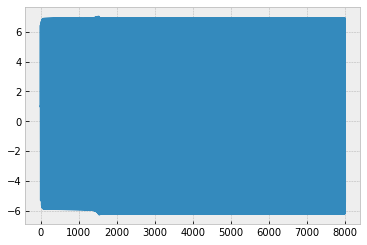

6.890273560777809


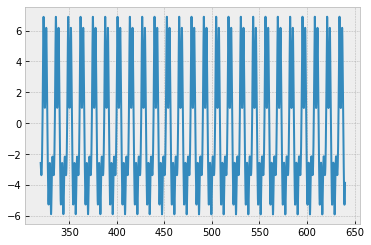

6.910189071763646


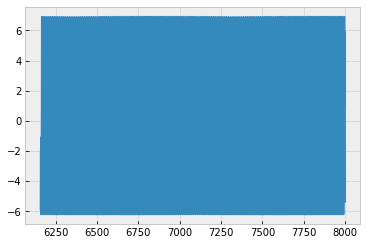

max in egs 6.560541693879821
finish this plot
Omega 0.494949494949495


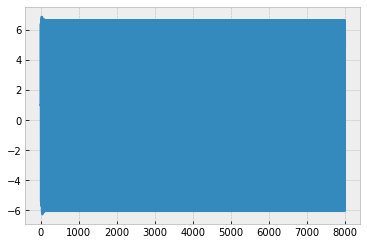

6.649506256372738


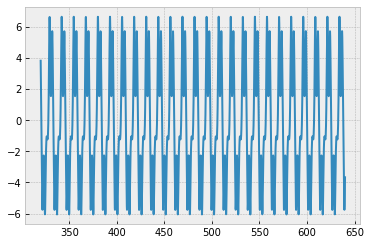

6.649518629258391


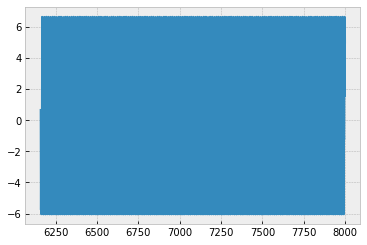

max in egs 6.350734671777646
finish this plot
Omega 0.5050505050505051


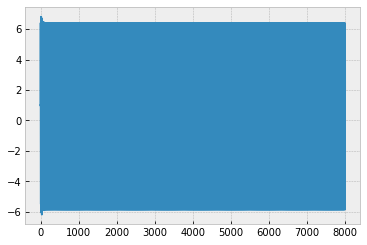

6.381683742789845


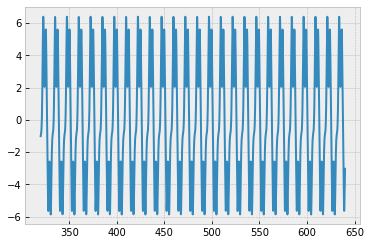

6.381339597701217


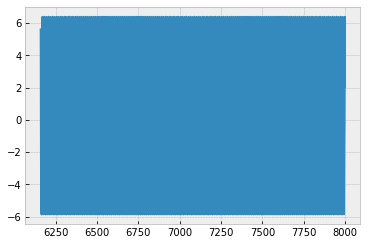

max in egs 6.119915506017712
finish this plot
Omega 0.5151515151515152


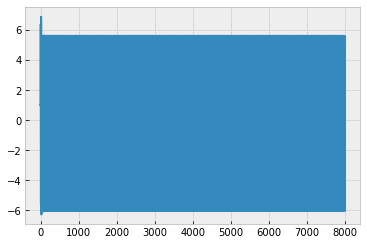

5.618275206486516


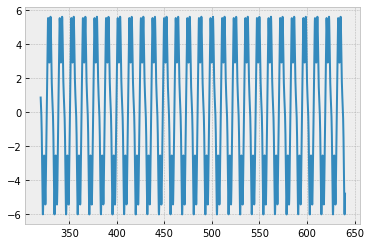

5.61828682804781


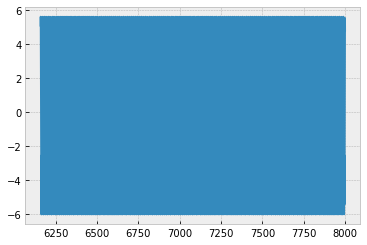

max in egs 5.8309048529901295
finish this plot
Omega 0.5252525252525253


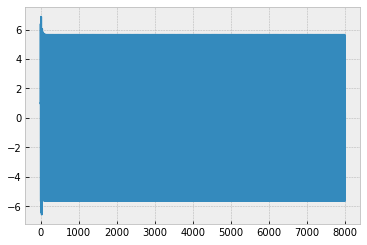

5.64274556970107


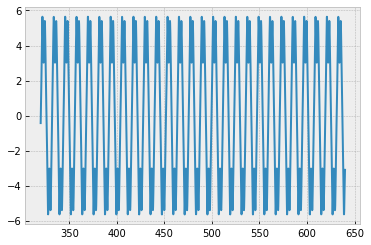

5.642519146776682


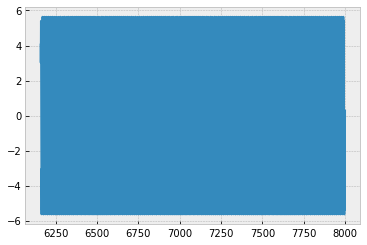

max in egs 5.642519137927105
finish this plot
Omega 0.5353535353535354


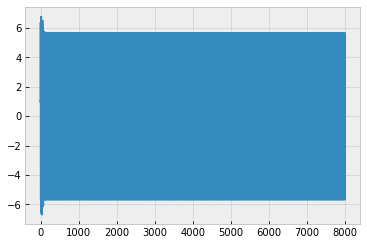

5.653142258538206


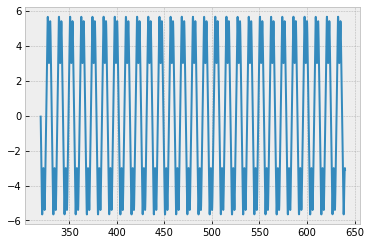

5.653152198198623


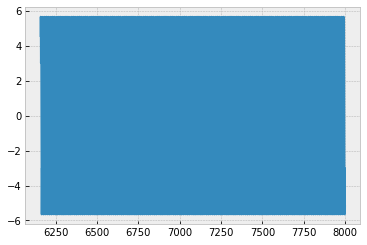

max in egs 5.653151565446253
finish this plot
Omega 0.5454545454545455


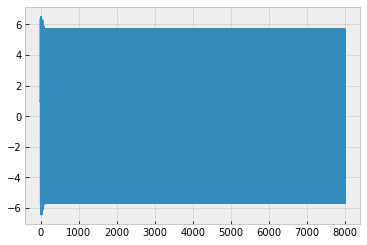

5.670631865509998


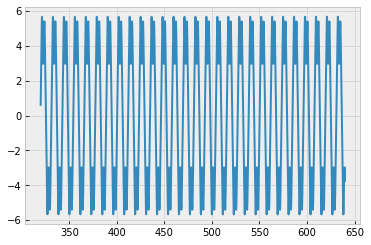

5.67221279955419


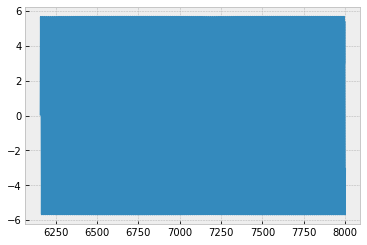

max in egs 5.672212661761025
finish this plot
Omega 0.5555555555555556


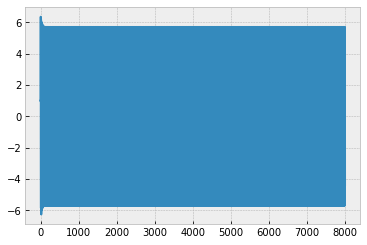

5.699833993406793


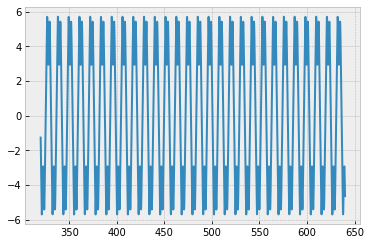

5.699834058678892


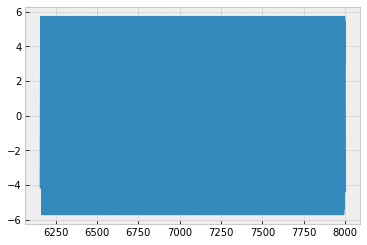

max in egs 5.699830119695401
finish this plot
Omega 0.5656565656565657


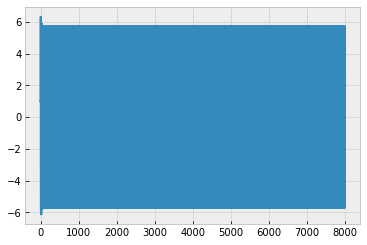

5.7363633544286134


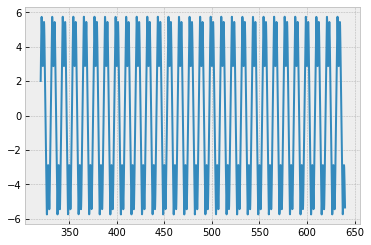

5.736367713880951


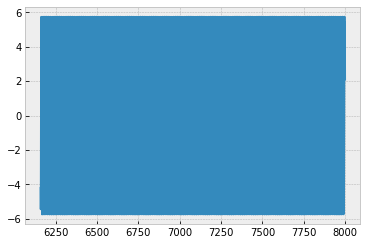

max in egs 5.736365088275841
finish this plot
Omega 0.5757575757575758


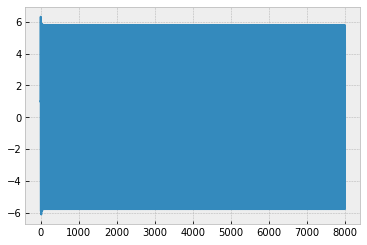

5.782469422631667


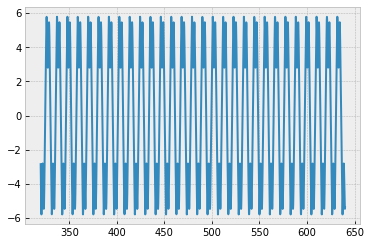

5.7824526967921885


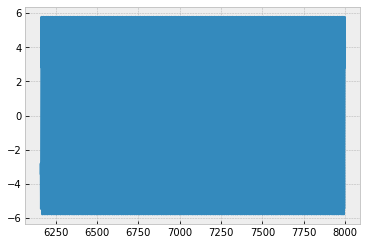

max in egs 5.782452212155144
finish this plot
Omega 0.5858585858585859


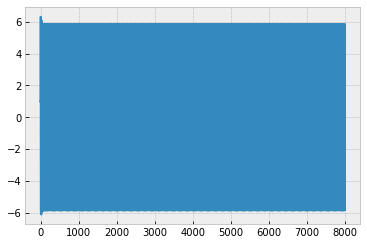

5.839119501454708


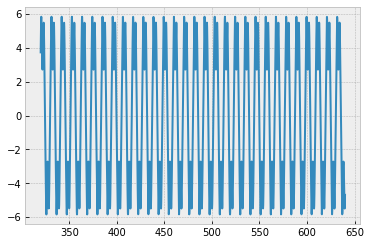

5.839119727370216


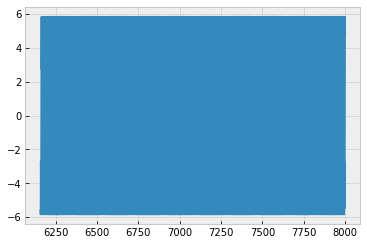

max in egs 5.839119119220527
finish this plot
Omega 0.595959595959596


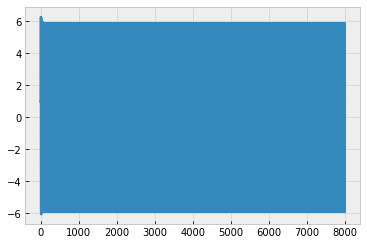

5.907985836471559


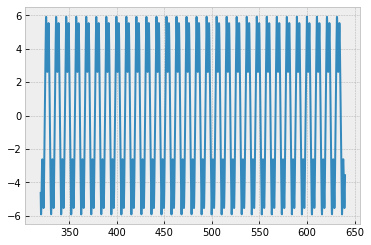

5.907987997619889


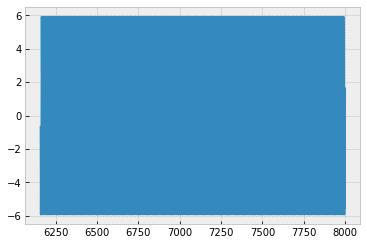

max in egs 5.90797927595543
finish this plot
Omega 0.6060606060606061


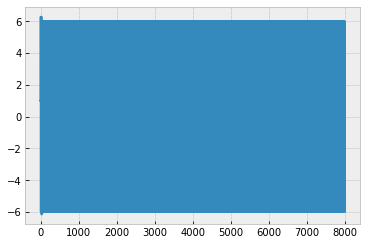

5.991658539093209


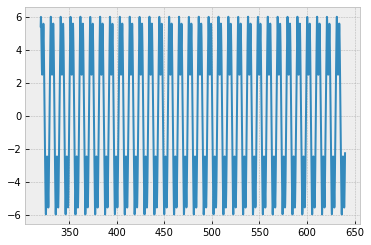

5.991659630201947


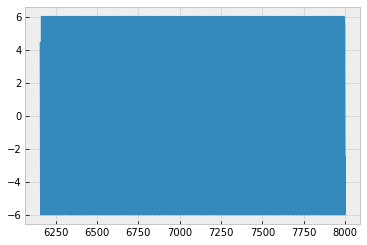

max in egs 5.991659447425067
finish this plot
Omega 0.6161616161616162


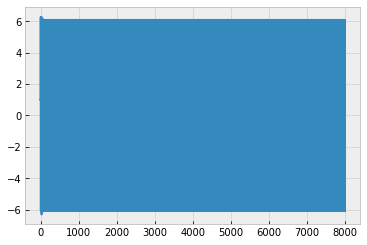

6.09461617492342


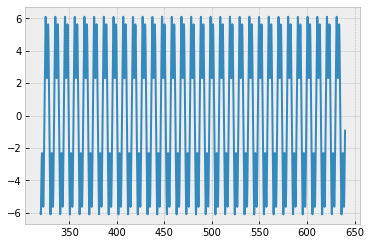

6.09461709101459


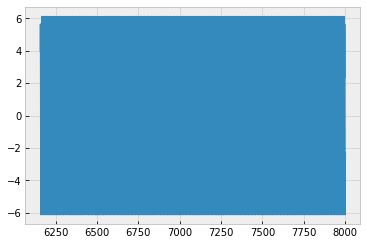

max in egs 6.094616497992081
finish this plot
Omega 0.6262626262626263


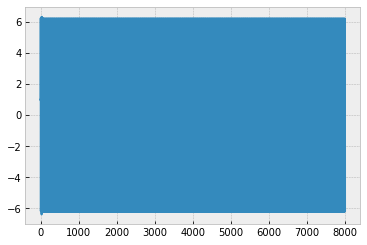

6.225684048555071


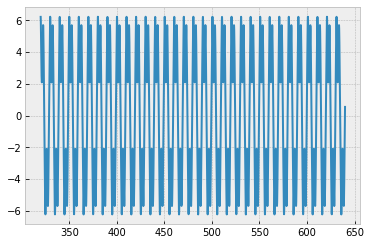

6.225687156253976


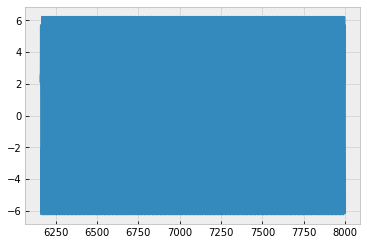

max in egs 6.225677739710535
finish this plot
Omega 0.6363636363636365


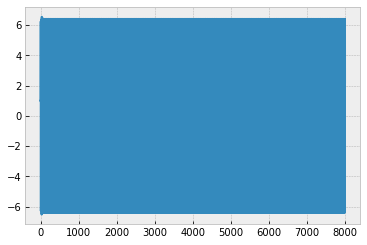

6.407817792165427


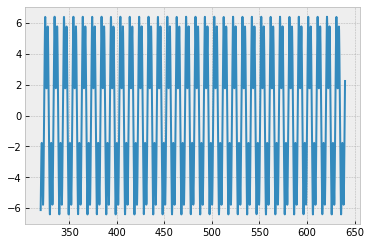

6.40782473461728


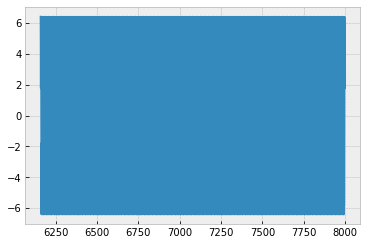

max in egs 6.407823351268791
finish this plot
Omega 0.6464646464646465


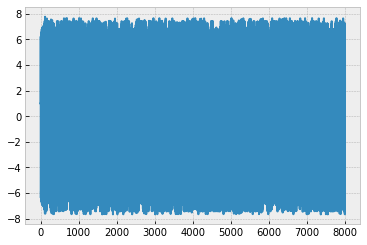

7.654155950321386


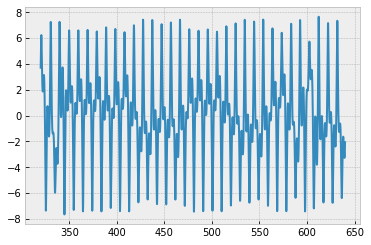

7.668615916150204


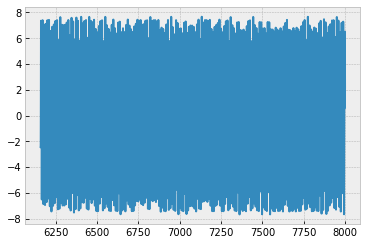

max in egs 7.666345394510304
finish this plot
Omega 0.6565656565656566


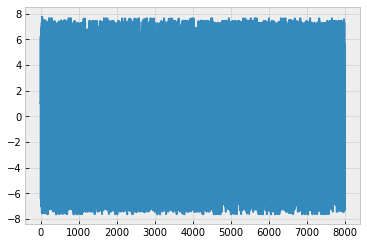

7.650793480563645


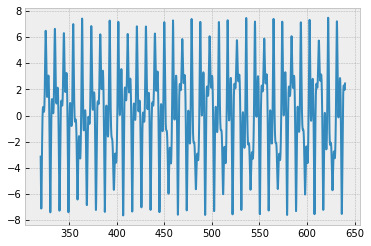

7.641690202461041


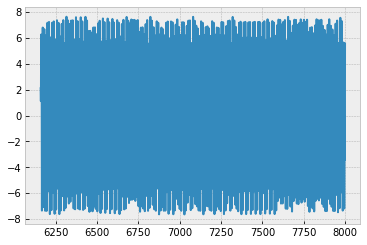

max in egs 7.629656028984955
finish this plot
Omega 0.6666666666666667


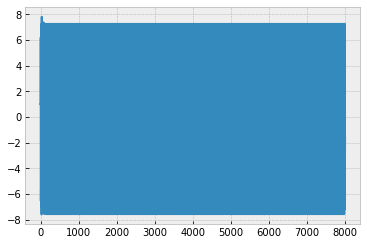

7.271181252522991


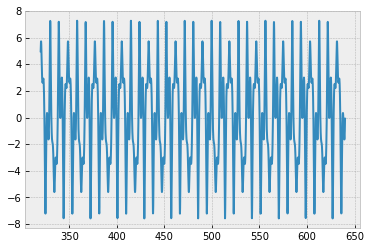

7.2712123827625845


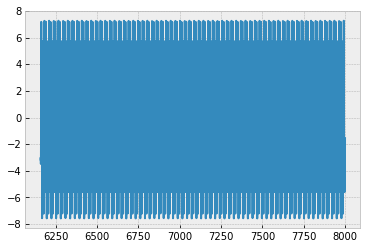

max in egs 7.426884852953501
finish this plot
Omega 0.6767676767676768


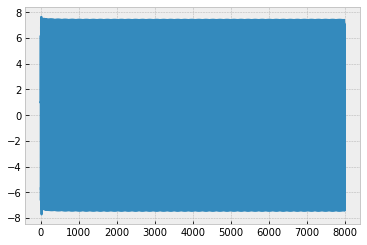

7.455077002857901


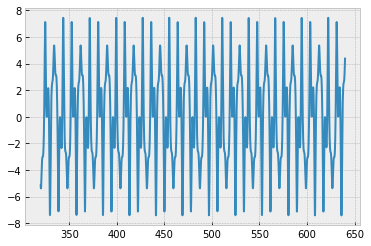

7.4266281974173385


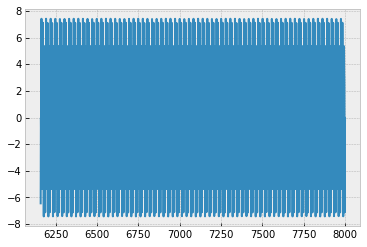

max in egs 7.4266140613565055
finish this plot
Omega 0.686868686868687


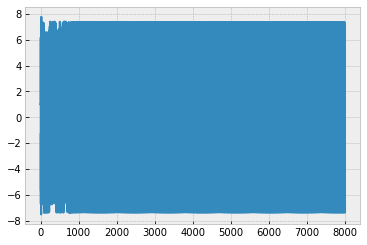

7.416474146185454


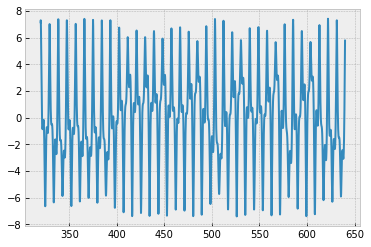

7.383885491198552


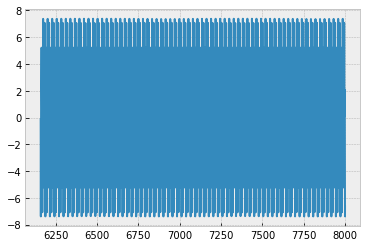

max in egs 7.3838743091727554
finish this plot
Omega 0.696969696969697


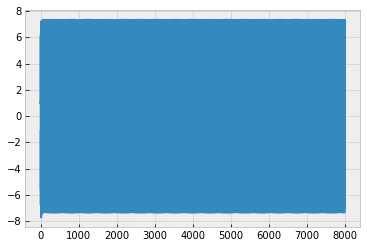

7.347705919609131


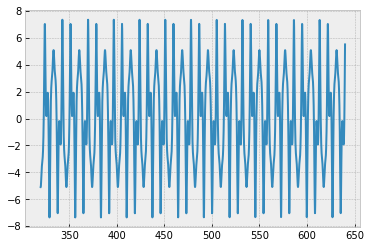

7.347708769250898


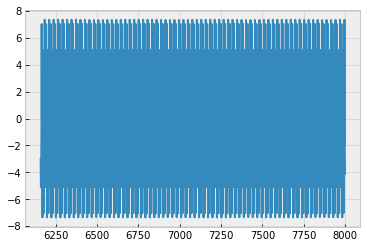

max in egs 7.347681467427816
finish this plot
Omega 0.7070707070707072


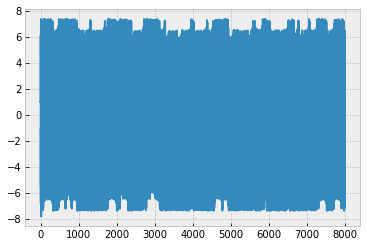

7.386169127749055


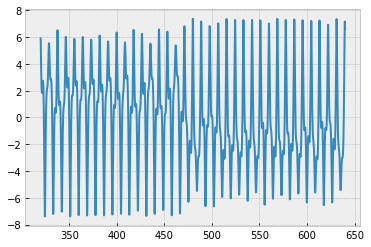

7.4054472254351555


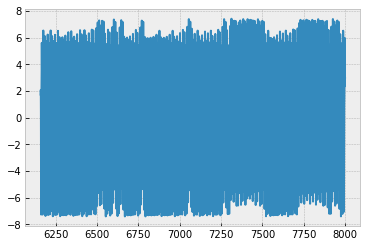

max in egs 7.399165487329311
finish this plot
Omega 0.7171717171717172


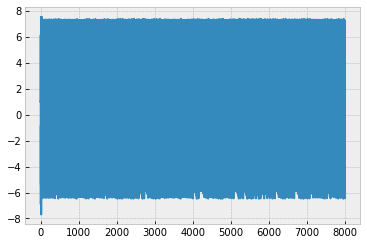

7.365315129448716


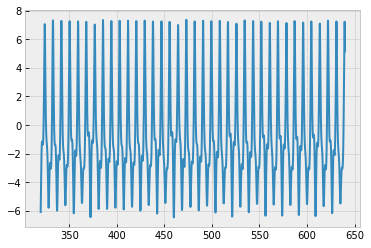

7.374374092083742


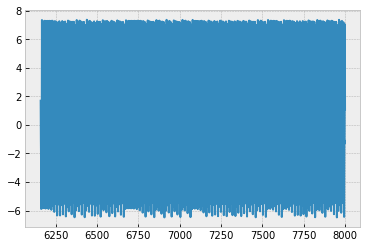

max in egs 6.92165625997743
finish this plot
Omega 0.7272727272727273


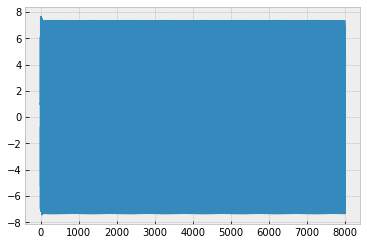

7.3221351671630845


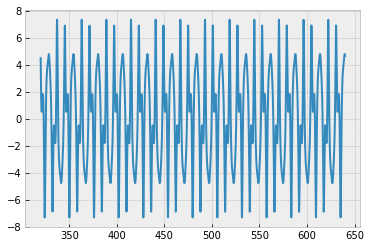

7.322132281964282


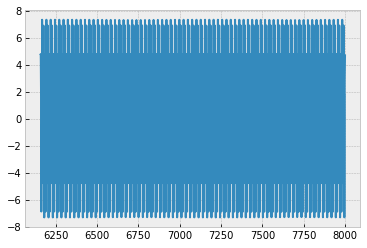

max in egs 7.322130694290916
finish this plot
Omega 0.7373737373737375


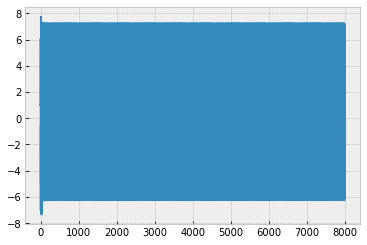

7.240079489697497


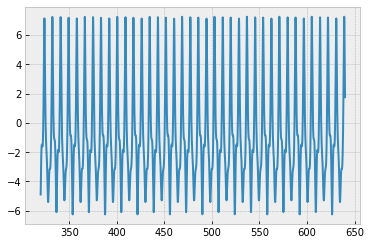

7.240081145879062


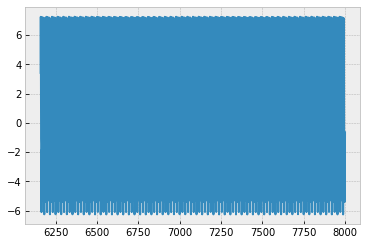

max in egs 6.745327415896269
finish this plot
Omega 0.7474747474747475


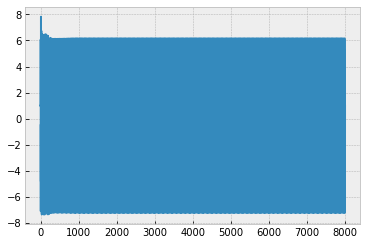

6.3725976988561275


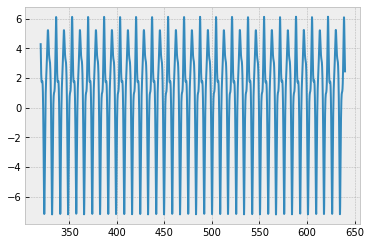

6.161640207430787


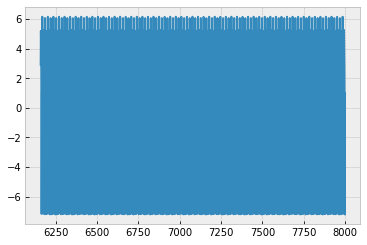

max in egs 6.684526438321867
finish this plot
Omega 0.7575757575757577


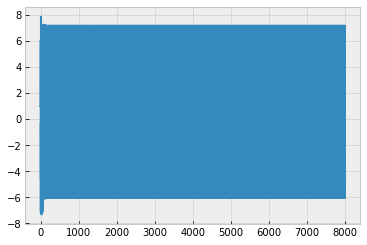

7.178532827423281


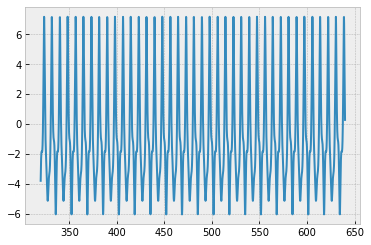

7.177247914151579


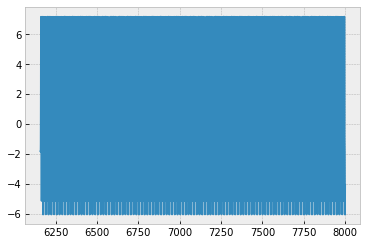

max in egs 6.614647997687735
finish this plot
Omega 0.7676767676767677


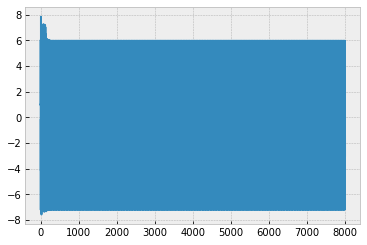

6.113825696703948


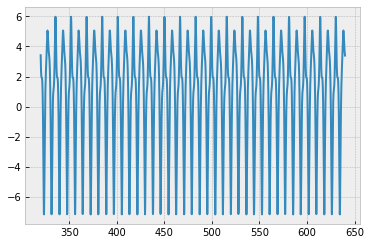

5.977384728834795


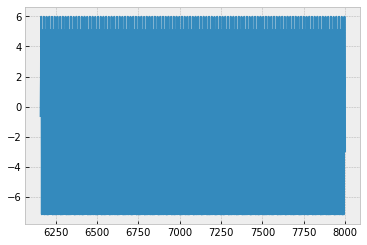

max in egs 6.575294570874861
finish this plot
Omega 0.7777777777777778


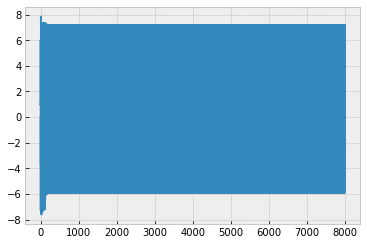

7.2041069508904245


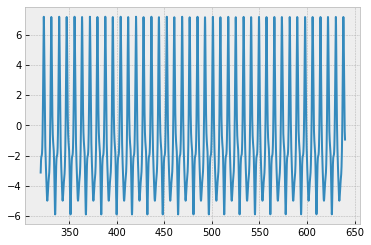

7.176934270338627


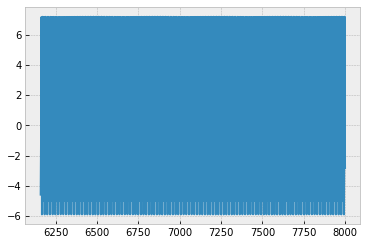

max in egs 6.53660822020611
finish this plot
Omega 0.787878787878788


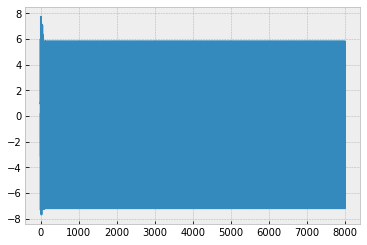

5.805206167332391


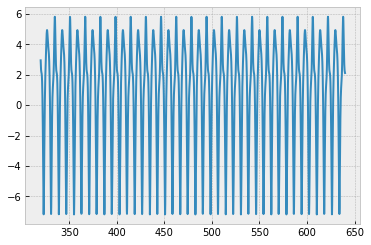

5.805206213685955


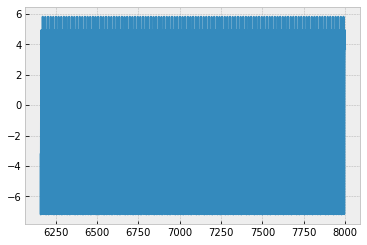

max in egs 6.4941183825387245
finish this plot
Omega 0.797979797979798


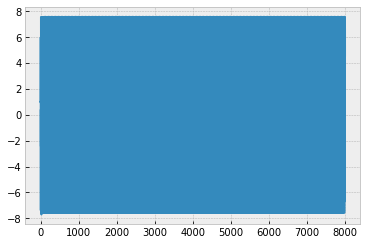

7.584566819438643


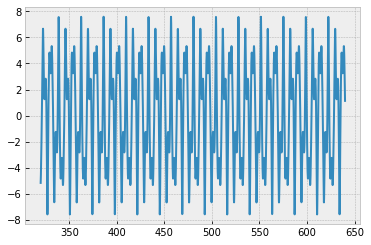

7.584617356734864


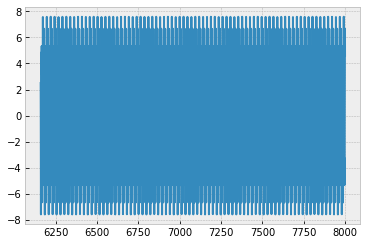

max in egs 7.5845982579100335
finish this plot
Omega 0.8080808080808082


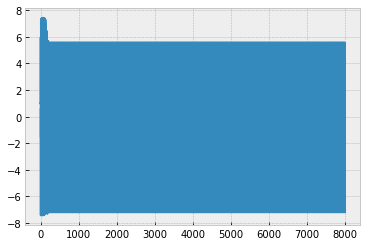

6.294150688939799


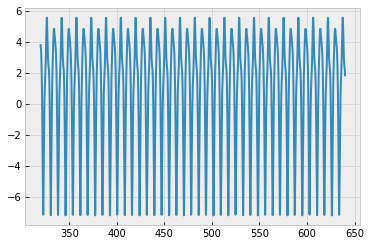

5.56701251288478


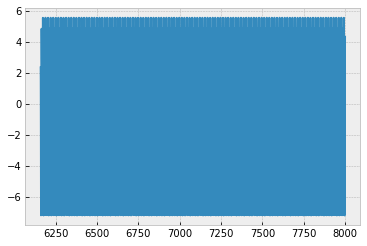

max in egs 6.385035877120671
finish this plot
Omega 0.8181818181818182


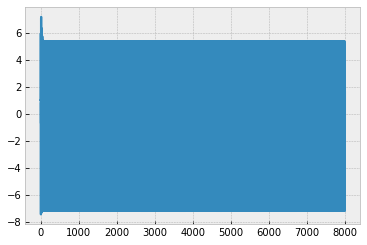

5.386260500161085


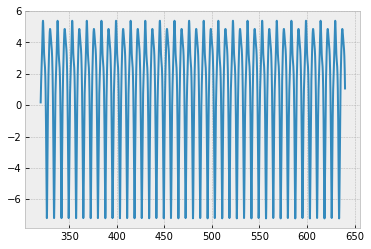

5.386263961732242


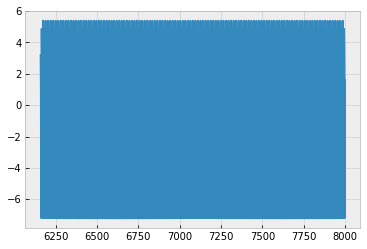

max in egs 6.300897754329106
finish this plot
Omega 0.8282828282828284


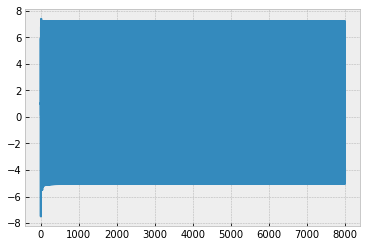

7.221956692652605


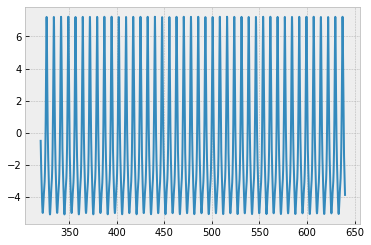

7.219861927035277


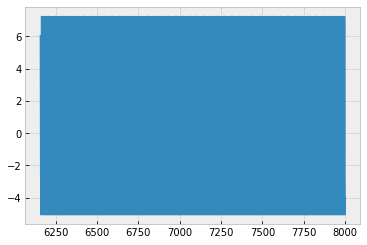

max in egs 6.126401614372233
finish this plot
Omega 0.8383838383838385


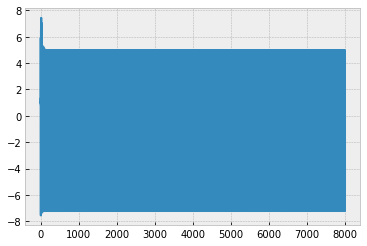

4.979634998553936


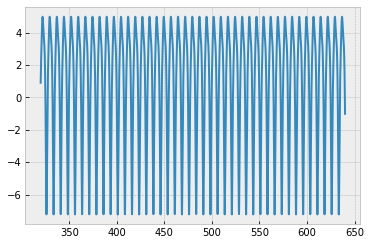

4.975222726025486


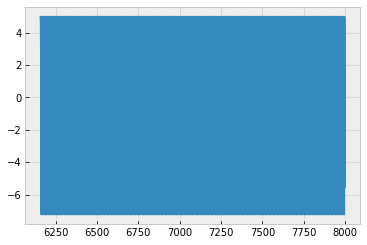

max in egs 6.102368474934296
finish this plot
Omega 0.8484848484848485


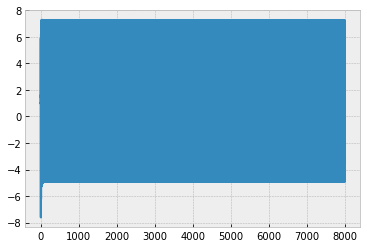

7.242156211567972


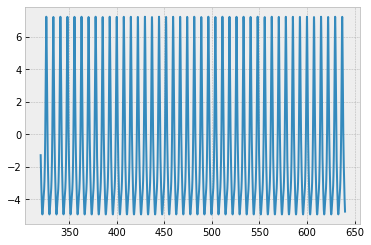

7.2421593558961295


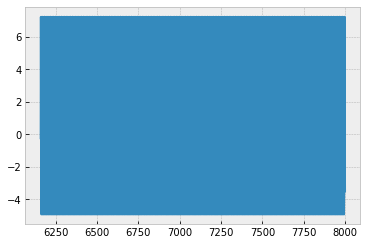

max in egs 6.082581590163539
finish this plot
Omega 0.8585858585858587


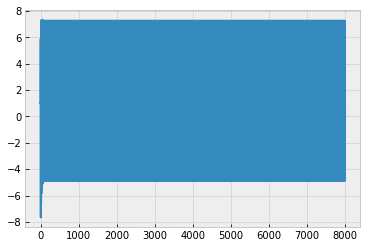

7.257815581586138


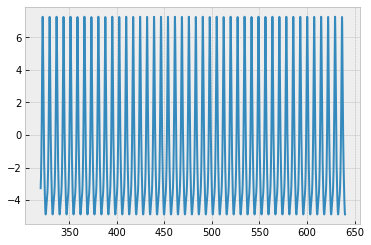

7.257816752434006


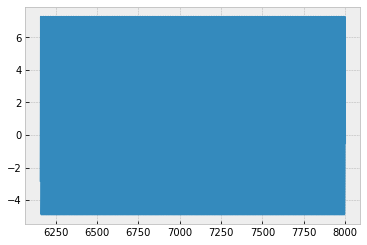

max in egs 6.068587902017537
finish this plot
Omega 0.8686868686868687


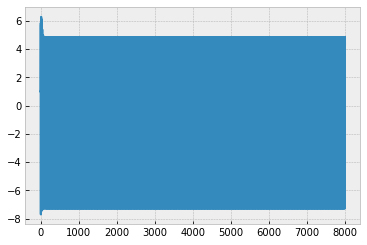

4.848139999411523


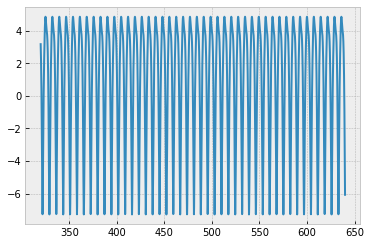

4.848142756069026


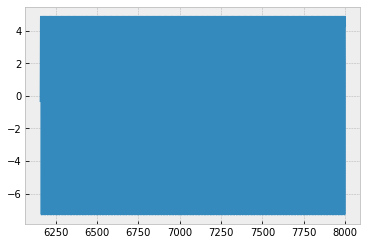

max in egs 6.062329307385536
finish this plot
Omega 0.8787878787878789


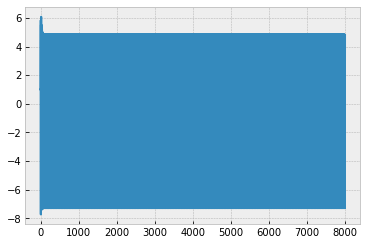

4.8329975681774675


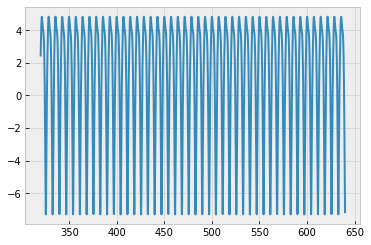

4.832998283976241


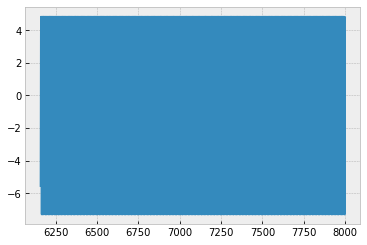

max in egs 6.065649946579688
finish this plot
Omega 0.888888888888889


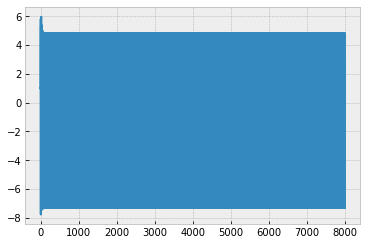

4.8360533299080695


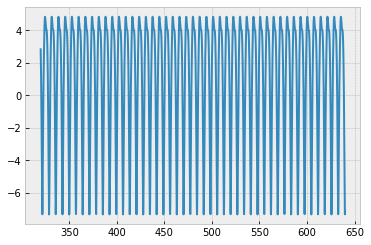

4.836055595867918


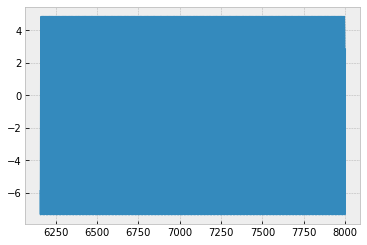

max in egs 6.07964080715951
finish this plot
Omega 0.8989898989898991


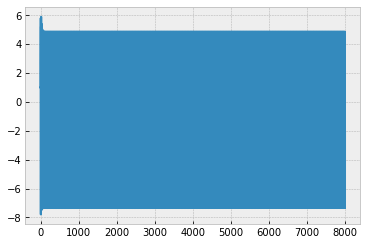

4.857437621008488


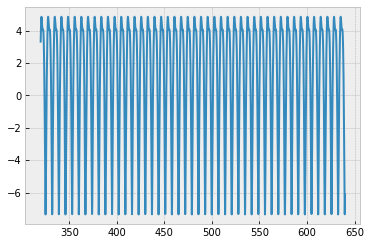

4.857441286573555


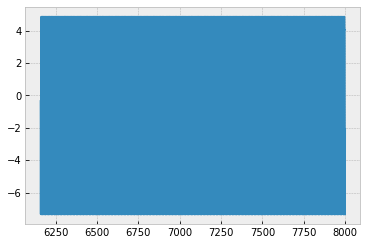

max in egs 6.104361700808068
finish this plot
Omega 0.9090909090909092


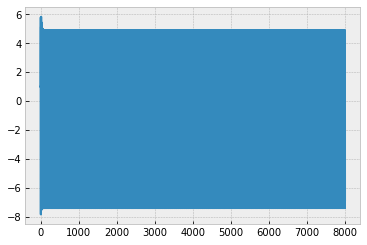

4.896084386564076


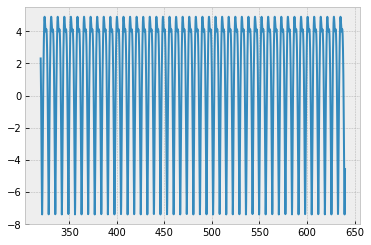

4.895946343028045


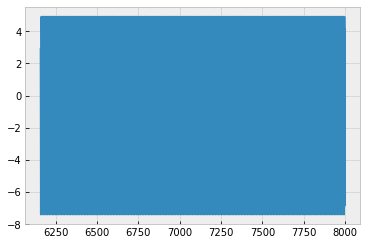

max in egs 6.139393374703981
finish this plot
Omega 0.9191919191919192


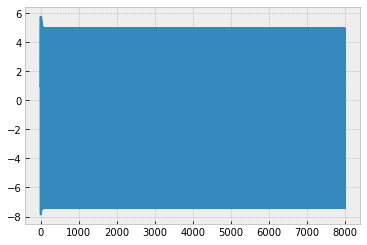

4.950032342279157


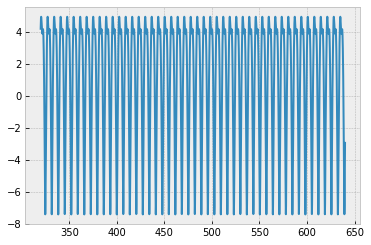

4.949879201628837


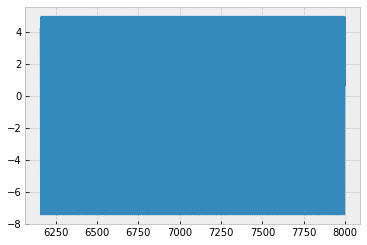

max in egs 6.183844279016053
finish this plot
Omega 0.9292929292929294


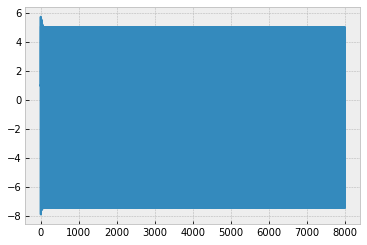

5.017855900307583


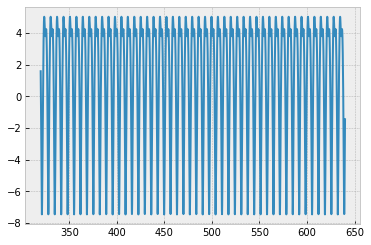

5.017791882463593


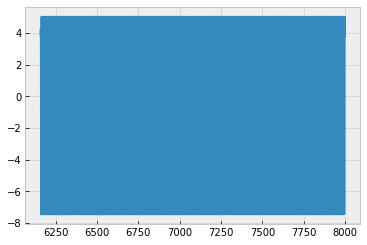

max in egs 6.23712362873697
finish this plot
Omega 0.9393939393939394


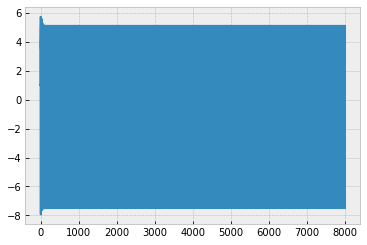

5.09876743387652


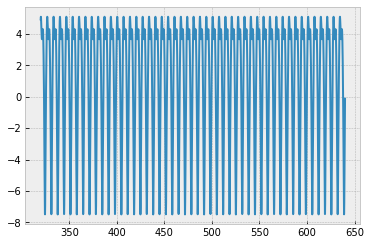

5.09874800641497


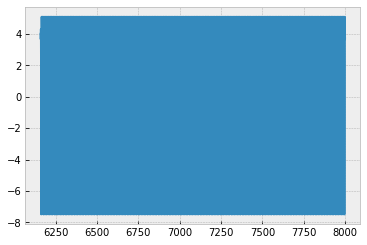

max in egs 6.298907011417667
finish this plot
Omega 0.9494949494949496


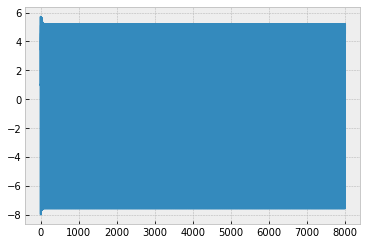

5.192488489749059


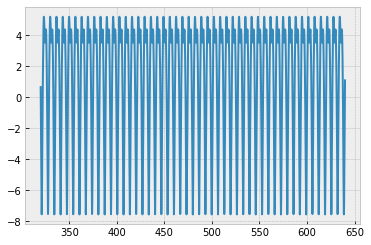

5.192488529885309


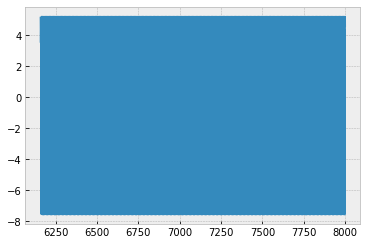

max in egs 6.369282226996802
finish this plot
Omega 0.9595959595959597


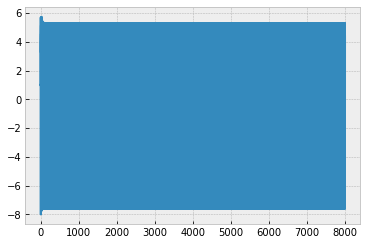

5.299597267316061


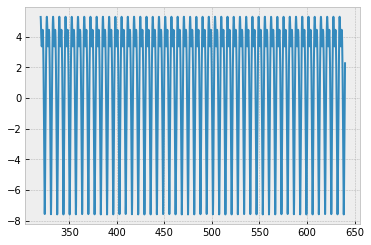

5.299605885746963


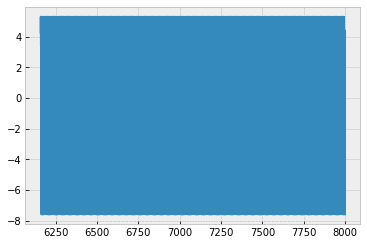

max in egs 6.4488382787424605
finish this plot
Omega 0.9696969696969697


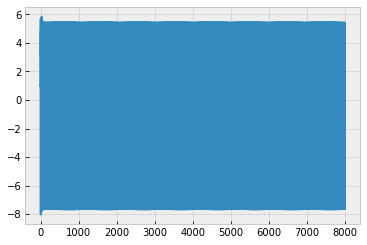

5.421912891696068


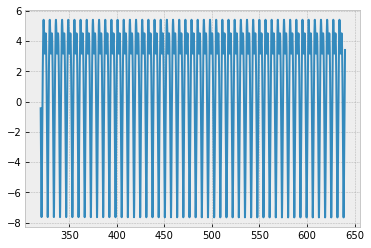

5.421912673255498


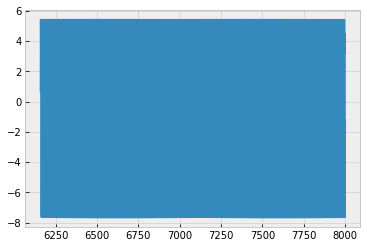

max in egs 6.5389483503170265
finish this plot
Omega 0.9797979797979799


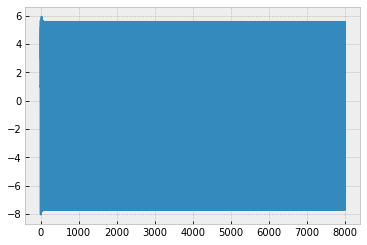

5.563430522500877


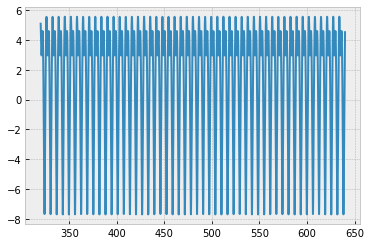

5.56337121920979


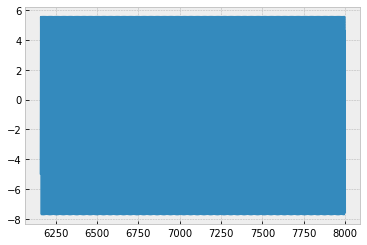

max in egs 6.6423780212448005
finish this plot
Omega 0.98989898989899


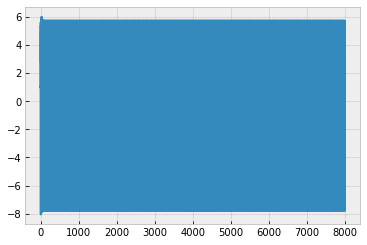

5.732859886862935


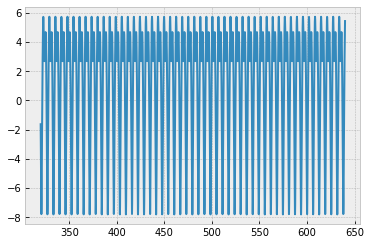

5.732839781826429


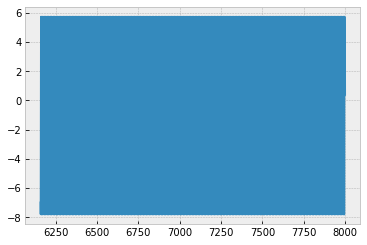

max in egs 6.76508104692272
finish this plot
Omega 1.0


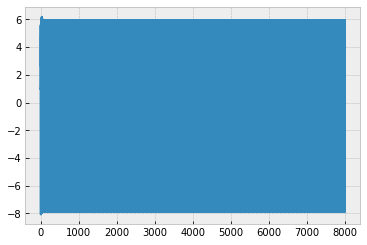

5.956043751105896


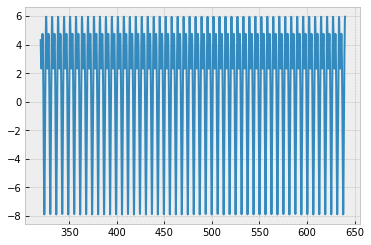

5.955956732805018


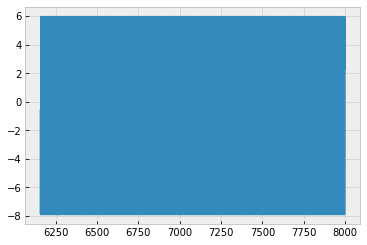

max in egs 6.923861625488394
finish this plot


In [68]:
omegas = np.linspace(0, 1, 100)
AmpND3 = []
f = FloatProgress(min=0, max=100)
display(f)
for o in omegas:
    Omega = o
    time = 8000
    steps = 100000
    co, ts, ges = coordForcedOsz(y0, 0, time, steps, D3=True)
    cAmpND3, err = eingeschwungen(co, ts)
    print('Omega', Omega)
    #if round(o) == 1 or round(o) == 2:
    plt.plot(ts, co)
    plt.show()
    plt.plot(ts[4000:8000], co[4000:8000])
    print(max(co[2000:8000]))
    plt.show()
    plt.plot(ts[77000:], co[77000:])
    print(max(co[60000:]))
    plt.show()
    print('max in egs', cAmpND3)
    print('finish this plot')
    #plt.plot(ts, co)
    #plt.show()
    f.value += 1
    AmpND3.append(cAmpND3)

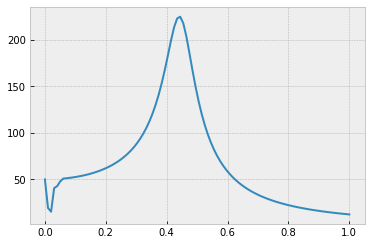

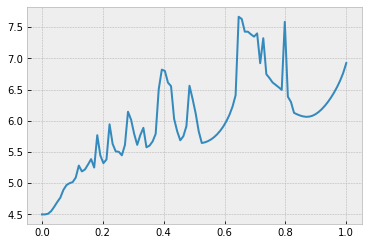

In [69]:
plt.plot(omegasn, AmpN)
plt.show()
plt.plot(omegas, AmpND3)
#plt.show()
Ampold = AmpND3


FloatProgress(value=0.0, max=500.0)

Omega 0.0


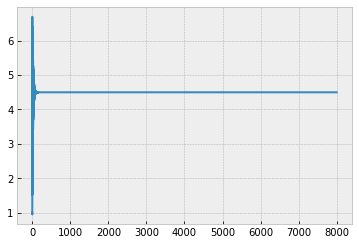

4.4989269605357425


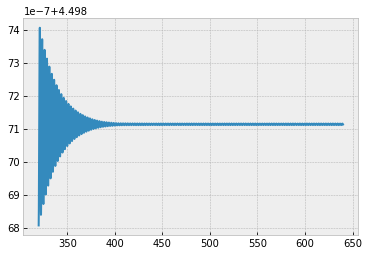

4.498007116288406


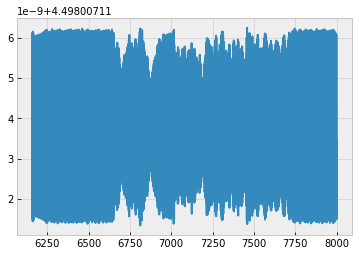

max in egs 4.498007113802884
finish this plot
Omega 0.006012024048096192


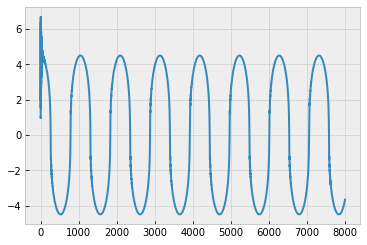

3.68051943825292


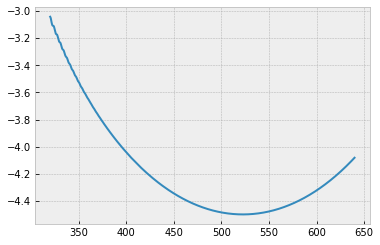

4.498015912001557


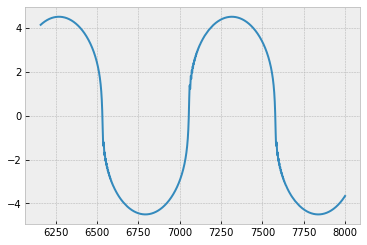

max in egs 4.498015904741119
finish this plot
Omega 0.012024048096192385


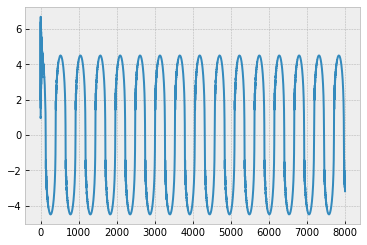

4.49856614415639


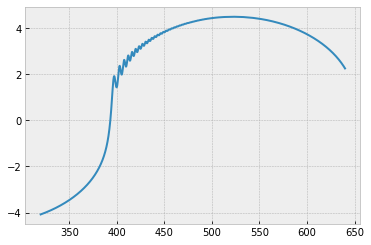

4.498566207137496


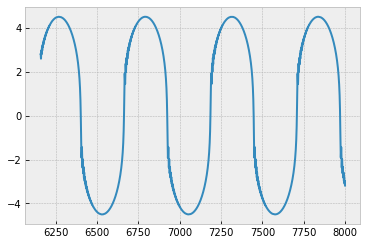

max in egs 4.498564870299626
finish this plot
Omega 0.018036072144288578


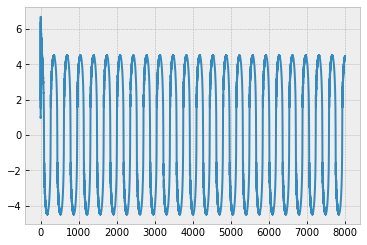

4.504085447294821


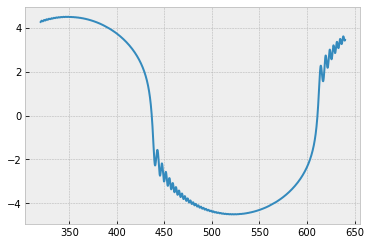

4.504097632627364


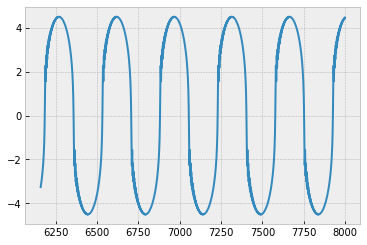

max in egs 4.504093621945739
finish this plot
Omega 0.02404809619238477


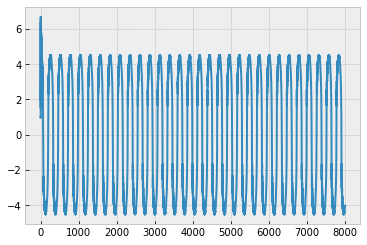

4.521312795573654


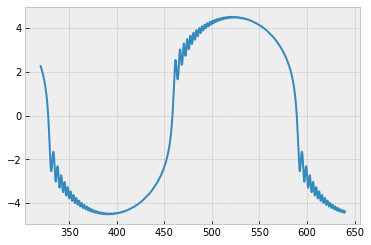

4.521312218776882


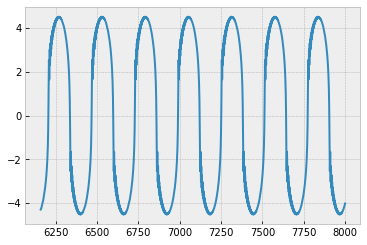

max in egs 4.521286902732983
finish this plot
Omega 0.03006012024048096


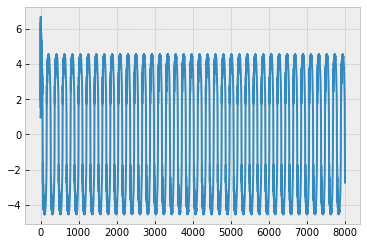

4.549232622043504


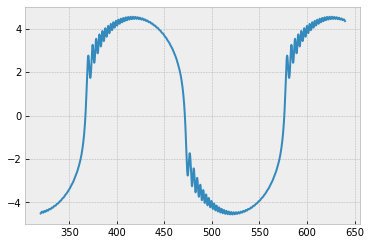

4.549249548652104


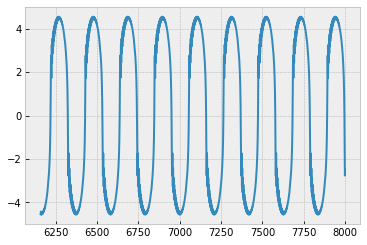

max in egs 4.549245103810673
finish this plot
Omega 0.036072144288577156


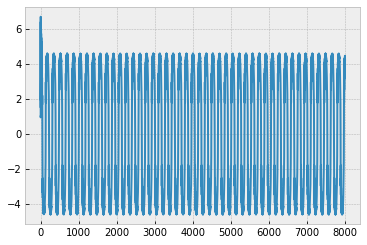

4.587890587174441


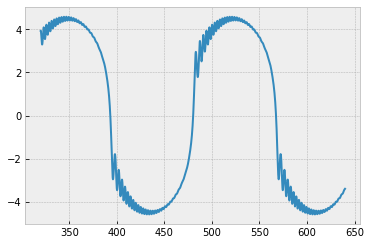

4.587824911956436


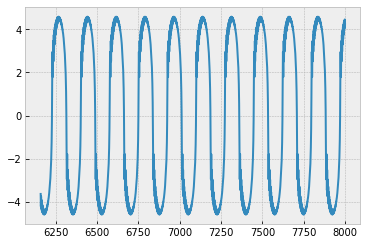

max in egs 4.587808521898342
finish this plot
Omega 0.04208416833667335


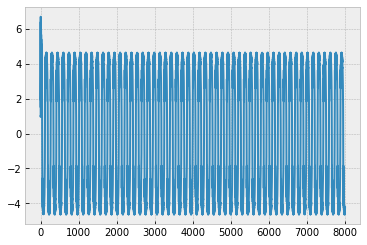

4.6311765264306946


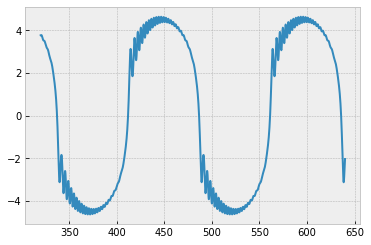

4.631289637840804


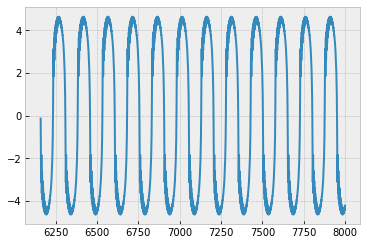

max in egs 4.63127837400881
finish this plot
Omega 0.04809619238476954


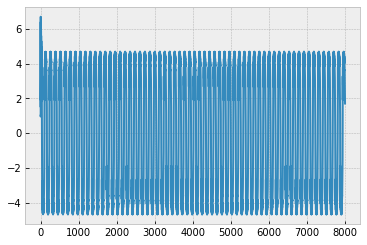

4.6805239204869675


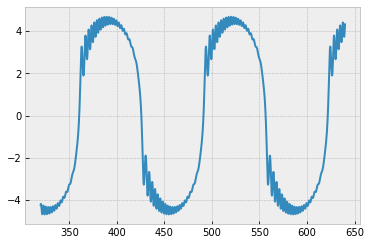

4.680592502092909


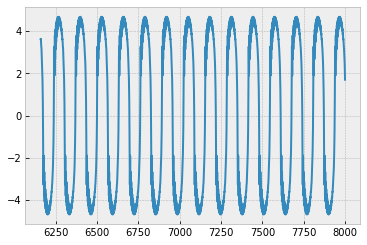

max in egs 4.6803370217477696
finish this plot
Omega 0.05410821643286573


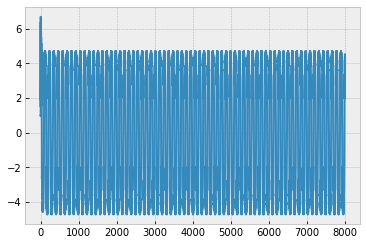

4.718715789417047


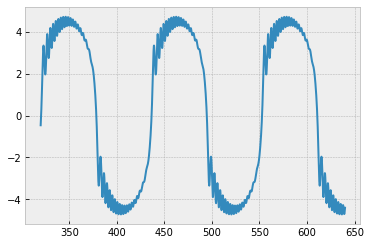

4.718770992293623


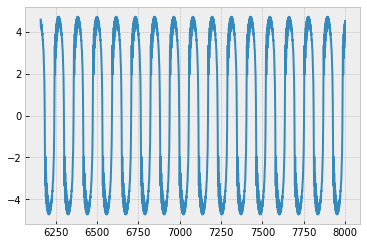

max in egs 4.718701701494135
finish this plot
Omega 0.06012024048096192


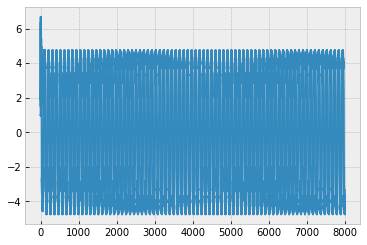

4.7619652676851985


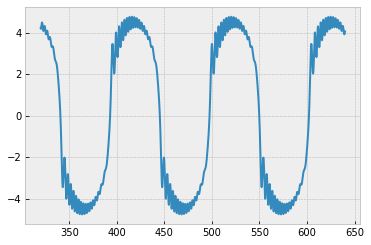

4.761967549678041


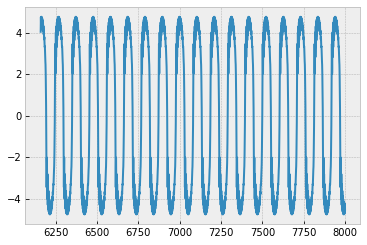

max in egs 4.761957018887882
finish this plot
Omega 0.06613226452905811


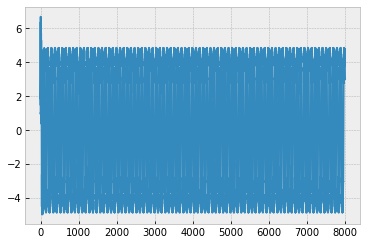

4.85353133700637


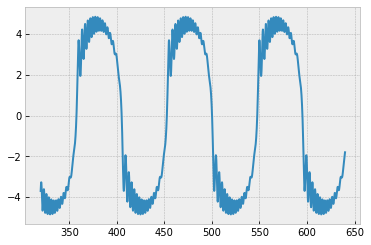

4.853541408404868


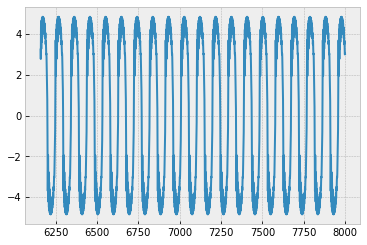

max in egs 4.853481571996724
finish this plot
Omega 0.07214428857715431


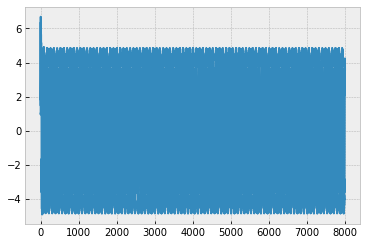

4.855445546050248


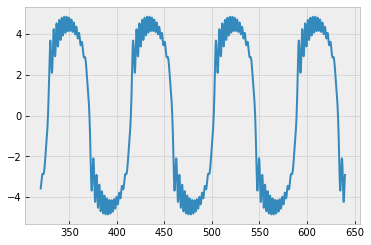

4.853650016194004


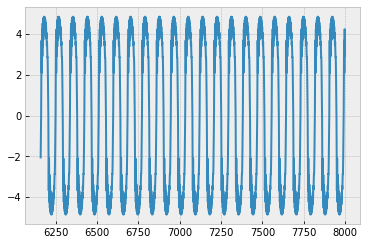

max in egs 4.853643349692664
finish this plot
Omega 0.0781563126252505


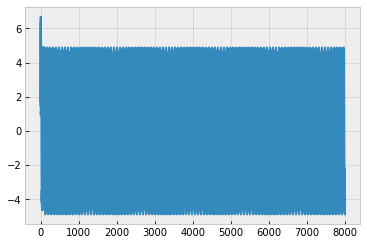

4.885653554705271


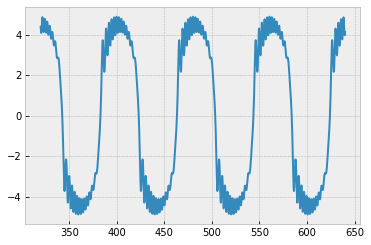

4.885652710212655


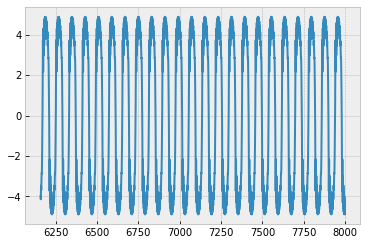

max in egs 4.885643368132763
finish this plot
Omega 0.0841683366733467


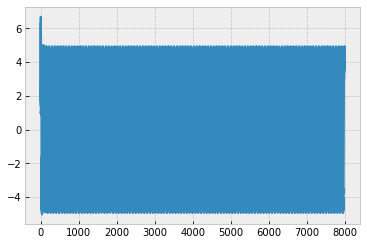

4.928663706402322


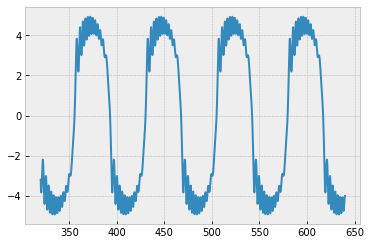

4.927773721467904


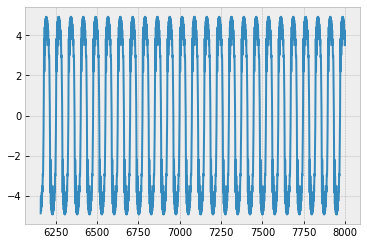

max in egs 4.9277553976679656
finish this plot
Omega 0.09018036072144288


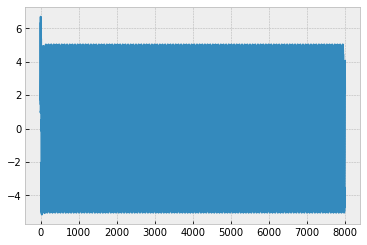

5.0277213746411835


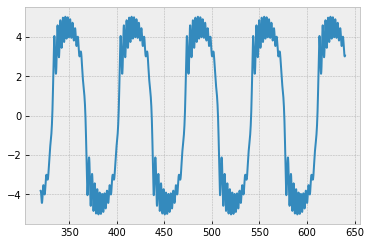

5.027731146136885


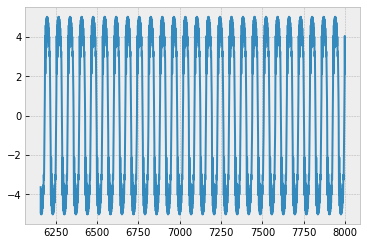

max in egs 5.0277154557777655
finish this plot
Omega 0.09619238476953908


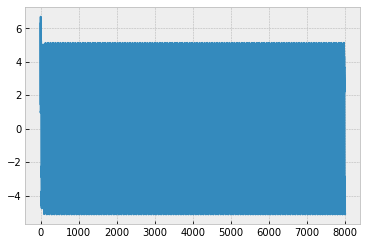

5.1226075913427


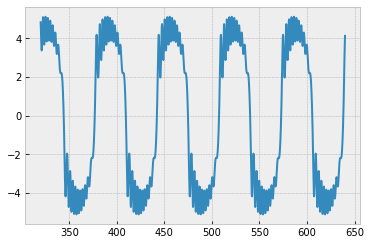

5.1229304827423645


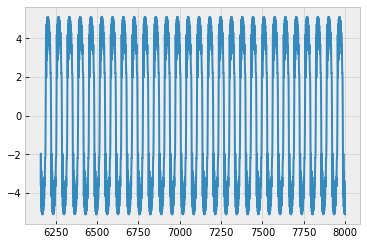

max in egs 5.122925838524495
finish this plot
Omega 0.10220440881763528


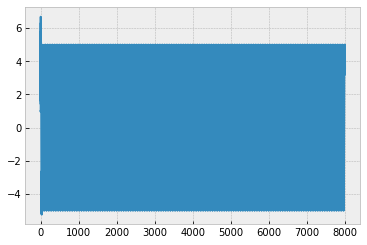

5.004250645601243


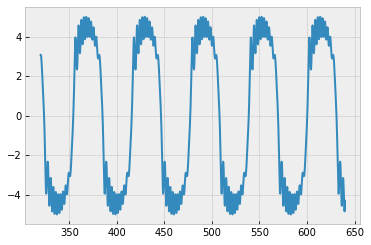

5.004253211903797


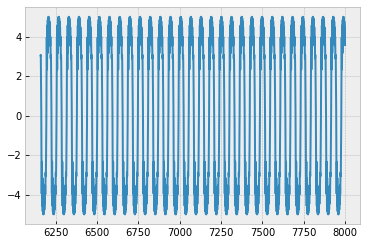

max in egs 5.004252400820788
finish this plot
Omega 0.10821643286573146


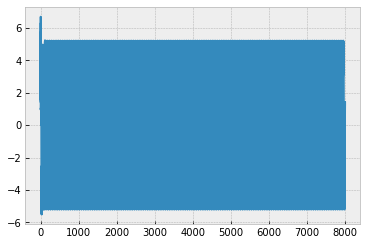

5.207294954797584


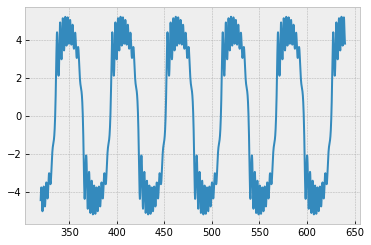

5.207295820149812


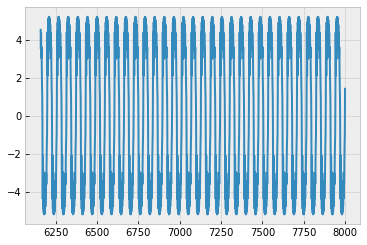

max in egs 5.207254245161451
finish this plot
Omega 0.11422845691382766


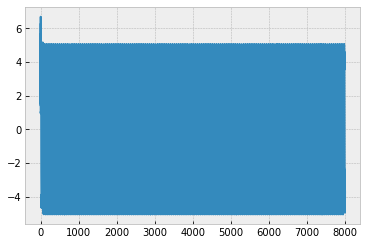

5.053820267180817


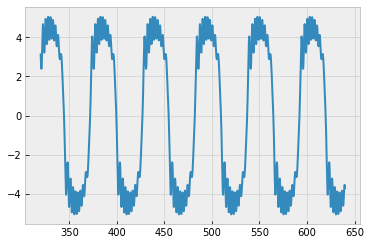

5.053838011217624


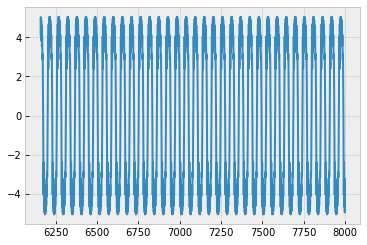

max in egs 5.053837930079207
finish this plot
Omega 0.12024048096192384


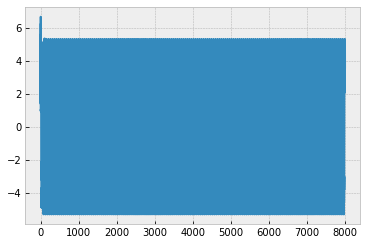

5.324492985256701


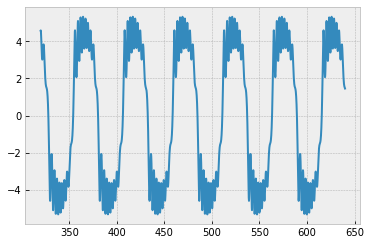

5.32462663180694


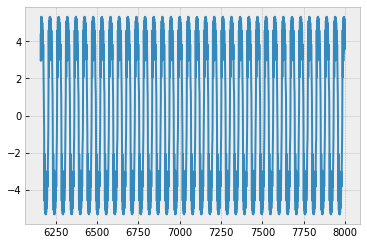

max in egs 5.32461176545843
finish this plot
Omega 0.12625250501002003


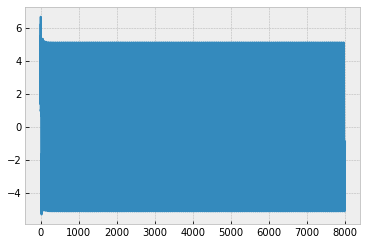

5.132434603289653


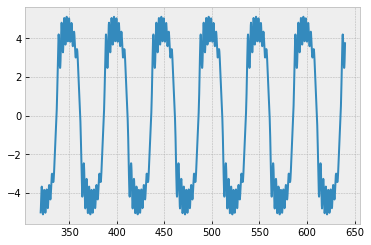

5.122399546700124


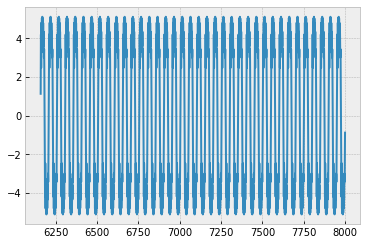

max in egs 5.122393832926287
finish this plot
Omega 0.13226452905811623


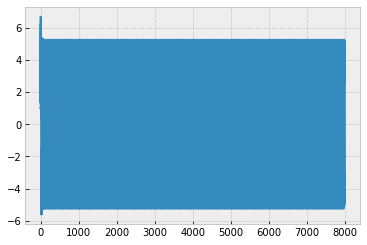

5.248166753979889


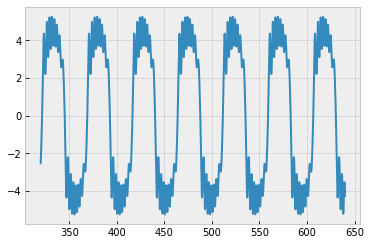

5.24820637159222


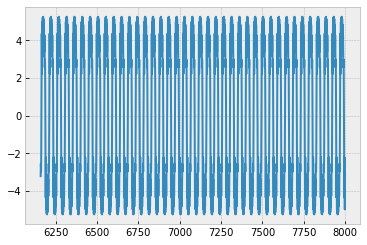

max in egs 5.248183074263787
finish this plot
Omega 0.13827655310621242


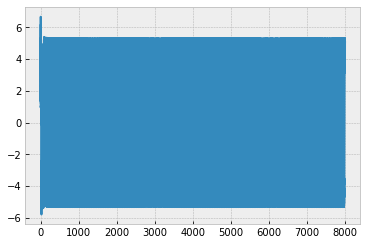

5.340000602103667


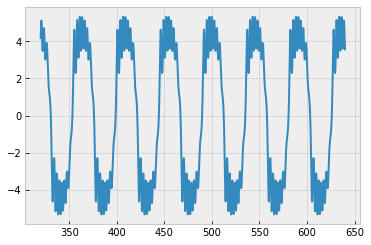

5.330646914979894


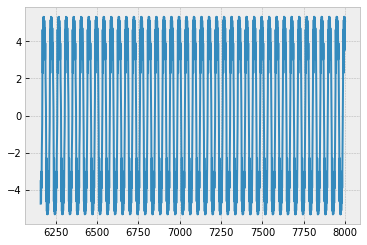

max in egs 5.330647207461663
finish this plot
Omega 0.14428857715430862


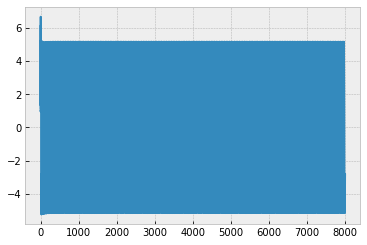

5.160865999977952


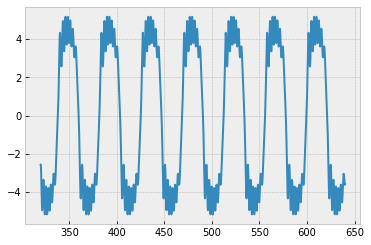

5.161026776300666


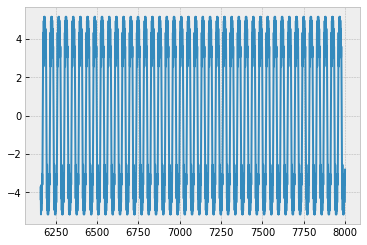

max in egs 5.161023995898841
finish this plot
Omega 0.15030060120240482


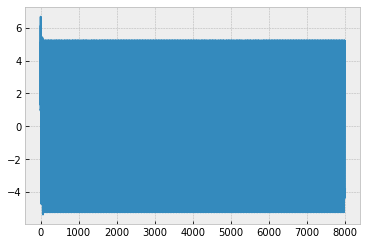

5.229864724457066


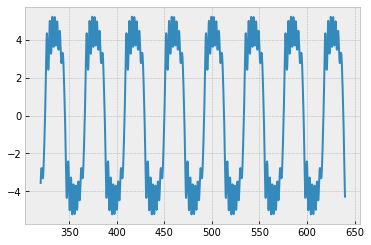

5.22990037728265


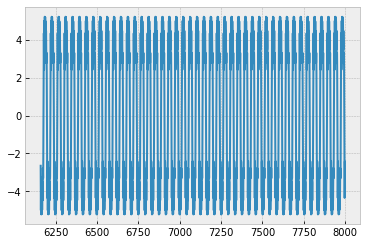

max in egs 5.229896503483788
finish this plot
Omega 0.156312625250501


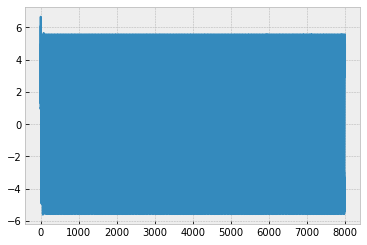

5.576958024591367


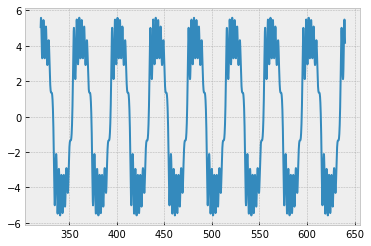

5.576953591852499


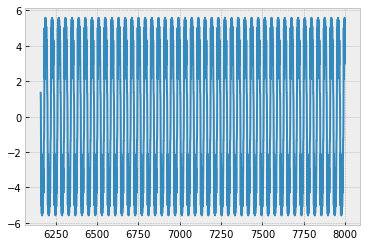

max in egs 5.5769409645105625
finish this plot
Omega 0.1623246492985972


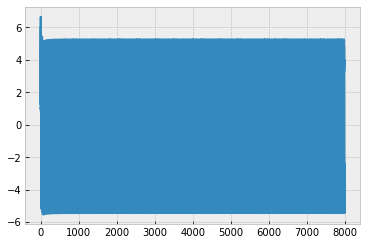

5.265668168711558


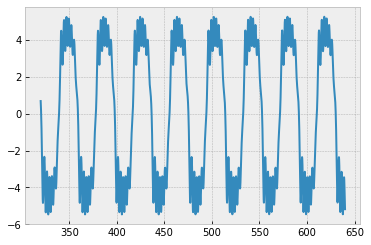

5.2710228588575365


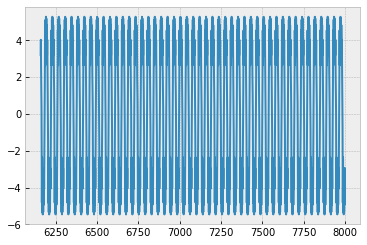

max in egs 5.362076460162623
finish this plot
Omega 0.1683366733466934


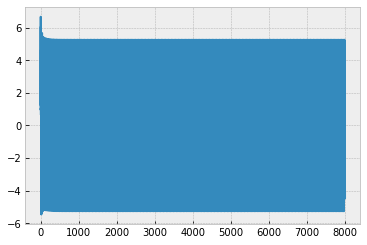

5.302746730268813


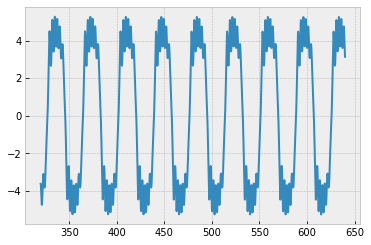

5.253837131363913


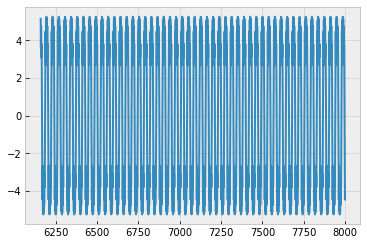

max in egs 5.2538356457493975
finish this plot
Omega 0.1743486973947896


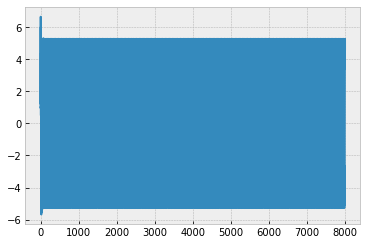

5.281399079322664


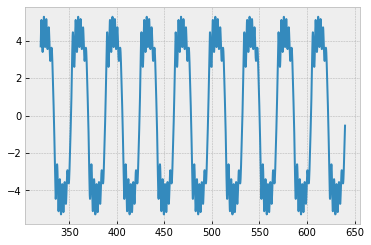

5.281403107579106


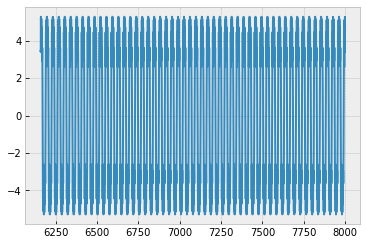

max in egs 5.281393906407557
finish this plot
Omega 0.18036072144288576


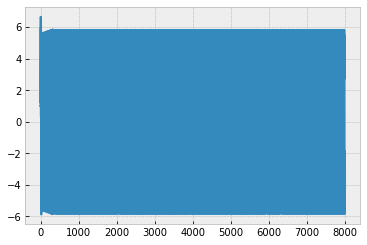

5.839554356189984


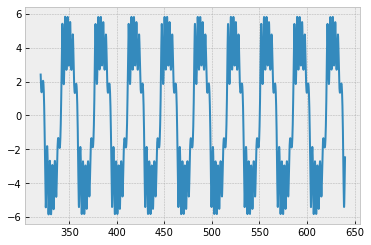

5.822008411252487


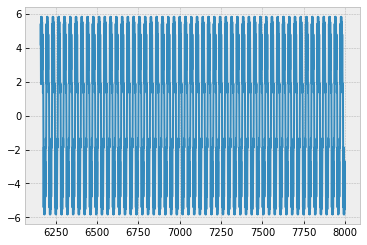

max in egs 5.82200592426679
finish this plot
Omega 0.18637274549098196


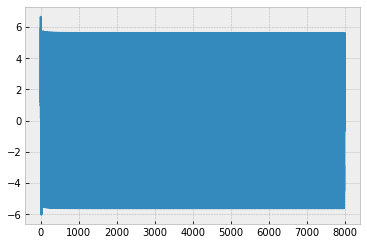

5.6562281675737855


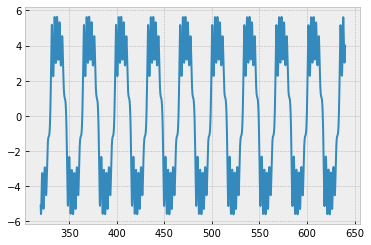

5.616733531005335


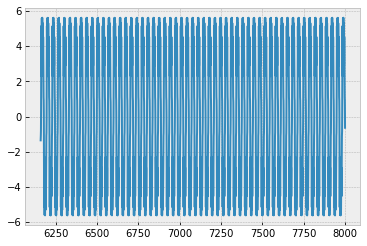

max in egs 5.616726784829453
finish this plot
Omega 0.19238476953907815


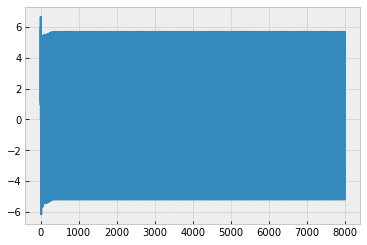

5.6763268298762695


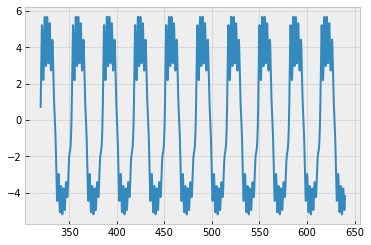

5.676328800044826


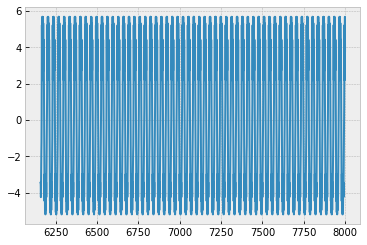

max in egs 5.433649311727325
finish this plot
Omega 0.19839679358717435


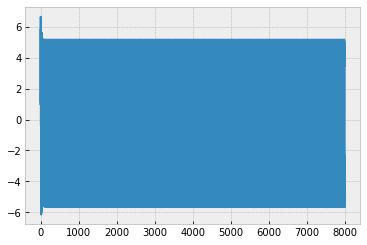

5.169205223581487


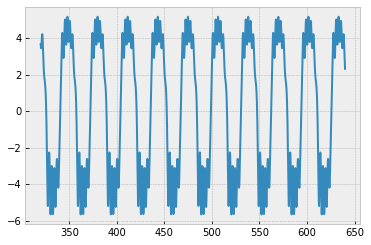

5.169175736895132


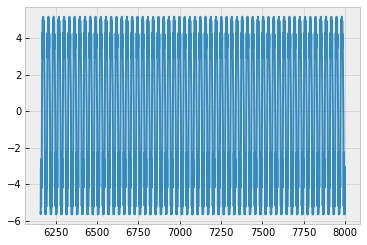

max in egs 5.4159704508636555
finish this plot
Omega 0.20440881763527055


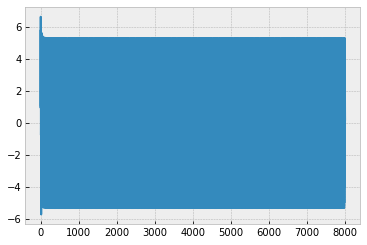

5.31606908311722


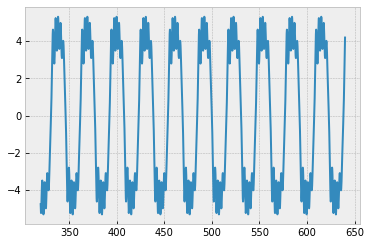

5.312177418756077


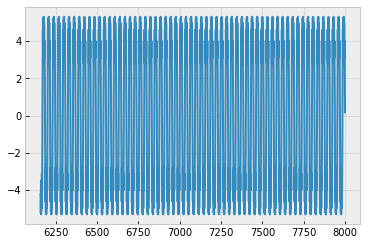

max in egs 5.312175648872955
finish this plot
Omega 0.21042084168336672


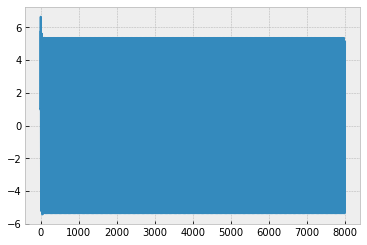

5.3498409657348285


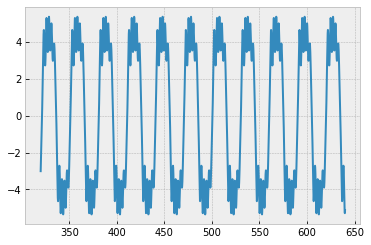

5.349943314572461


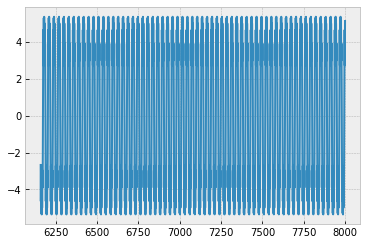

max in egs 5.34990889742219
finish this plot
Omega 0.21643286573146292


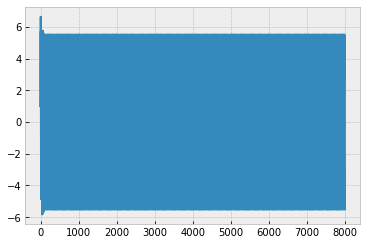

5.516657315520731


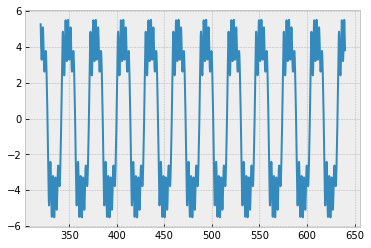

5.516648561974895


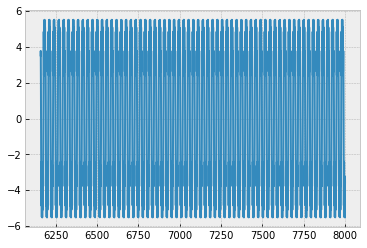

max in egs 5.516647669704353
finish this plot
Omega 0.22244488977955912


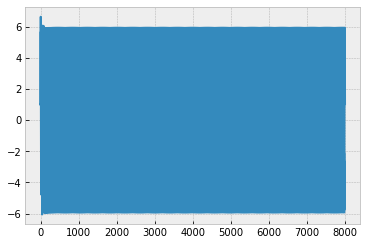

5.936304427002787


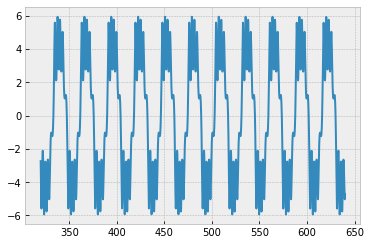

5.936443549504169


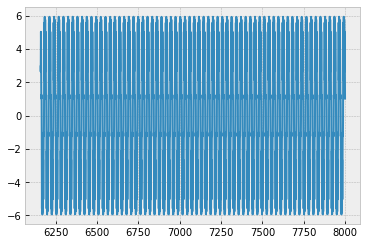

max in egs 5.936432036988884
finish this plot
Omega 0.22845691382765532


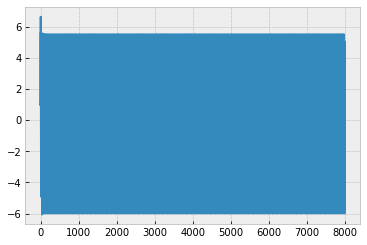

5.50081347959876


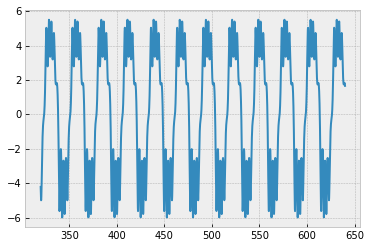

5.500733997134618


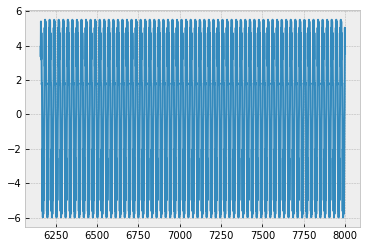

max in egs 5.744732989362171
finish this plot
Omega 0.2344689378757515


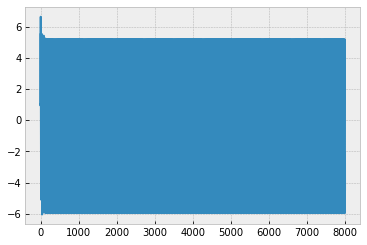

5.1937053952805785


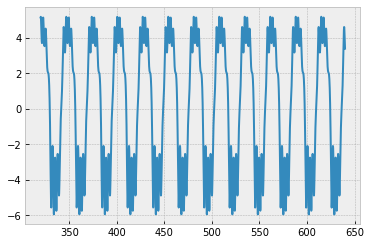

5.19243346237352


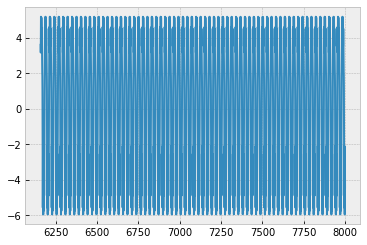

max in egs 5.573168096797021
finish this plot
Omega 0.24048096192384769


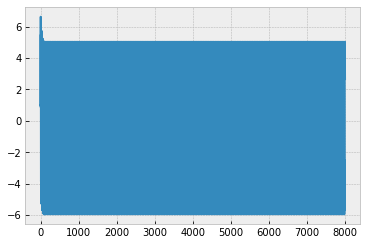

5.03312583188479


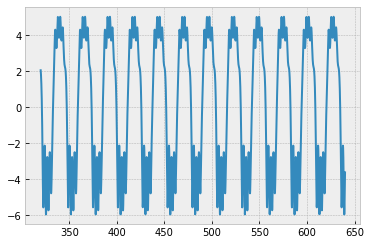

5.033127319451465


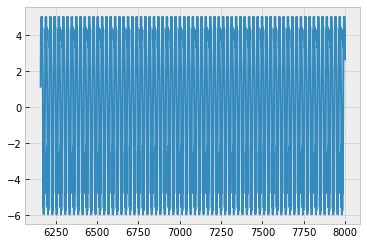

max in egs 5.491788863075335
finish this plot
Omega 0.24649298597194388


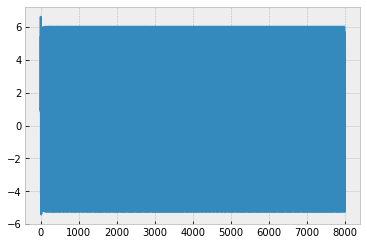

6.02180603615428


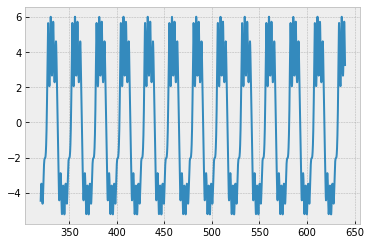

6.021802497126329


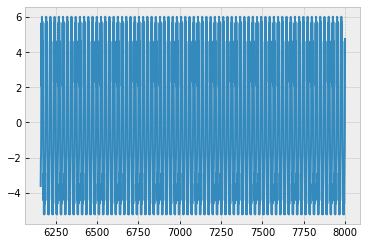

max in egs 5.630861920809986
finish this plot
Omega 0.25250501002004005


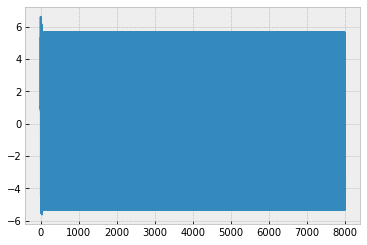

5.674770906705521


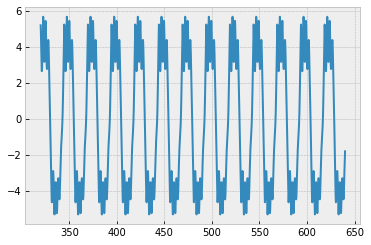

5.674778864714567


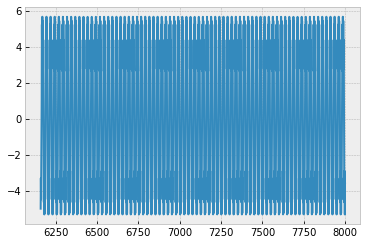

max in egs 5.502767006176024
finish this plot
Omega 0.25851703406813625


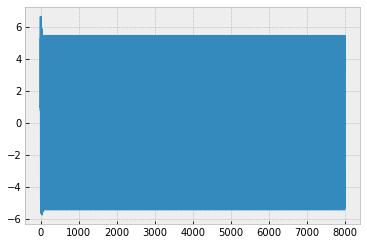

5.42350561036706


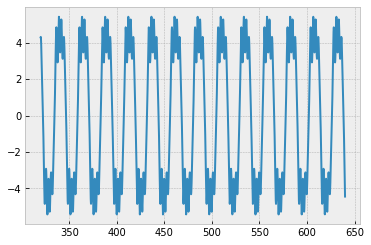

5.4235063108868635


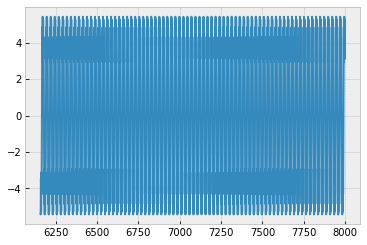

max in egs 5.423506043499977
finish this plot
Omega 0.26452905811623245


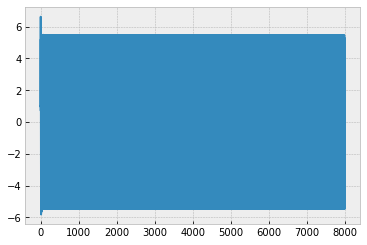

5.4627699791751425


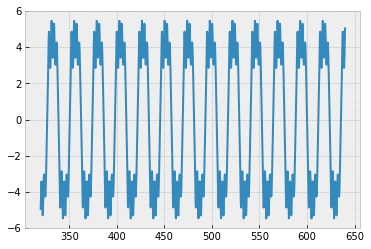

5.462805151812383


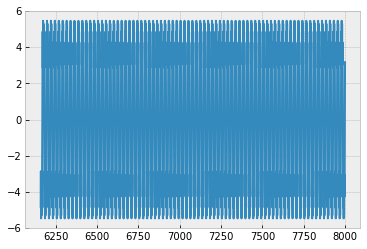

max in egs 5.46279951321843
finish this plot
Omega 0.27054108216432865


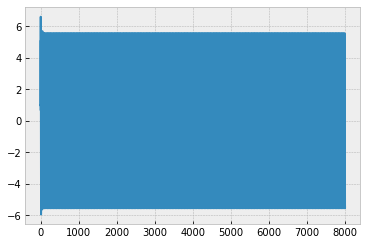

5.556542698309336


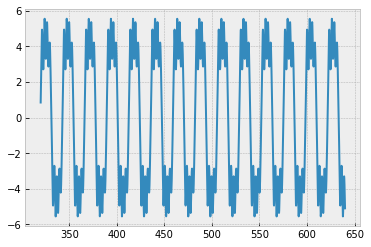

5.556423544129598


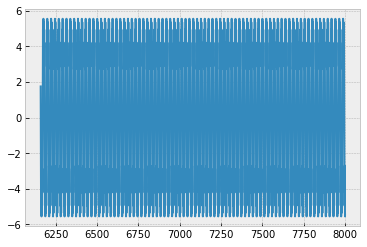

max in egs 5.55642122942088
finish this plot
Omega 0.27655310621242485


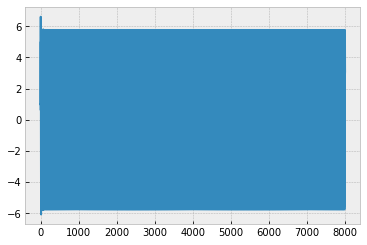

5.757598931518673


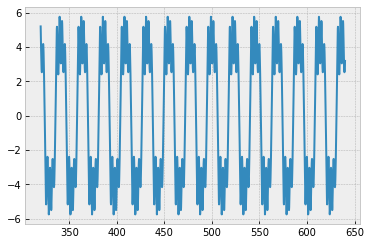

5.759730456230291


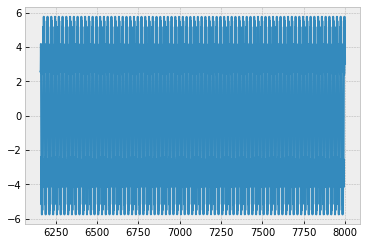

max in egs 5.7583446134971
finish this plot
Omega 0.28256513026052105


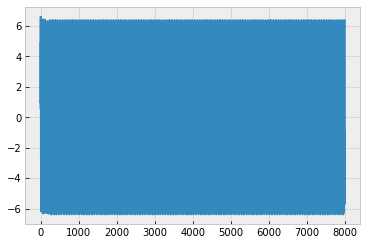

6.38726780503081


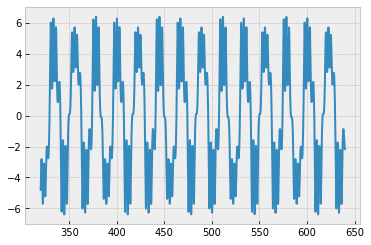

6.387430754719287


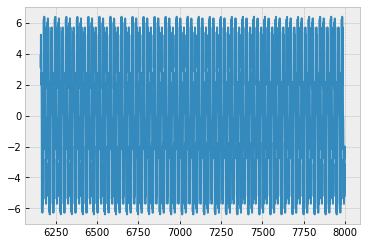

max in egs 6.387406280553503
finish this plot
Omega 0.28857715430861725


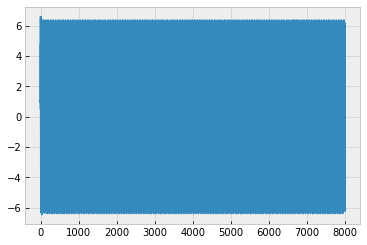

6.371424663144504


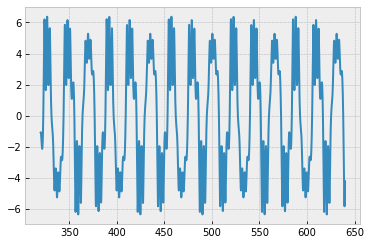

6.370360171107893


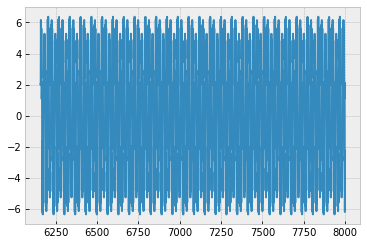

max in egs 6.3702504565430225
finish this plot
Omega 0.29458917835671344


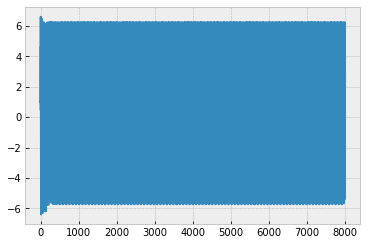

6.249506692057371


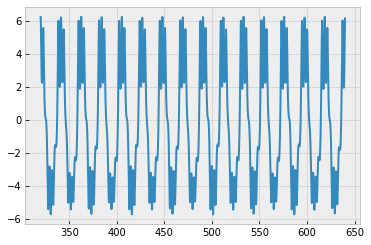

6.2414776978861175


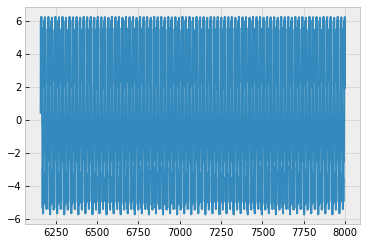

max in egs 5.984484973087543
finish this plot
Omega 0.30060120240480964


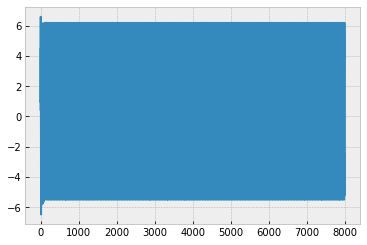

6.1896568084063635


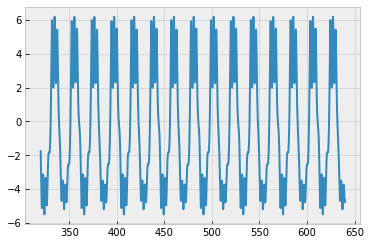

6.18965938722719


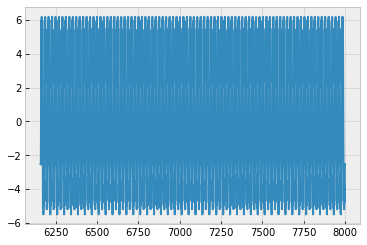

max in egs 5.846058696660624
finish this plot
Omega 0.3066132264529058


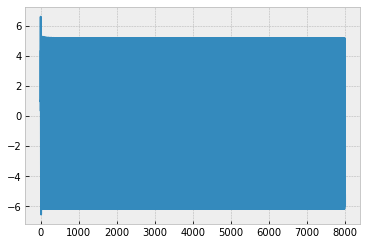

5.212208738129727


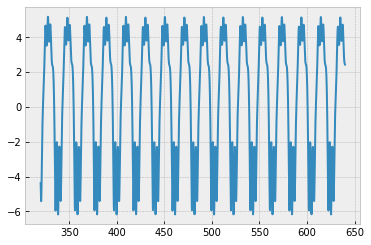

5.155905609626142


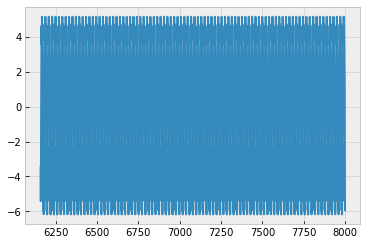

max in egs 5.6662406100846585
finish this plot
Omega 0.312625250501002


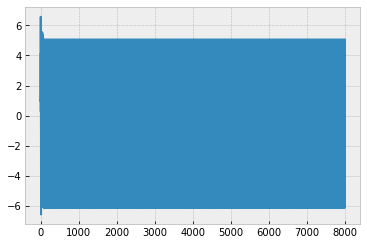

5.060551176089699


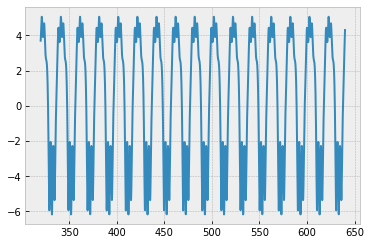

5.060532769029584


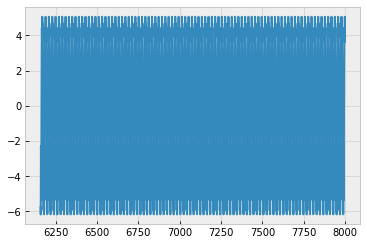

max in egs 5.614208063798684
finish this plot
Omega 0.3186372745490982


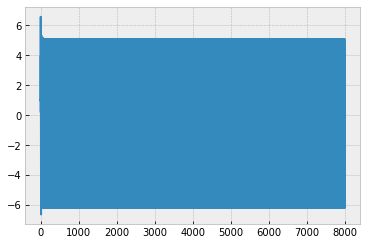

5.0943922139430855


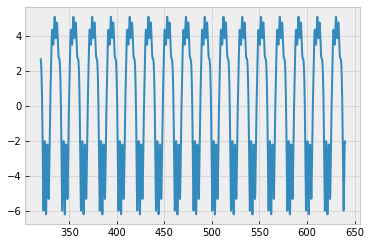

5.094431751193762


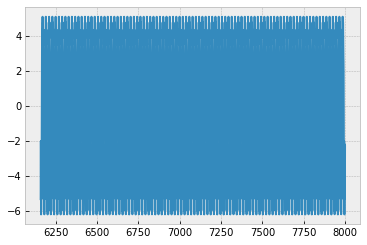

max in egs 5.64440762545842
finish this plot
Omega 0.3246492985971944


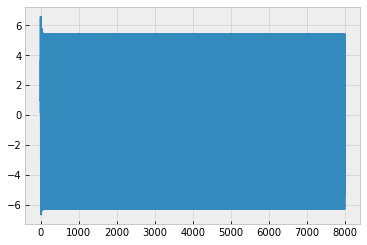

5.399022768929731


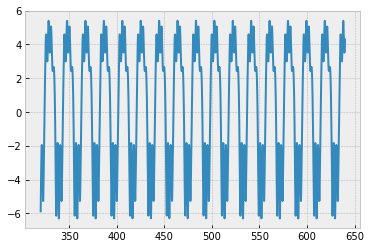

5.39901244323678


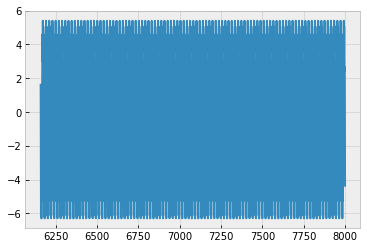

max in egs 5.845149431777015
finish this plot
Omega 0.3306613226452906


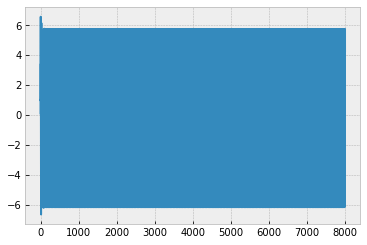

5.7499332197454445


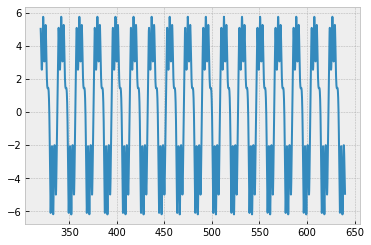

5.749931970572517


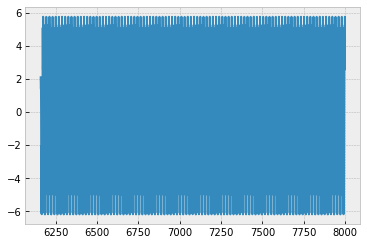

max in egs 5.965593270773969
finish this plot
Omega 0.3366733466933868


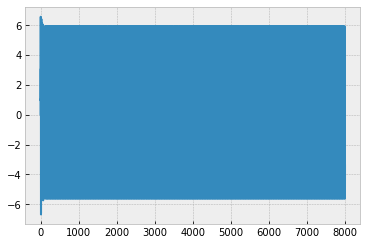

5.923568977092161


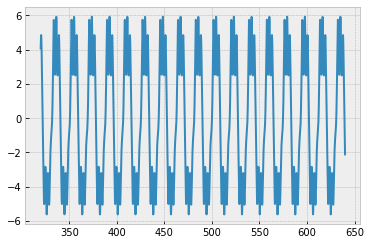

5.923595571027892


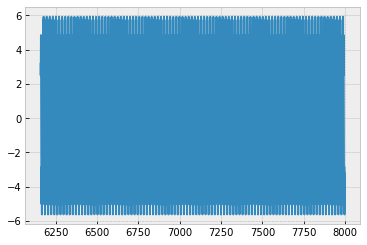

max in egs 5.77261687450322
finish this plot
Omega 0.342685370741483


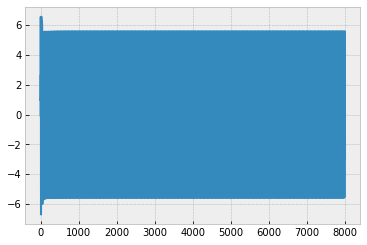

5.5725495238203795


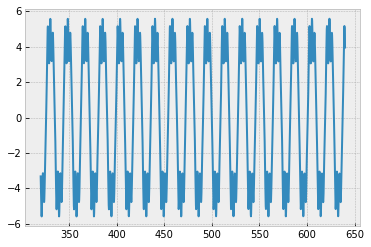

5.573614081140221


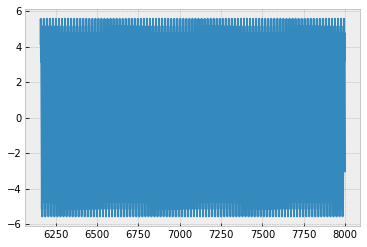

max in egs 5.573612226545046
finish this plot
Omega 0.3486973947895792


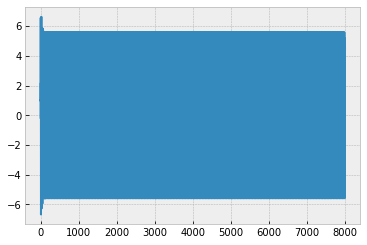

5.5833524995741595


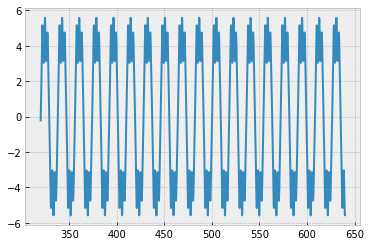

5.58313792985818


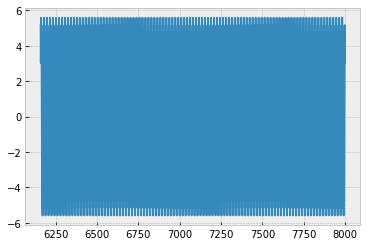

max in egs 5.583135866555111
finish this plot
Omega 0.35470941883767537


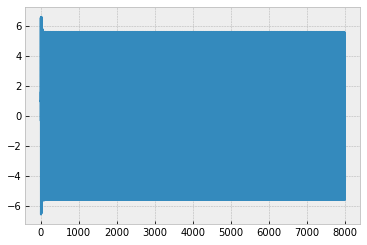

5.605901963697166


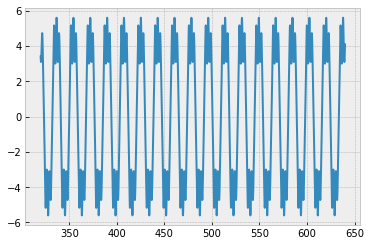

5.605901934532854


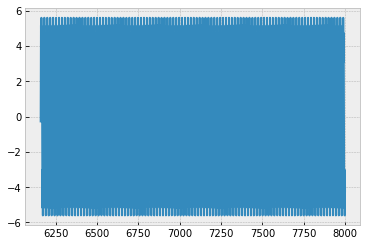

max in egs 5.605900015537728
finish this plot
Omega 0.3607214428857715


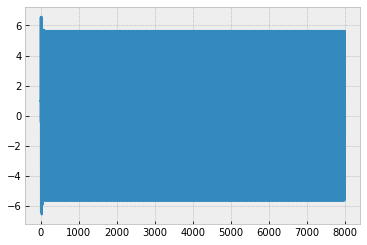

5.643125910473147


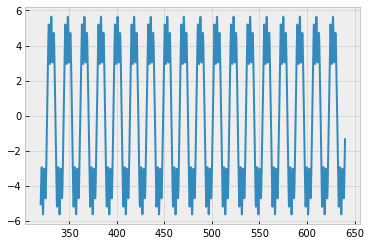

5.643123336157852


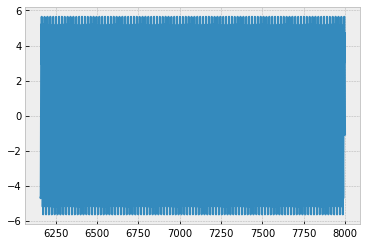

max in egs 5.6431194004910115
finish this plot
Omega 0.3667334669338677


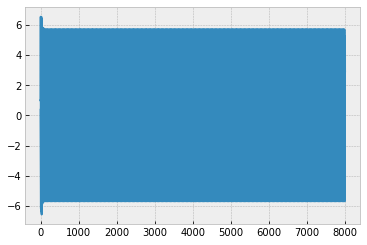

5.69723819009139


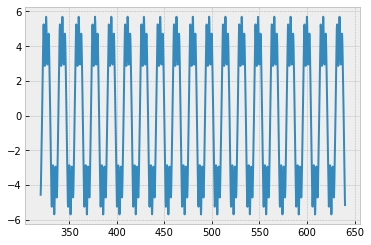

5.6972430037988895


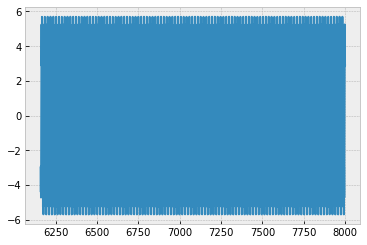

max in egs 5.697241848016323
finish this plot
Omega 0.3727454909819639


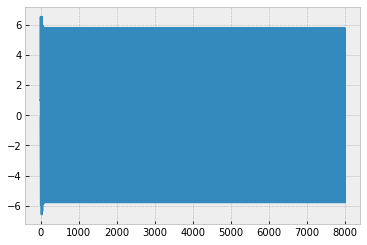

5.7730732672357306


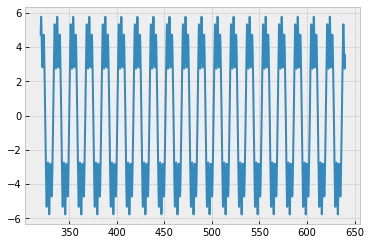

5.773076979170874


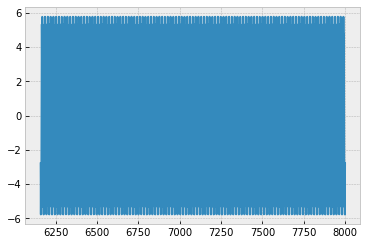

max in egs 5.773076396204095
finish this plot
Omega 0.3787575150300601


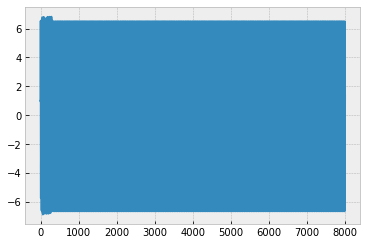

6.818664659684132


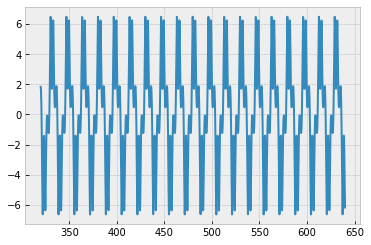

6.488080065367458


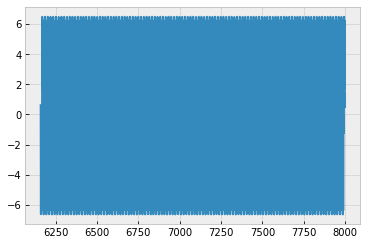

max in egs 6.562350708361133
finish this plot
Omega 0.3847695390781563


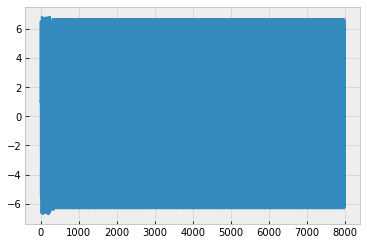

6.838286106101846


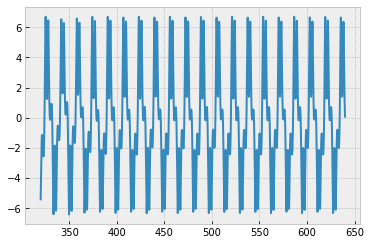

6.691748030419706


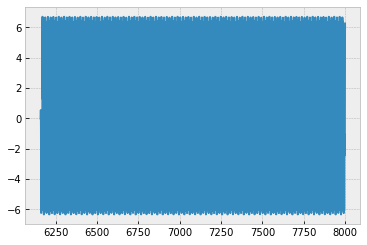

max in egs 6.507957763335014
finish this plot
Omega 0.3907815631262525


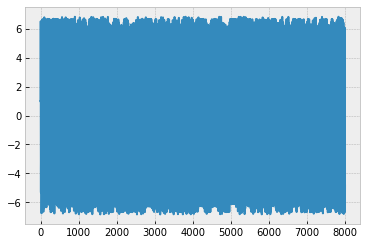

6.805366790571048


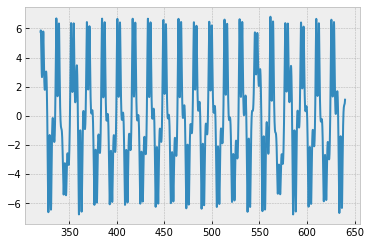

6.828731928604031


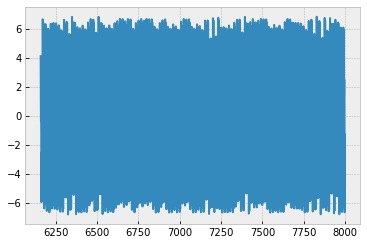

max in egs 6.81624145108831
finish this plot
Omega 0.3967935871743487


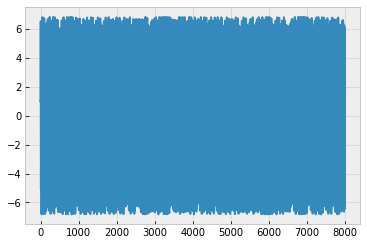

6.817755803346814


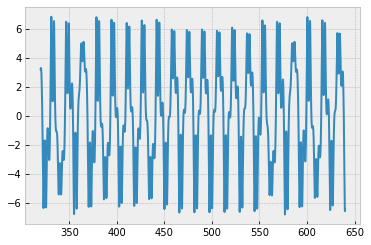

6.825309422907095


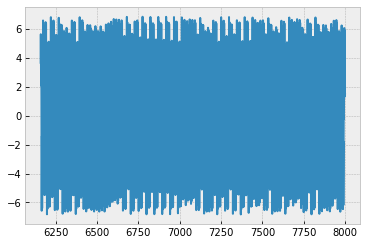

max in egs 6.814618972704805
finish this plot
Omega 0.4028056112224449


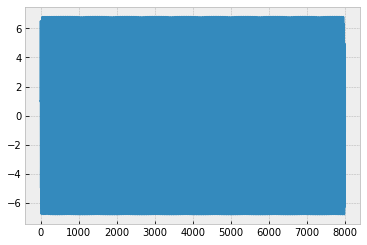

6.8033548091305045


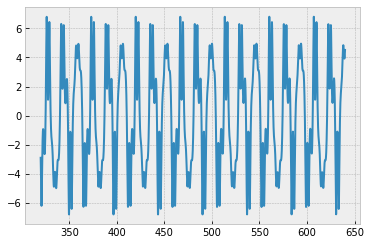

6.802855738966807


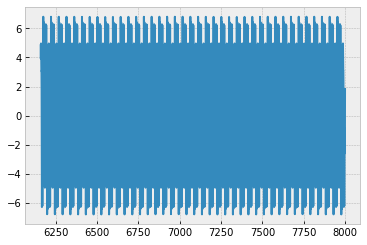

max in egs 6.802856451506797
finish this plot
Omega 0.4088176352705411


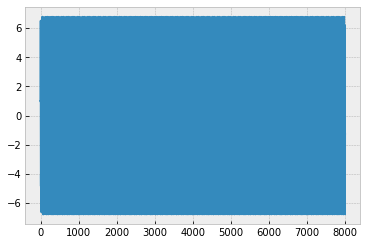

6.774317916713617


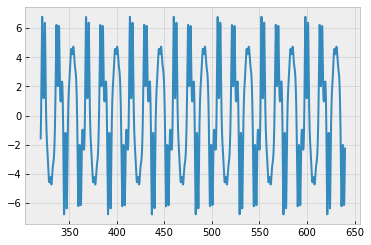

6.774852233034943


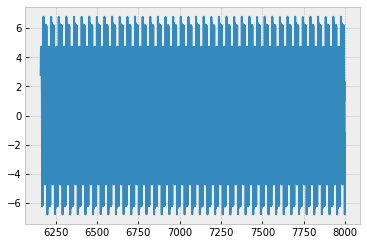

max in egs 6.774437021900898
finish this plot
Omega 0.41482965931863724


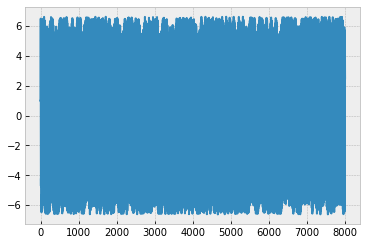

6.608059178272856


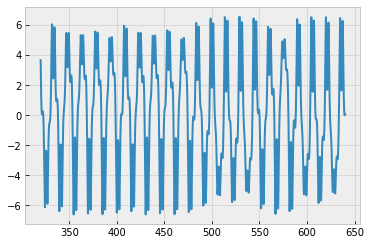

6.627817390642521


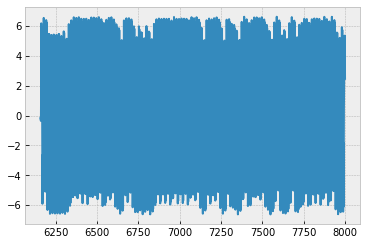

max in egs 6.622913716168511
finish this plot
Omega 0.42084168336673344


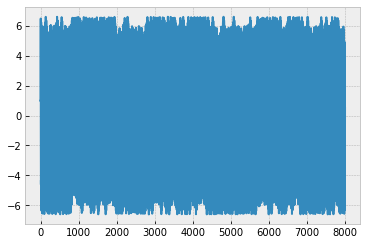

6.612945996957827


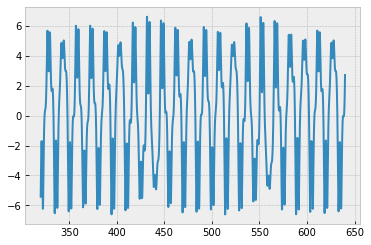

6.614664615378599


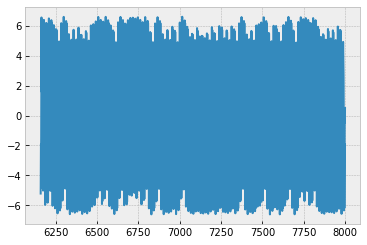

max in egs 6.604473991774133
finish this plot
Omega 0.42685370741482964


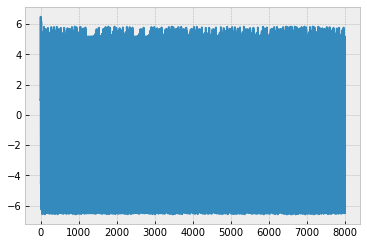

5.818218178840081


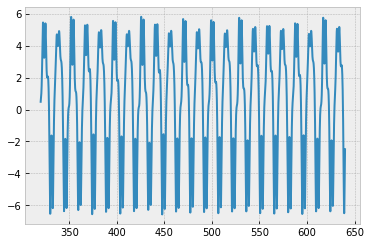

5.833800676570434


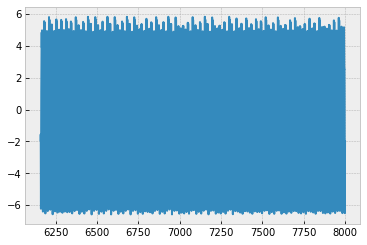

max in egs 6.200286444630368
finish this plot
Omega 0.43286573146292584


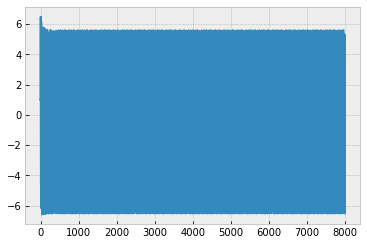

5.6224901723736815


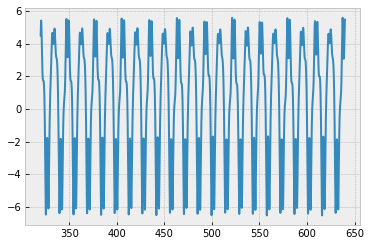

5.601691929007038


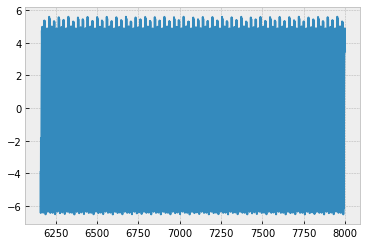

max in egs 6.062235149252644
finish this plot
Omega 0.43887775551102204


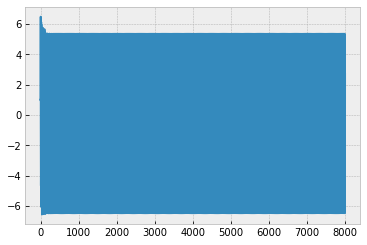

5.368843444303312


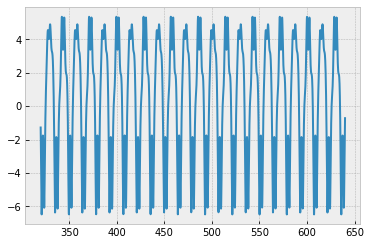

5.353302938747653


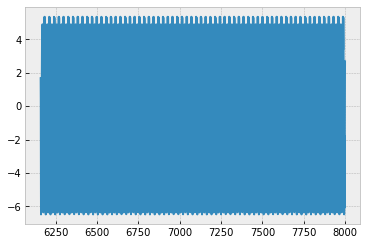

max in egs 5.9202273034189705
finish this plot
Omega 0.44488977955911824


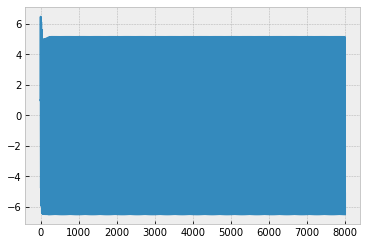

5.151954231491704


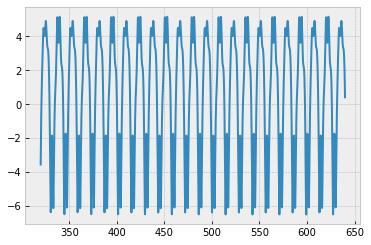

5.151723462269484


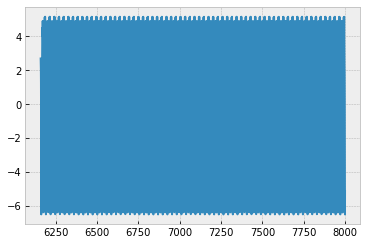

max in egs 5.8235405729669925
finish this plot
Omega 0.45090180360721444


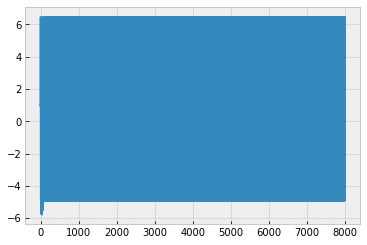

6.456217400998871


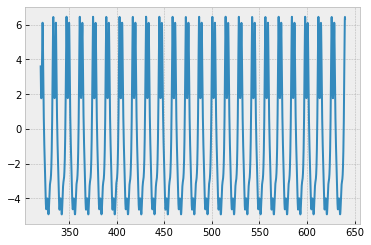

6.452990709085376


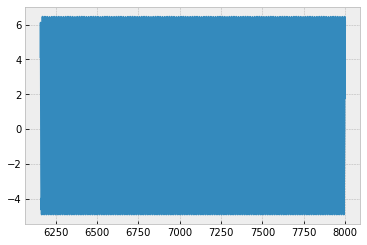

max in egs 5.683120361545829
finish this plot
Omega 0.45691382765531063


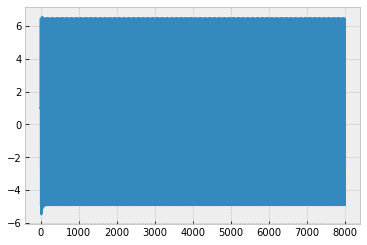

6.462173781138888


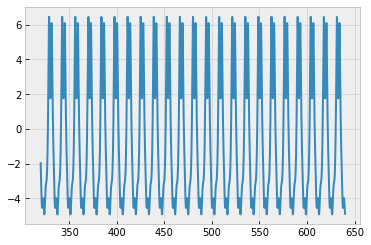

6.462173371003895


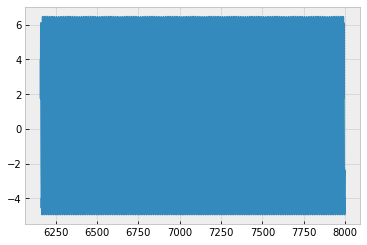

max in egs 5.693405820280033
finish this plot
Omega 0.46292585170340683


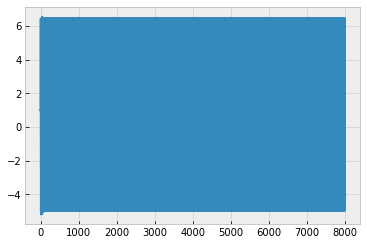

6.484101821627183


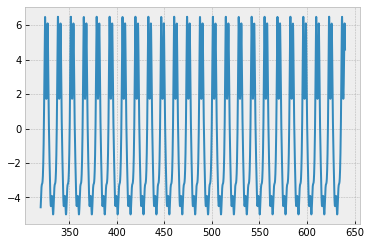

6.484120040245092


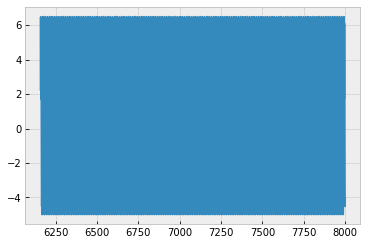

max in egs 5.733317967647932
finish this plot
Omega 0.468937875751503


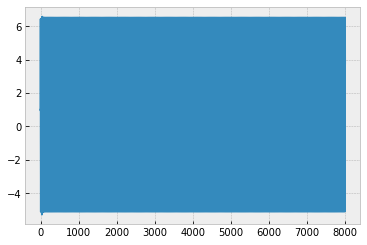

6.5224227300953395


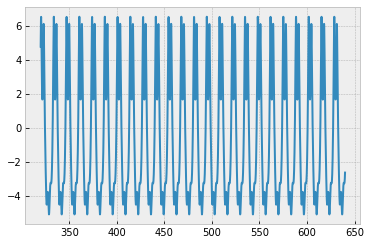

6.522438248990374


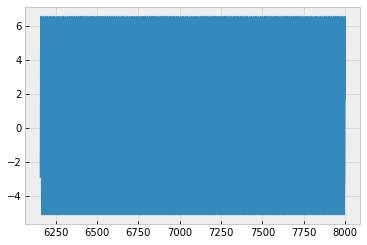

max in egs 5.805950172951213
finish this plot
Omega 0.4749498997995992


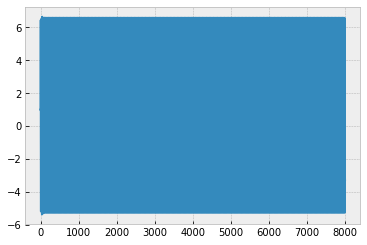

6.5841469454432815


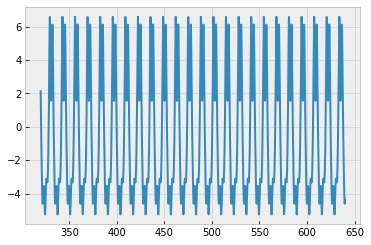

6.584218183915722


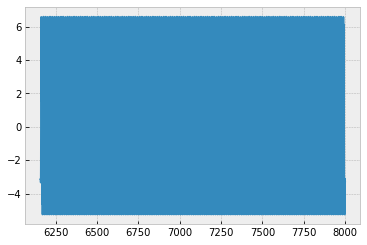

max in egs 5.916993869304765
finish this plot
Omega 0.48096192384769537


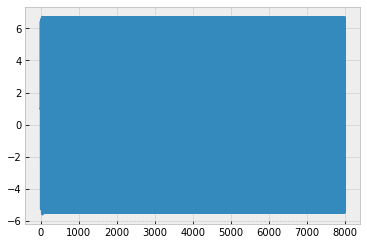

6.69030970940301


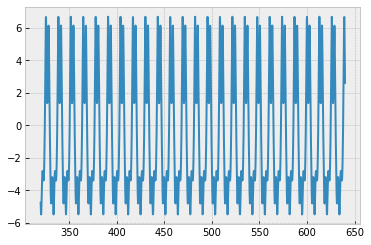

6.690309487682036


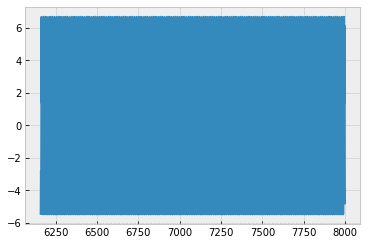

max in egs 6.091707523384516
finish this plot
Omega 0.48697394789579157


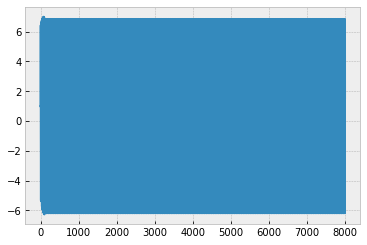

6.852539990629617


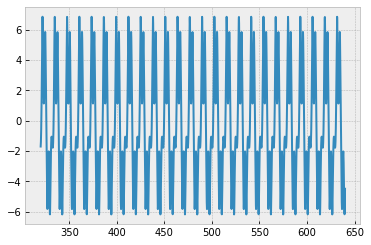

6.8514083942546335


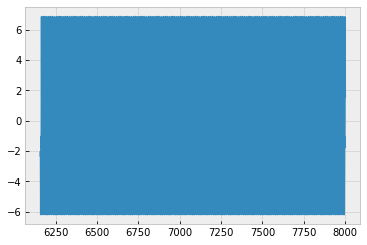

max in egs 6.516349867445697
finish this plot
Omega 0.49298597194388777


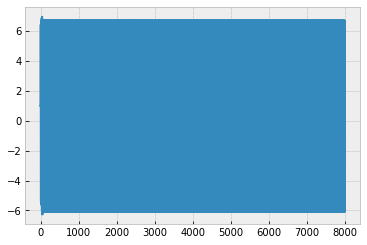

6.698690834638929


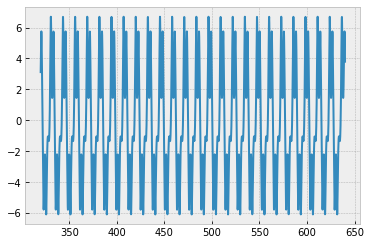

6.698695439551905


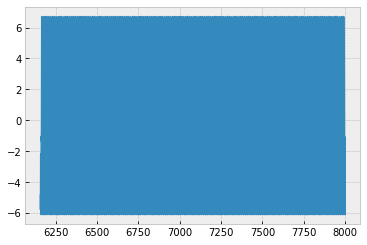

max in egs 6.392173020913952
finish this plot
Omega 0.49899799599198397


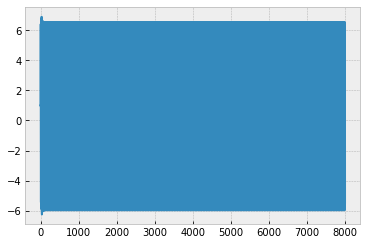

6.54628636658319


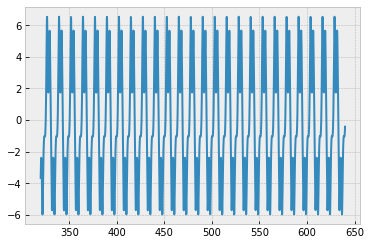

6.546184800173821


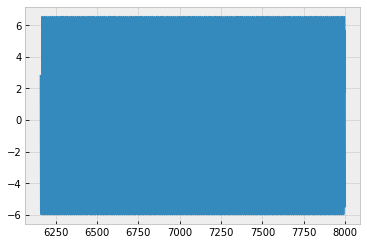

max in egs 6.2624247461035125
finish this plot
Omega 0.5050100200400801


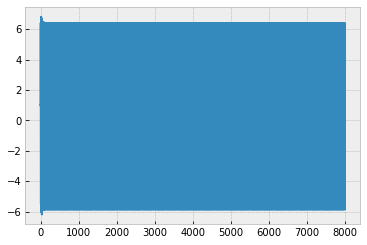

6.382492475665435


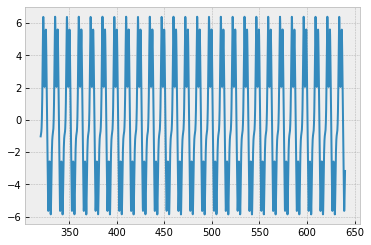

6.382503164274296


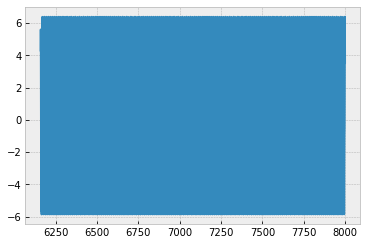

max in egs 6.120929582158384
finish this plot
Omega 0.5110220440881763


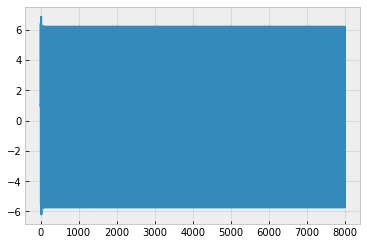

6.196088164633342


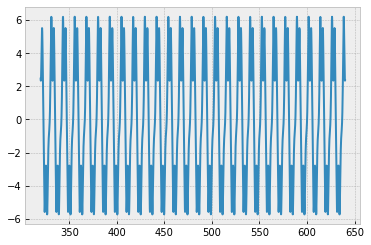

6.196097721132025


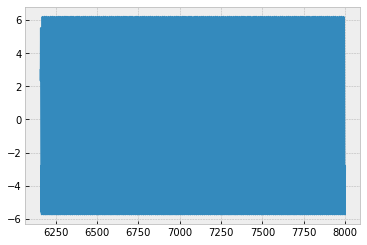

max in egs 5.96010247351519
finish this plot
Omega 0.5170340681362725


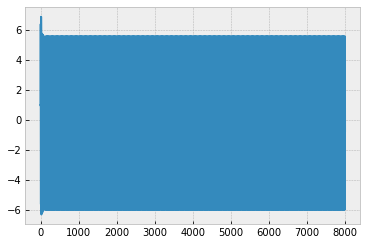

5.565239037585824


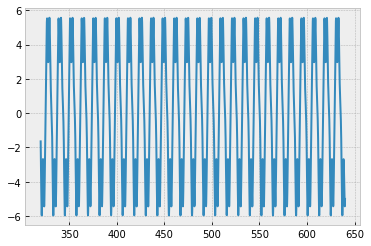

5.564965052971155


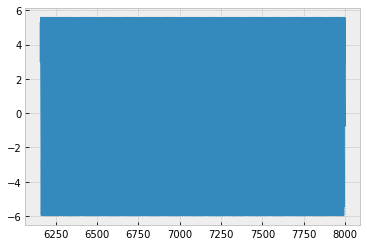

max in egs 5.76335622085272
finish this plot
Omega 0.5230460921843687


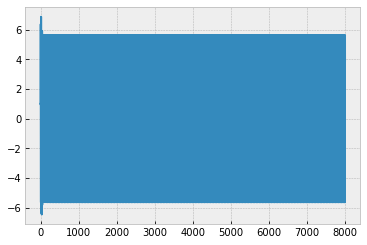

5.644324977891839


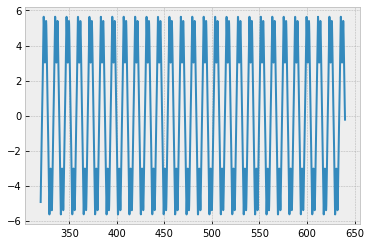

5.641328989804382


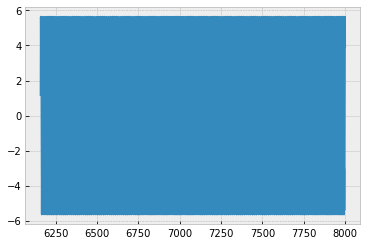

max in egs 5.64132740744451
finish this plot
Omega 0.5290581162324649


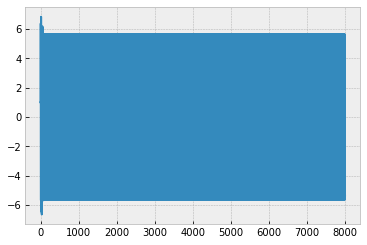

5.645974483976747


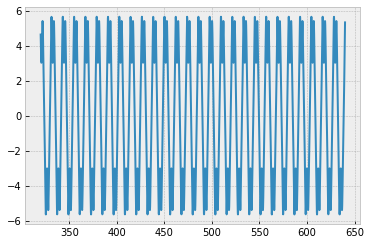

5.645538783429407


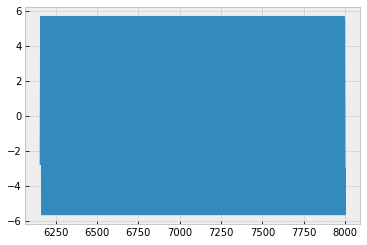

max in egs 5.6455375617297765
finish this plot
Omega 0.5350701402805611


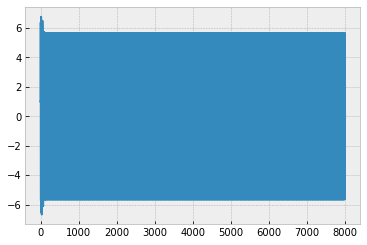

5.652797440647025


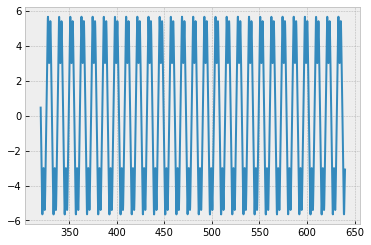

5.652739258073532


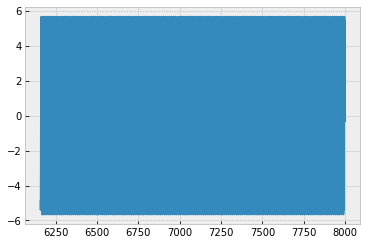

max in egs 5.6527391591341445
finish this plot
Omega 0.5410821643286573


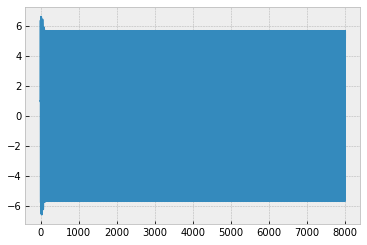

5.663002258159321


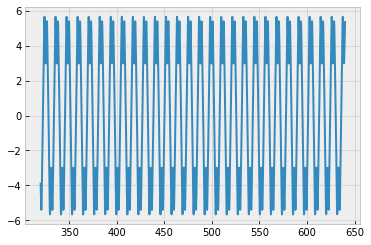

5.662923599095095


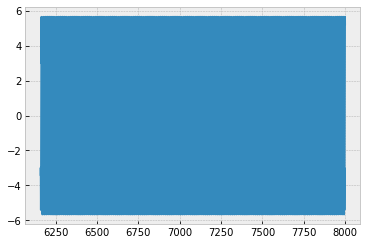

max in egs 5.662921304270805
finish this plot
Omega 0.5470941883767535


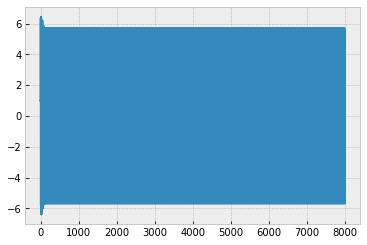

5.676101913279187


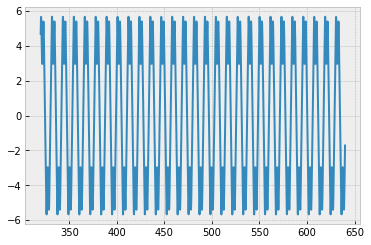

5.676108064795724


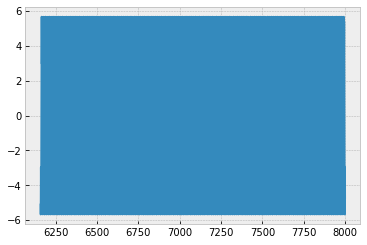

max in egs 5.676102742845897
finish this plot
Omega 0.5531062124248497


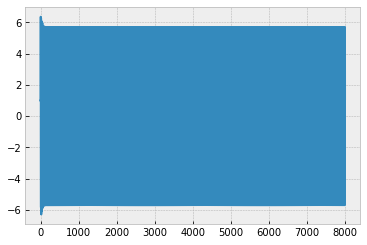

5.691785254123085


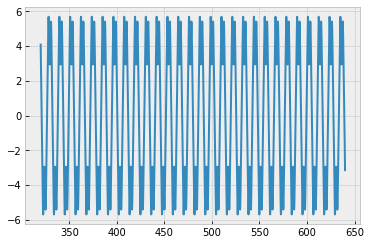

5.692335298916184


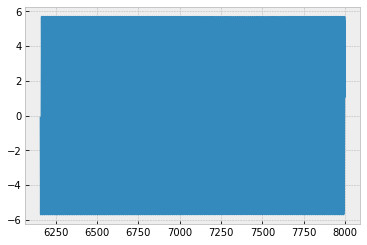

max in egs 5.688983915262046
finish this plot
Omega 0.5591182364729459


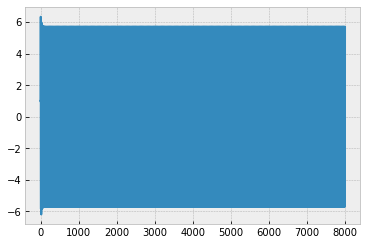

5.711856515731024


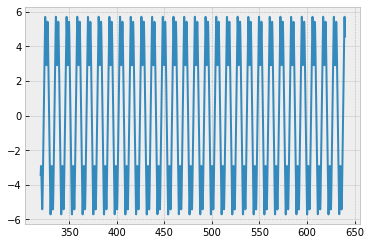

5.711675833014732


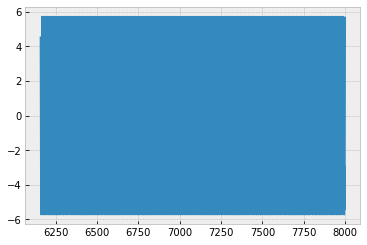

max in egs 5.711675365659716
finish this plot
Omega 0.5651302605210421


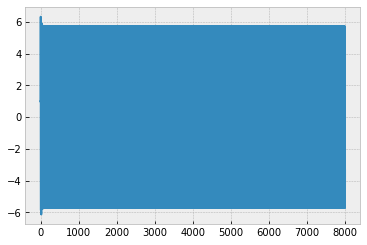

5.734235249982343


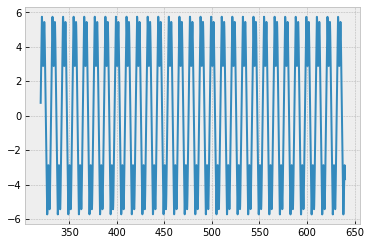

5.7342351480834575


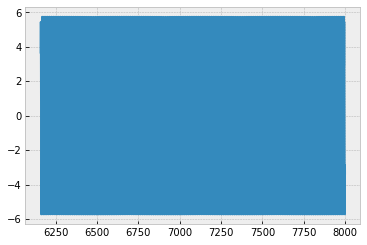

max in egs 5.734233533567606
finish this plot
Omega 0.5711422845691383


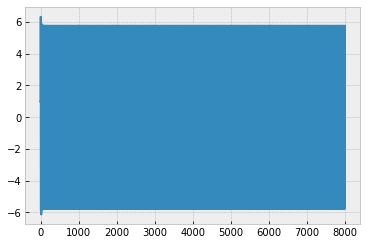

5.760150692511092


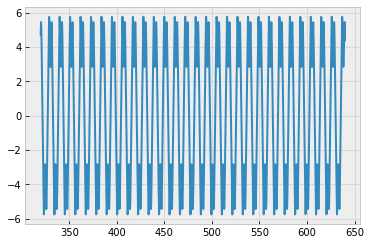

5.760152269745504


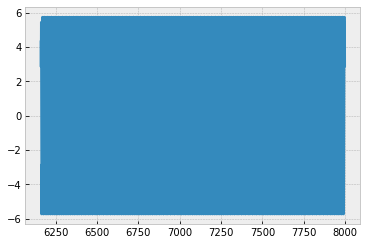

max in egs 5.760152291622703
finish this plot
Omega 0.5771543086172345


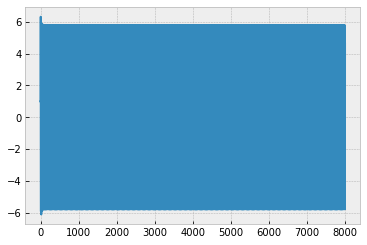

5.789628297527633


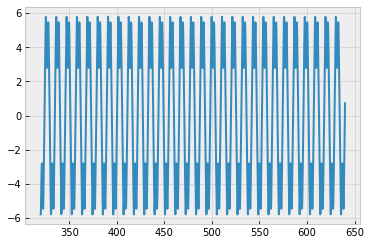

5.78962874305324


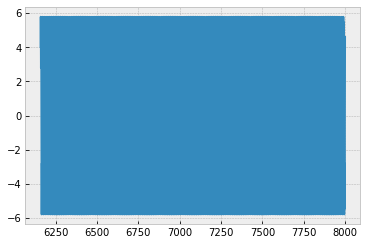

max in egs 5.789628670661946
finish this plot
Omega 0.5831663326653307


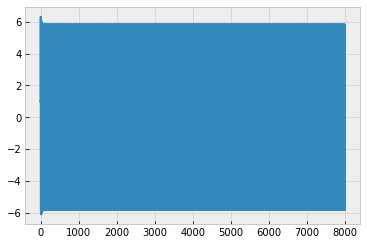

5.822903303638649


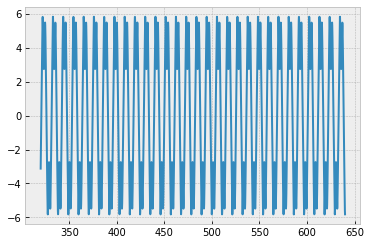

5.822903559026538


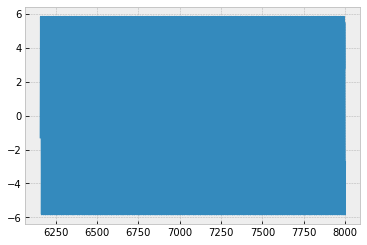

max in egs 5.822902512137713
finish this plot
Omega 0.5891783567134269


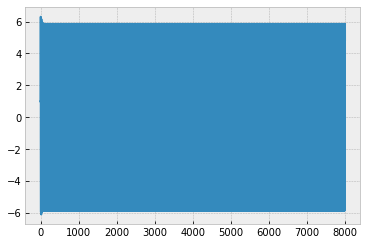

5.860305182882638


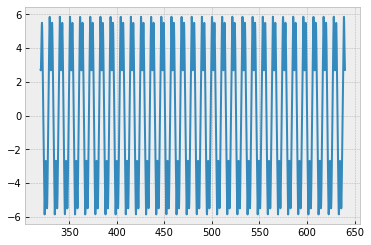

5.860306069284114


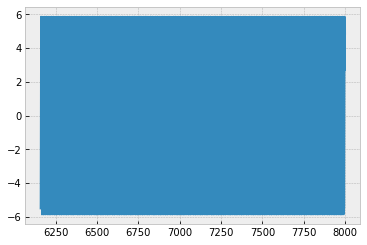

max in egs 5.860305479195796
finish this plot
Omega 0.5951903807615231


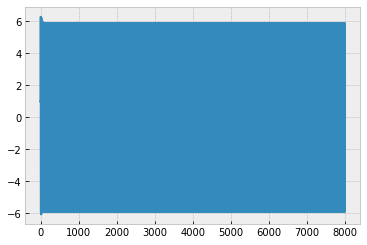

5.902252586856034


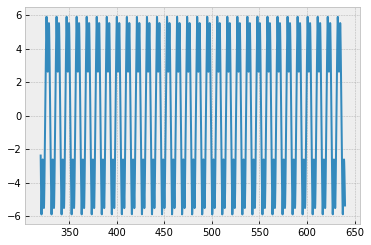

5.90226376349353


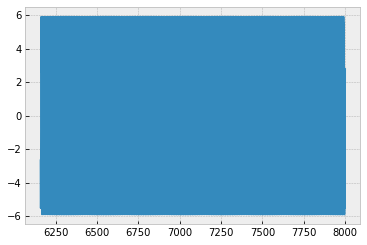

max in egs 5.902263418374353
finish this plot
Omega 0.6012024048096193


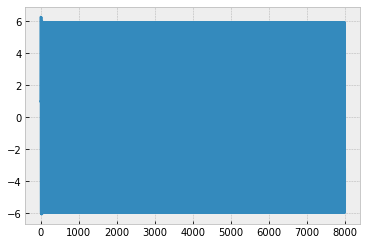

5.949364417962136


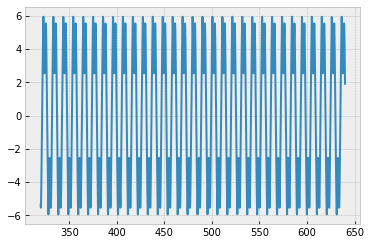

5.949346473638111


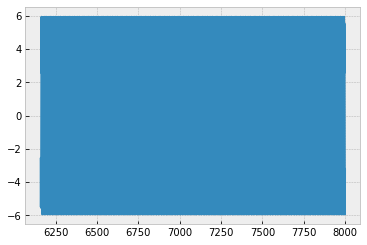

max in egs 5.9493337876847985
finish this plot
Omega 0.6072144288577154


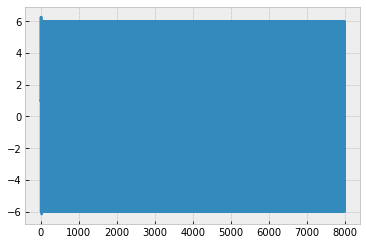

6.0023265577553335


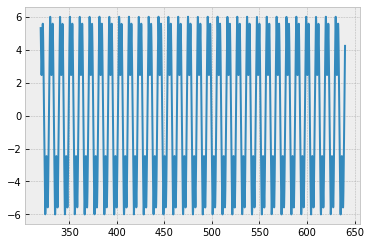

6.002332390553514


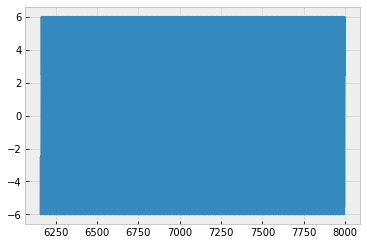

max in egs 6.002331872164534
finish this plot
Omega 0.6132264529058116


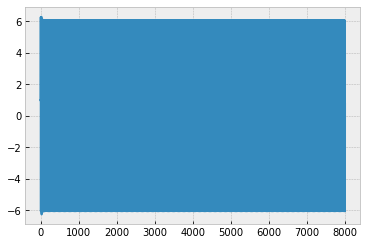

6.0623217022031195


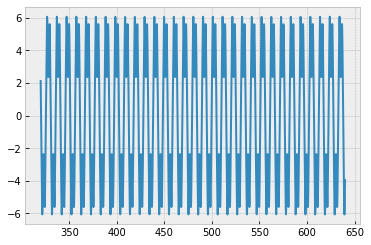

6.062321658926619


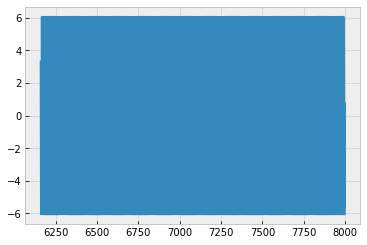

max in egs 6.062318354343455
finish this plot
Omega 0.6192384769539078


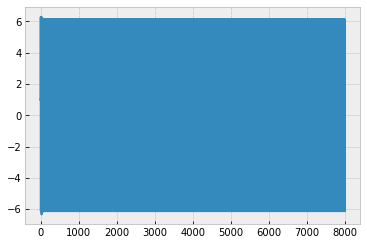

6.130951920966456


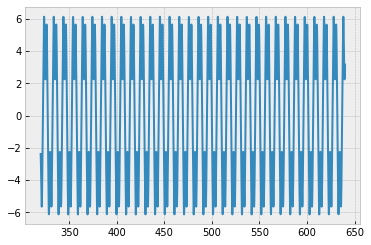

6.130952202252411


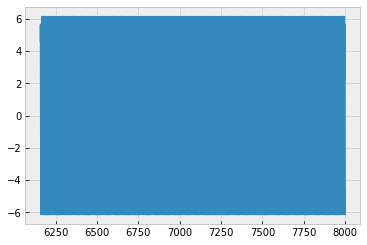

max in egs 6.130944973917673
finish this plot
Omega 0.625250501002004


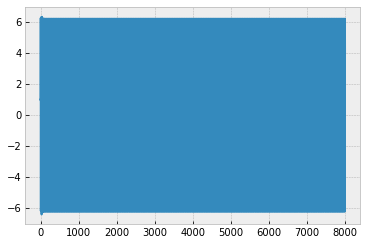

6.210844287165686


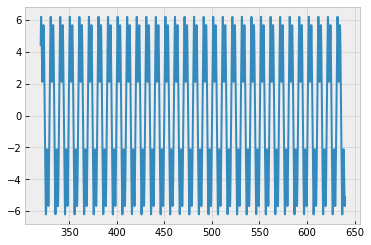

6.210845801637718


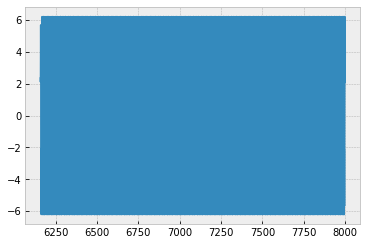

max in egs 6.2108451680714865
finish this plot
Omega 0.6312625250501002


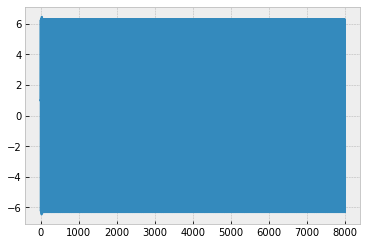

6.306703750347235


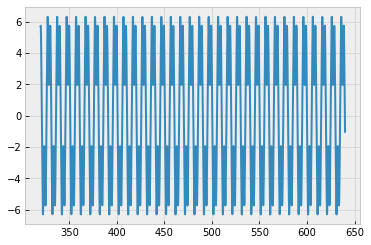

6.306704187121492


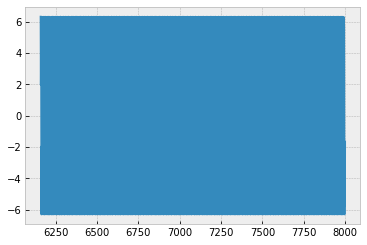

max in egs 6.306698632750411
finish this plot
Omega 0.6372745490981964


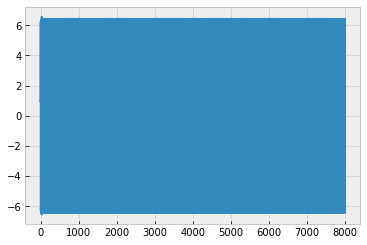

6.42878040029426


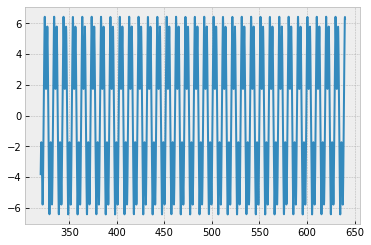

6.428782207868242


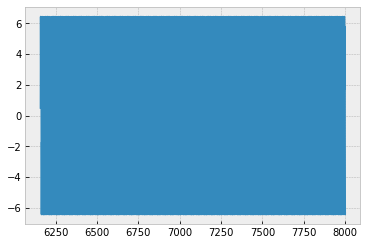

max in egs 6.4287812435913905
finish this plot
Omega 0.6432865731462926


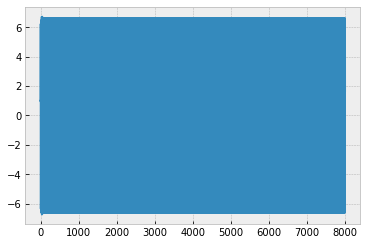

6.612359025780571


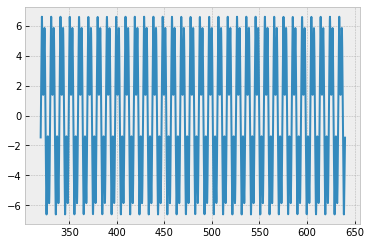

6.6123600142120225


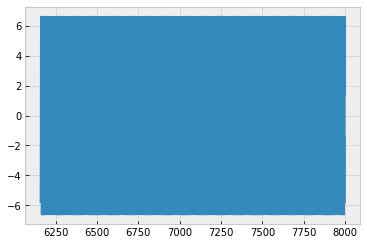

max in egs 6.612359919277154
finish this plot
Omega 0.6492985971943888


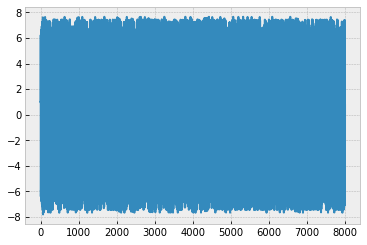

7.6469714841329095


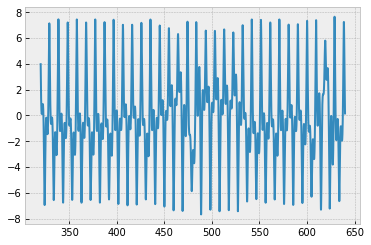

7.6585711977470226


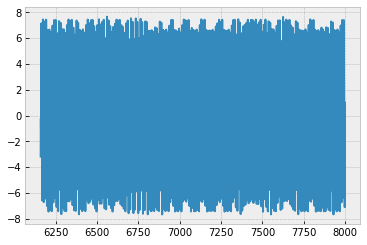

max in egs 7.648636686248201
finish this plot
Omega 0.655310621242485


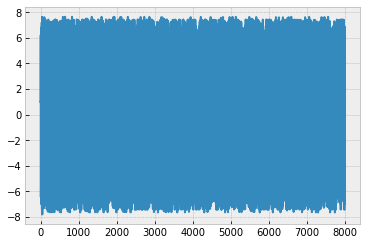

7.640769861526374


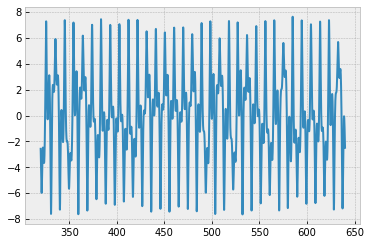

7.64711586021761


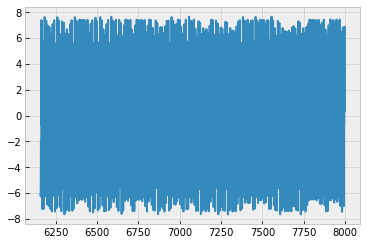

max in egs 7.648672580766302
finish this plot
Omega 0.6613226452905812


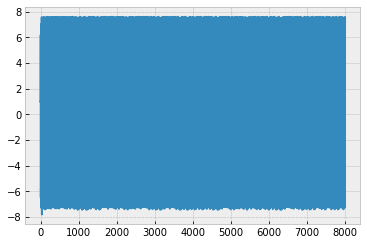

7.609701655797225


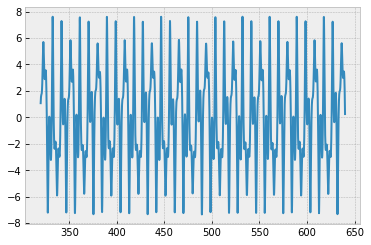

7.618605731379403


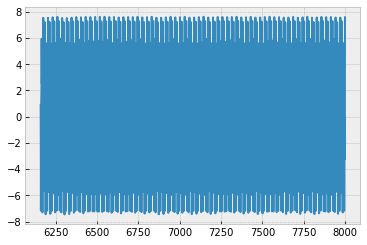

max in egs 7.519271327697513
finish this plot
Omega 0.6673346693386774


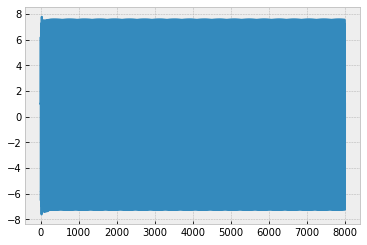

7.577927493595861


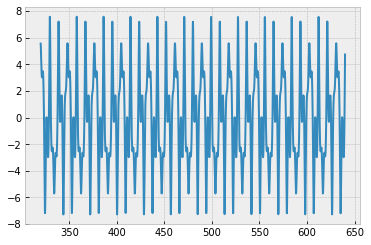

7.578051948281553


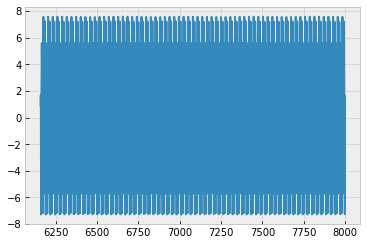

max in egs 7.4269702725479085
finish this plot
Omega 0.6733466933867736


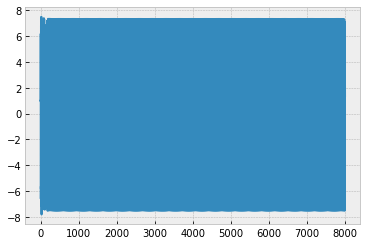

7.35042202177036


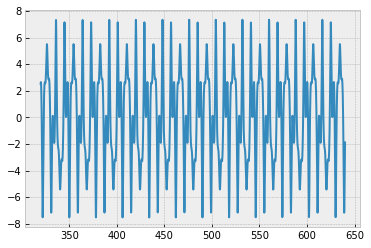

7.3401763942434215


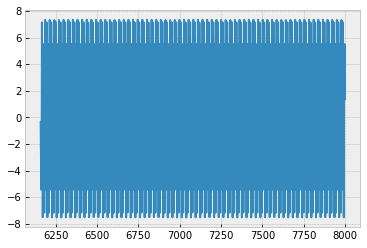

max in egs 7.428435495012673
finish this plot
Omega 0.6793587174348698


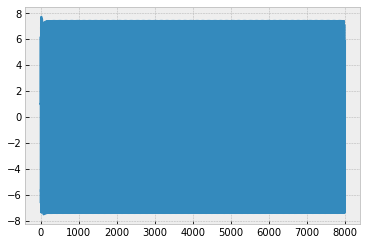

7.414715887344817


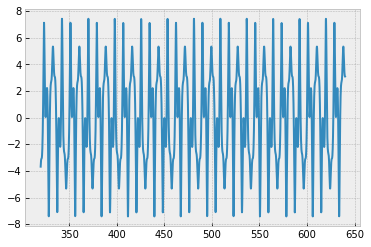

7.4150847063803225


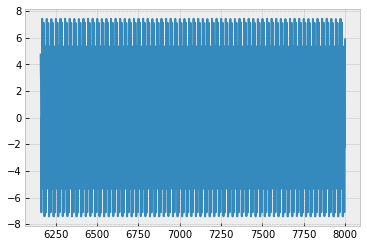

max in egs 7.4150669082862795
finish this plot
Omega 0.685370741482966


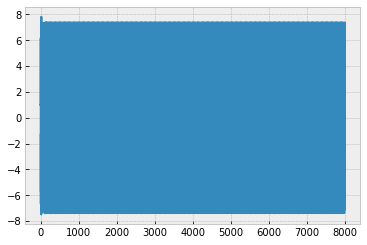

7.38968267932457


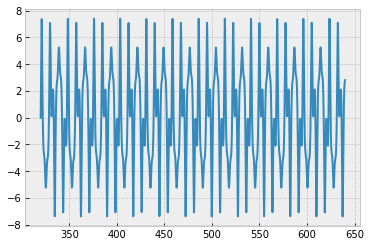

7.389820643673642


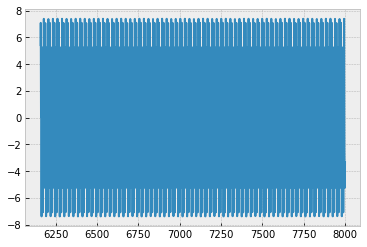

max in egs 7.389824213157497
finish this plot
Omega 0.6913827655310621


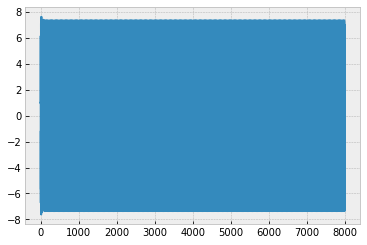

7.366695943222437


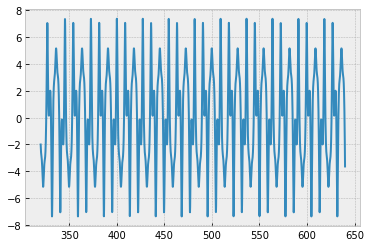

7.36686890744922


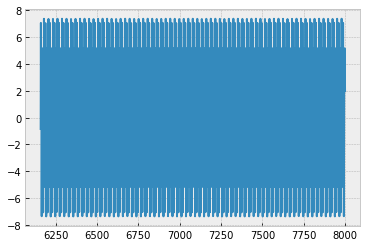

max in egs 7.366864186860232
finish this plot
Omega 0.6973947895791583


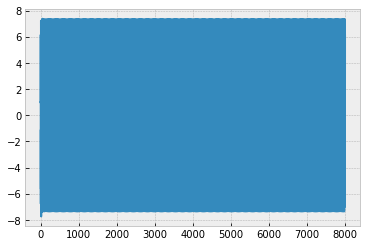

7.346287437647563


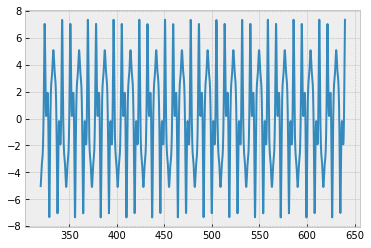

7.346338538791423


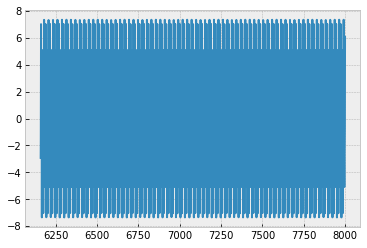

max in egs 7.346329490685271
finish this plot
Omega 0.7034068136272545


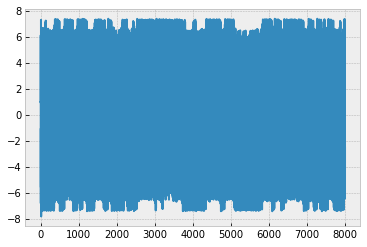

7.386957247609556


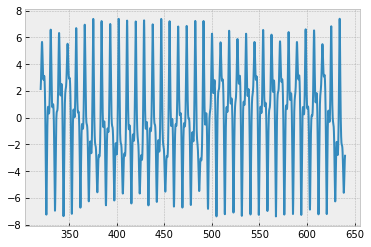

7.413535834912307


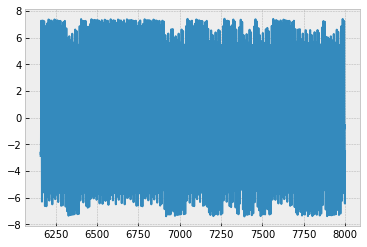

max in egs 7.410082930657626
finish this plot
Omega 0.7094188376753507


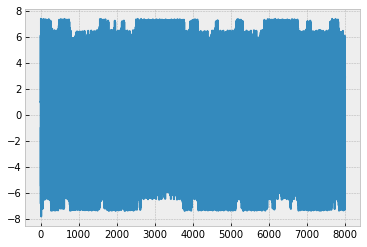

7.40106797551321


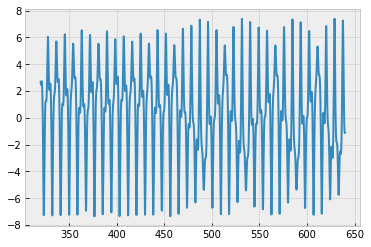

7.406560128427626


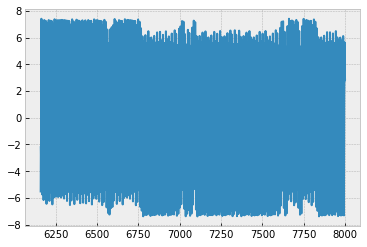

max in egs 7.394338120333773
finish this plot
Omega 0.7154308617234468


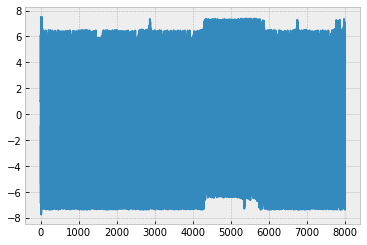

6.491416527990178


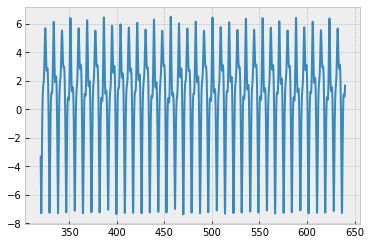

7.381188398196129


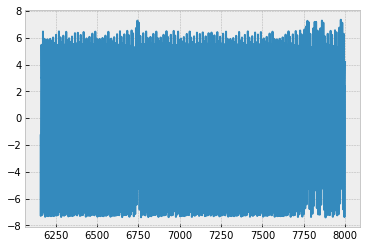

max in egs 7.372790850402909
finish this plot
Omega 0.721442885771543


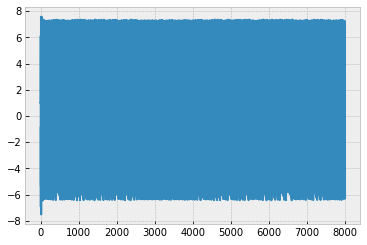

7.34627578148647


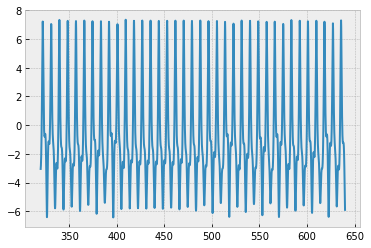

7.357607468384175


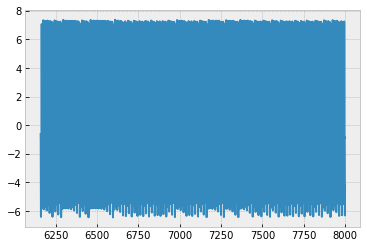

max in egs 6.882465312391033
finish this plot
Omega 0.7274549098196392


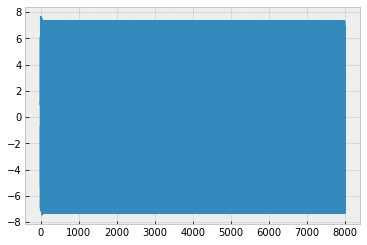

7.323198335805701


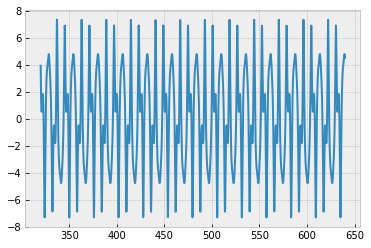

7.3232006830279746


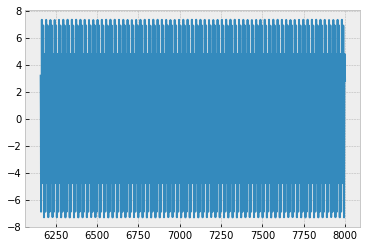

max in egs 7.323178397523798
finish this plot
Omega 0.7334669338677354


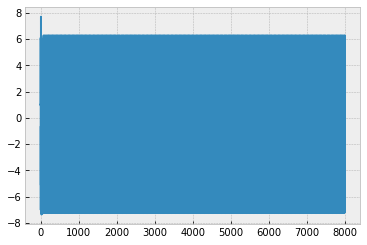

6.280952631085114


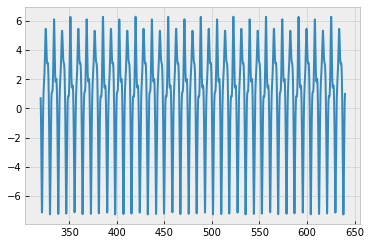

6.28090579711709


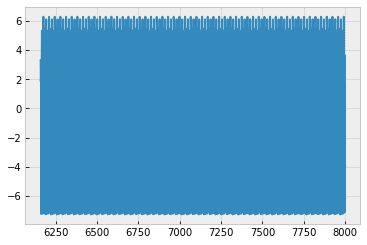

max in egs 6.766749825950981
finish this plot
Omega 0.7394789579158316


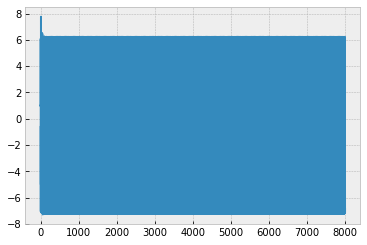

6.2334958340650415


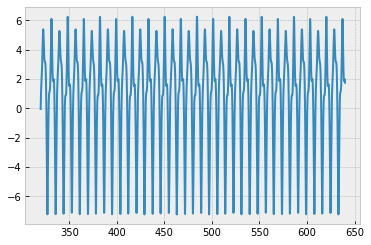

6.23363279321986


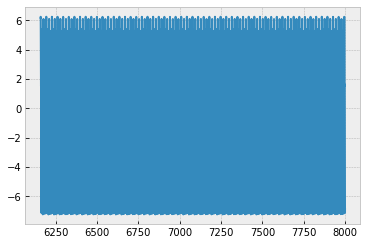

max in egs 6.73335348441649
finish this plot
Omega 0.7454909819639278


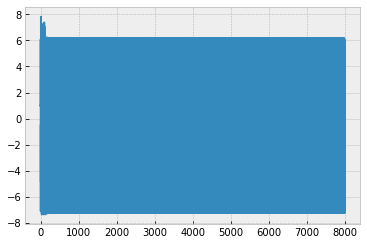

6.226857020668255


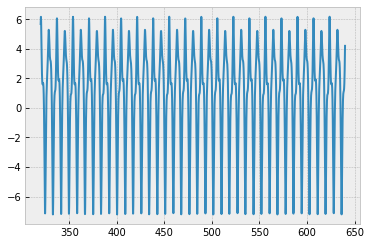

6.181343607892255


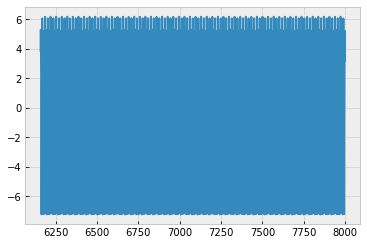

max in egs 6.697760665171055
finish this plot
Omega 0.751503006012024


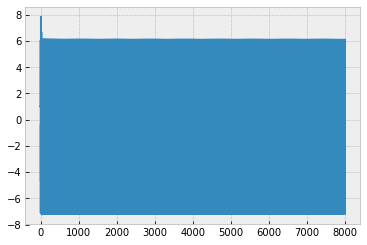

6.122876643976953


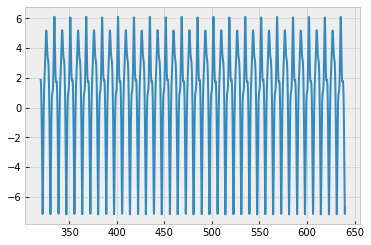

6.105461083429074


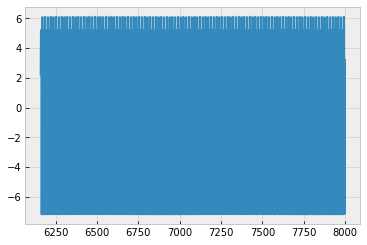

max in egs 6.647426951101333
finish this plot
Omega 0.7575150300601202


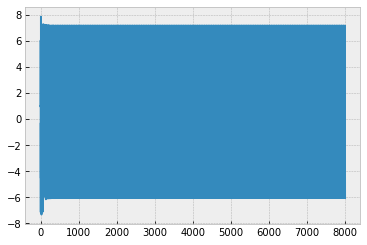

7.193038476241792


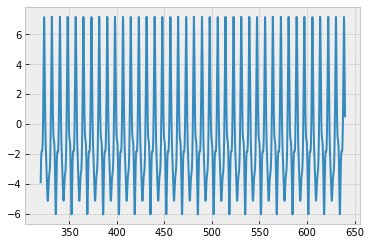

7.177327522169376


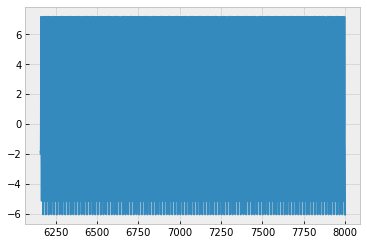

max in egs 6.614898633525755
finish this plot
Omega 0.7635270541082164


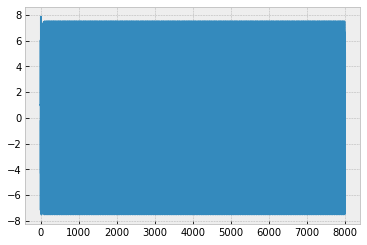

7.504579011591297


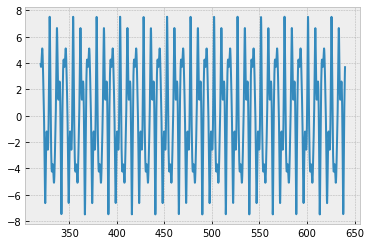

7.504589934992083


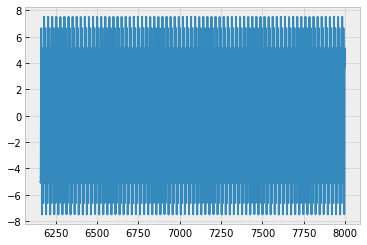

max in egs 7.504579105717978
finish this plot
Omega 0.7695390781563126


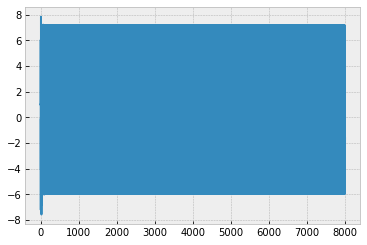

7.173709713590614


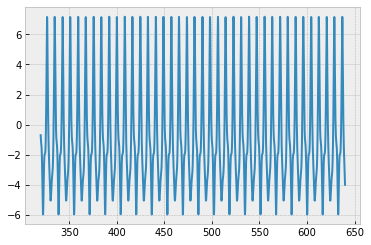

7.173731570339119


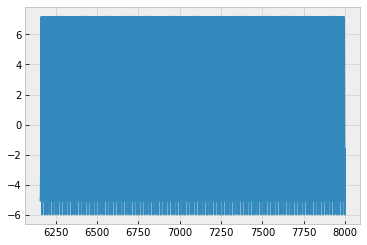

max in egs 6.568366953883998
finish this plot
Omega 0.7755511022044088


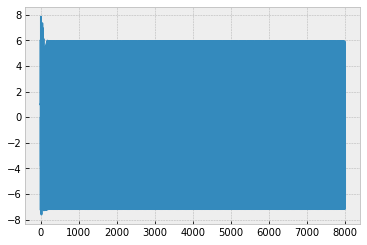

5.9710497396392235


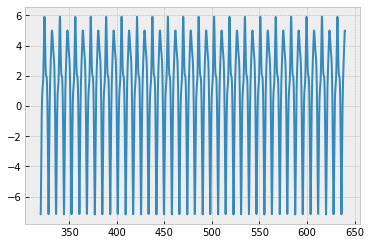

5.914873655513603


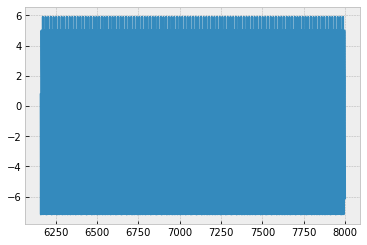

max in egs 6.545393029497655
finish this plot
Omega 0.781563126252505


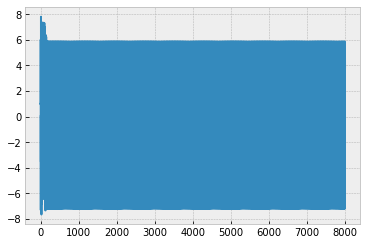

5.91295452585006


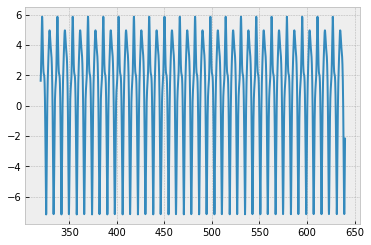

5.86355493260124


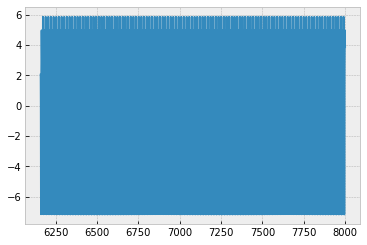

max in egs 6.5212406513515635
finish this plot
Omega 0.7875751503006012


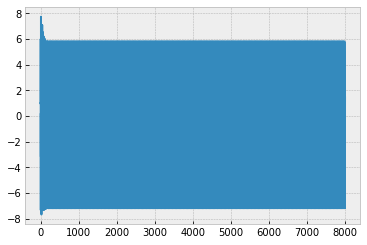

5.838783311526013


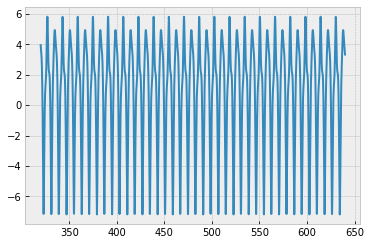

5.808134327383037


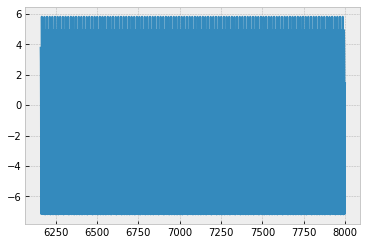

max in egs 6.495465919459477
finish this plot
Omega 0.7935871743486974


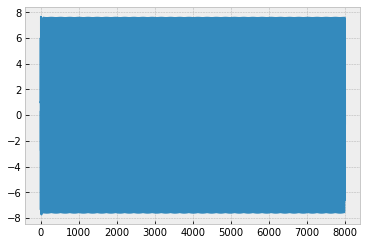

7.578125874115643


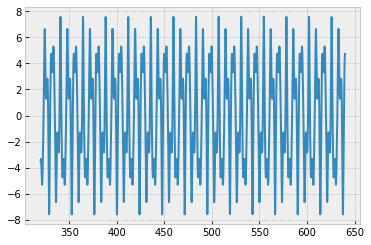

7.578217616884447


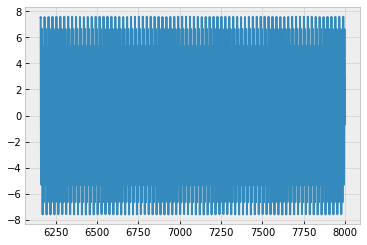

max in egs 7.578212064372751
finish this plot
Omega 0.7995991983967936


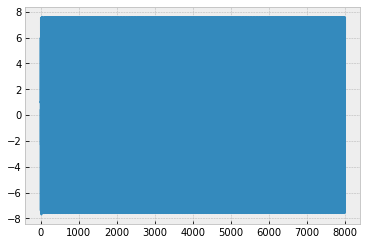

7.5862380685792115


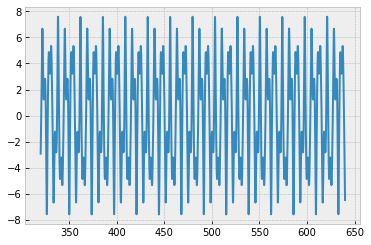

7.586238872570846


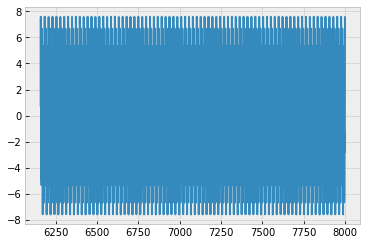

max in egs 7.586238609149635
finish this plot
Omega 0.8056112224448898


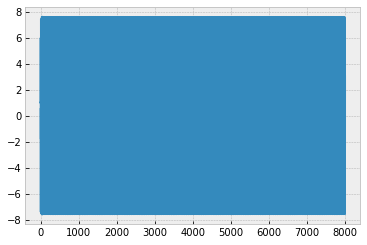

7.58462815765162


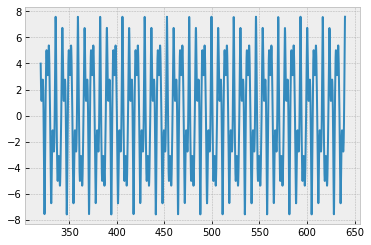

7.5846388236967455


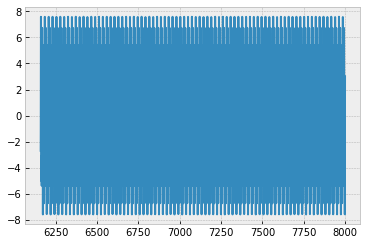

max in egs 7.584638392351545
finish this plot
Omega 0.811623246492986


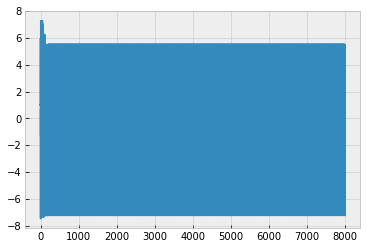

5.51344660900748


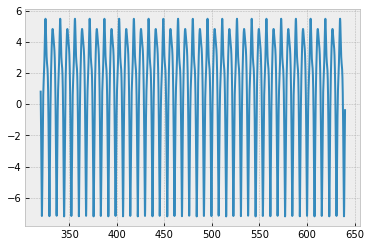

5.511383951186687


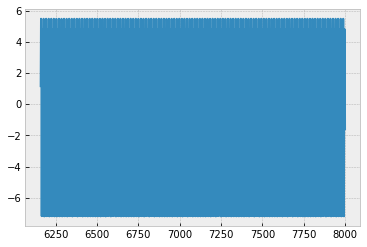

max in egs 6.35941037915487
finish this plot
Omega 0.8176352705410822


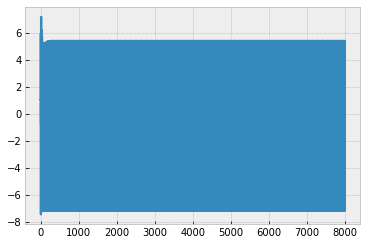

5.398268700521283


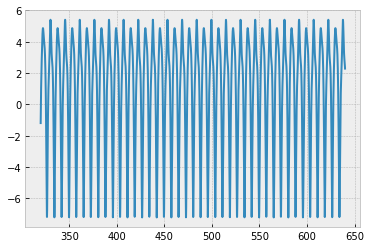

5.398217604283039


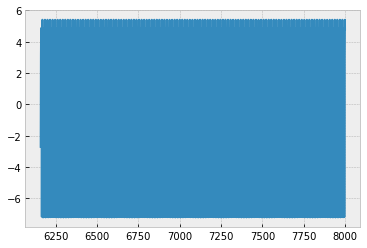

max in egs 6.306548819902659
finish this plot
Omega 0.8236472945891784


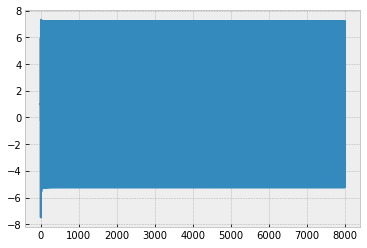

7.22099482771498


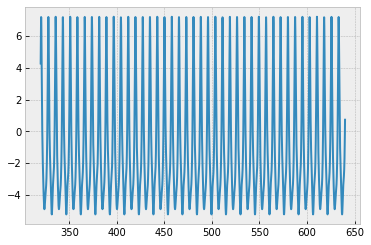

7.220999300507625


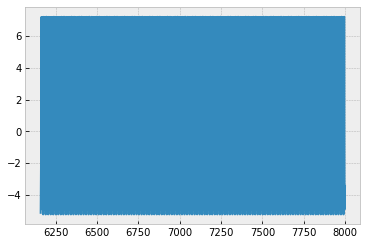

max in egs 6.229051309699271
finish this plot
Omega 0.8296593186372745


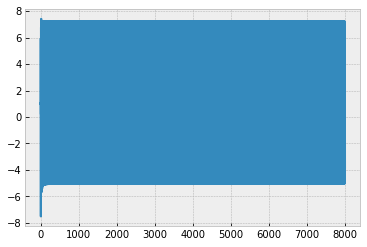

7.2218981644913764


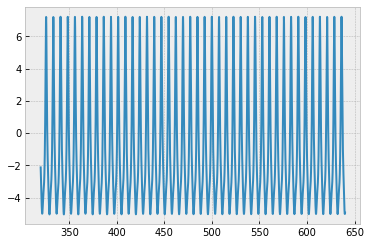

7.221002095231112


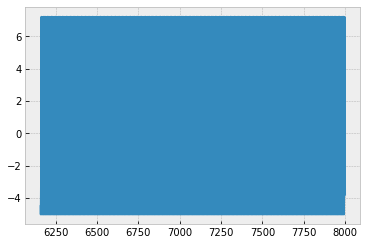

max in egs 6.122919224327566
finish this plot
Omega 0.8356713426853707


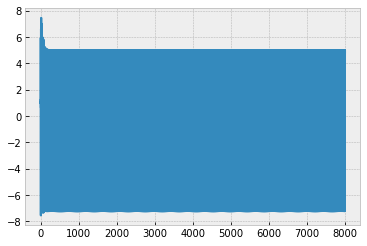

5.042396974603281


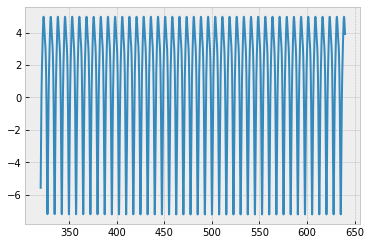

4.990285212919788


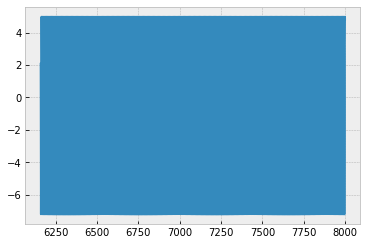

max in egs 6.10845737185185
finish this plot
Omega 0.8416833667334669


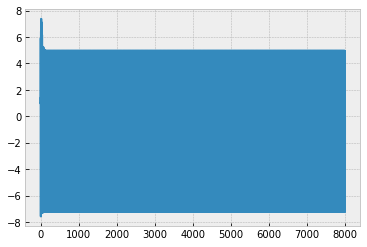

4.957496483549988


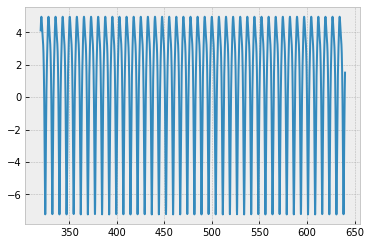

4.957432064179061


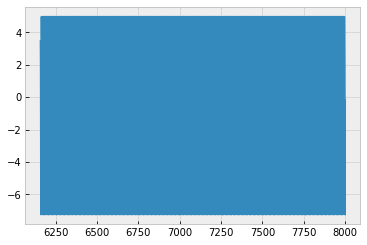

max in egs 6.095373724269942
finish this plot
Omega 0.8476953907815631


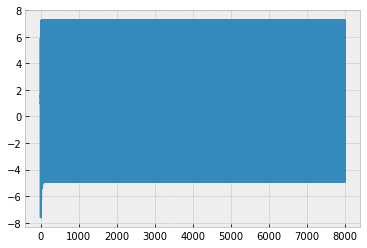

7.241017442945517


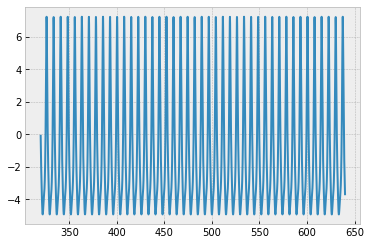

7.2410548685031895


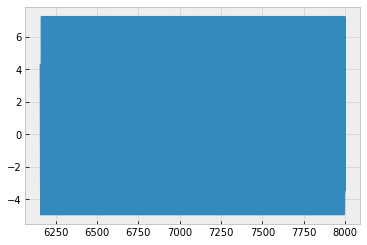

max in egs 6.083938572817026
finish this plot
Omega 0.8537074148296593


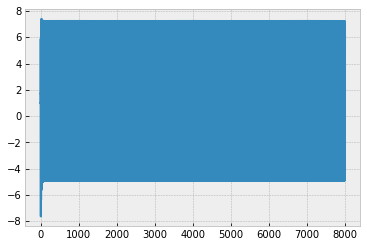

7.24965930378172


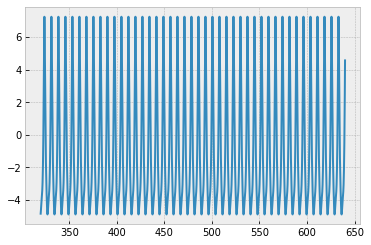

7.249876896352419


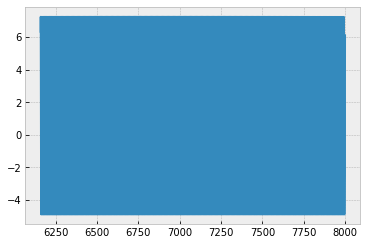

max in egs 6.073694835211531
finish this plot
Omega 0.8597194388777555


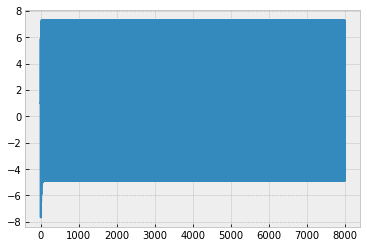

7.2597632126333975


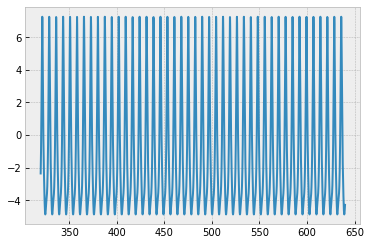

7.259763032968654


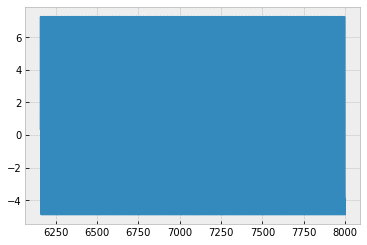

max in egs 6.067462777185918
finish this plot
Omega 0.8657314629258517


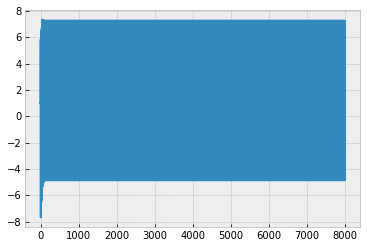

7.270724081683159


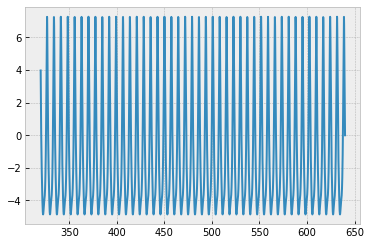

7.270728732353761


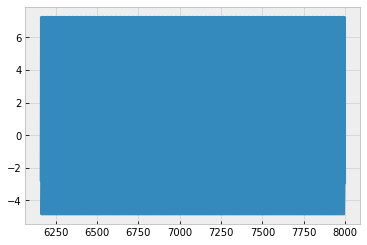

max in egs 6.063242615443472
finish this plot
Omega 0.8717434869739479


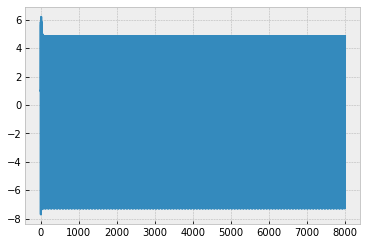

4.8417274627611615


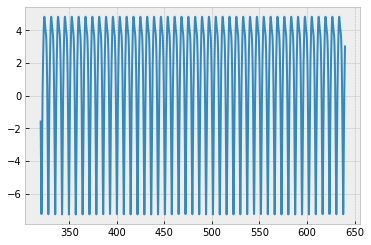

4.84172752812341


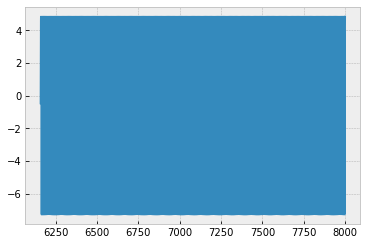

max in egs 6.062254662946913
finish this plot
Omega 0.8777555110220441


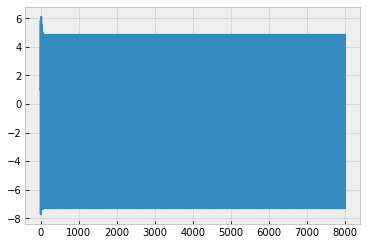

4.8337462127942


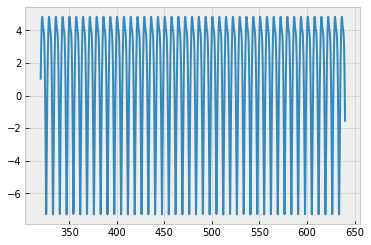

4.83373043954418


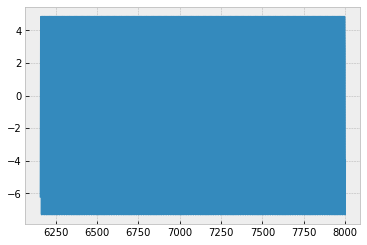

max in egs 6.064831456928285
finish this plot
Omega 0.8837675350701403


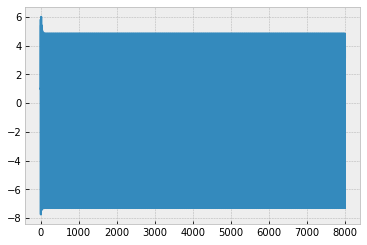

4.832234160260424


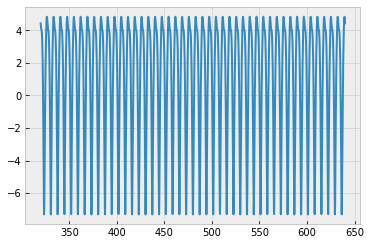

4.832178904568254


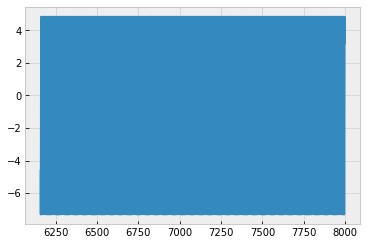

max in egs 6.071185954622132
finish this plot
Omega 0.8897795591182365


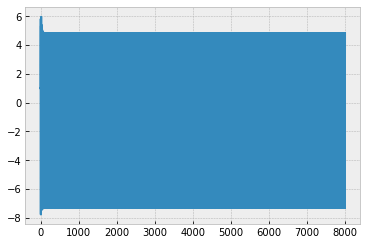

4.83721578833503


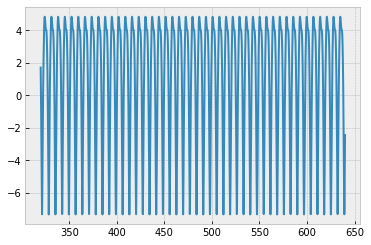

4.837216243139549


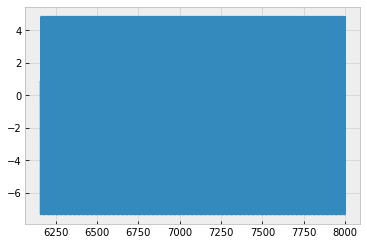

max in egs 6.081397775151356
finish this plot
Omega 0.8957915831663327


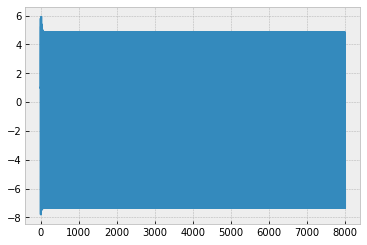

4.848749116348871


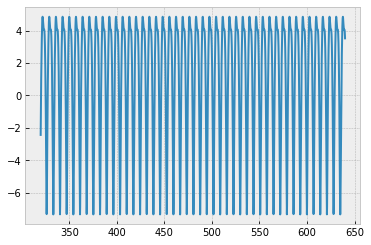

4.848750128937105


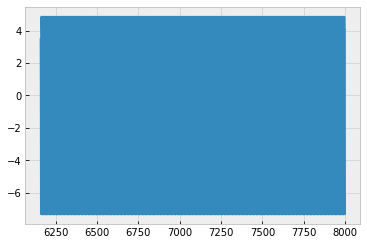

max in egs 6.095429010258776
finish this plot
Omega 0.9018036072144289


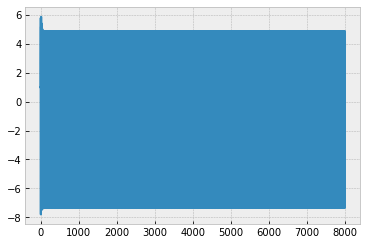

4.866573737173816


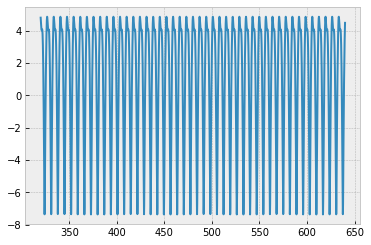

4.866525099013541


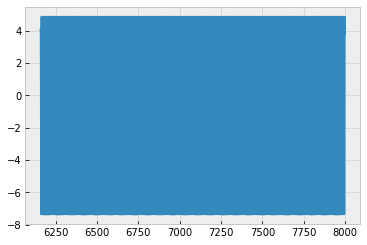

max in egs 6.113158322758529
finish this plot
Omega 0.9078156312625251


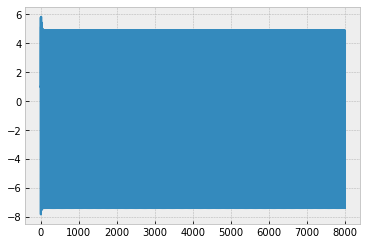

4.890199533693709


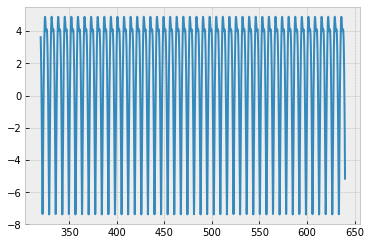

4.8901990540887095


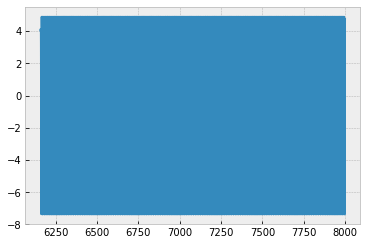

max in egs 6.134444766529237
finish this plot
Omega 0.9138276553106213


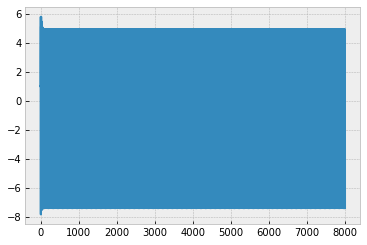

4.919420846021869


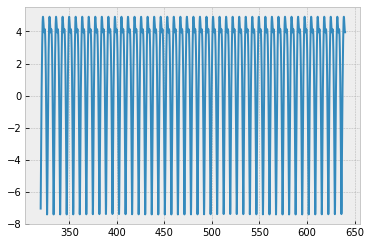

4.919413899014632


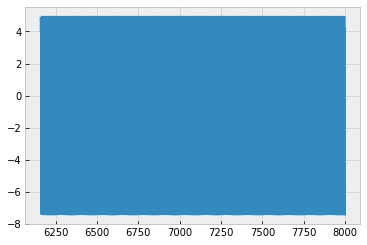

max in egs 6.159107771437887
finish this plot
Omega 0.9198396793587175


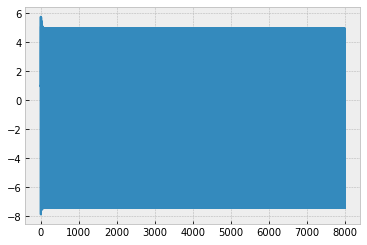

4.953827870201929


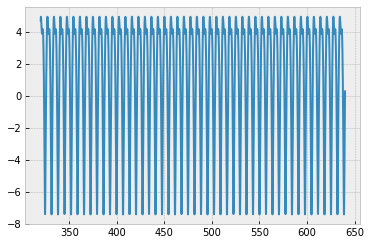

4.953827838094976


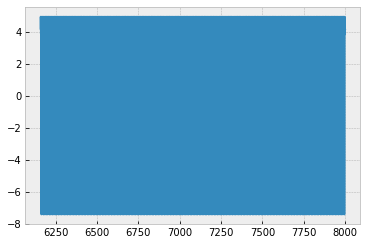

max in egs 6.187000829236414
finish this plot
Omega 0.9258517034068137


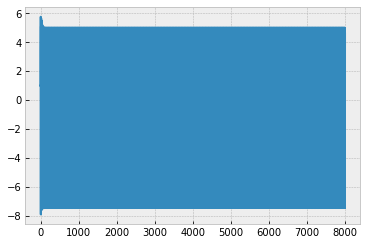

4.993182828226532


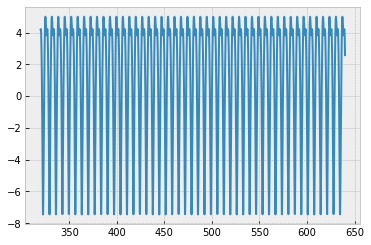

4.9931562291834934


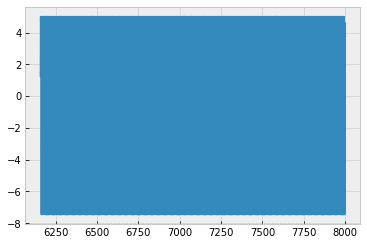

max in egs 6.218008217941021
finish this plot
Omega 0.9318637274549099


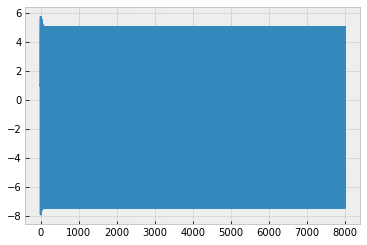

5.037180543620478


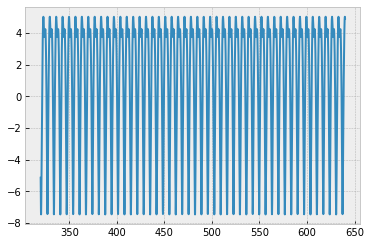

5.037181590325456


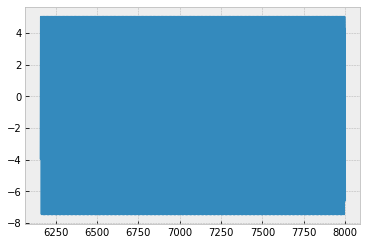

max in egs 6.252045763839157
finish this plot
Omega 0.937875751503006


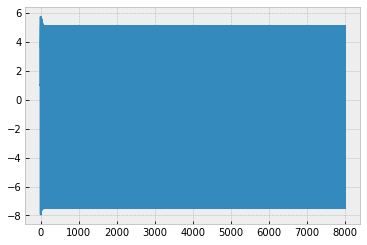

5.08576628477537


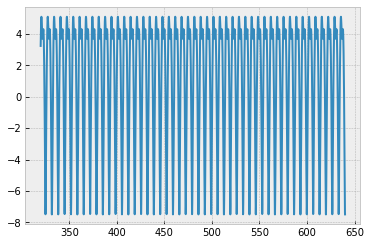

5.085766118385477


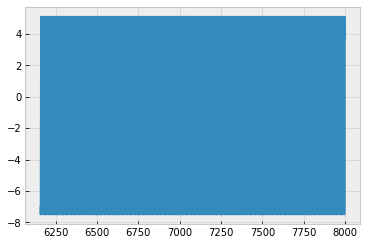

max in egs 6.289080691920869
finish this plot
Omega 0.9438877755511021


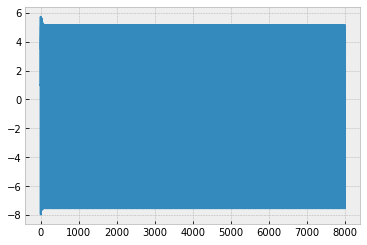

5.138860722527849


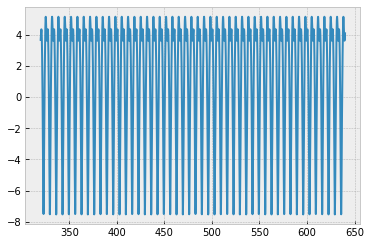

5.138860769409286


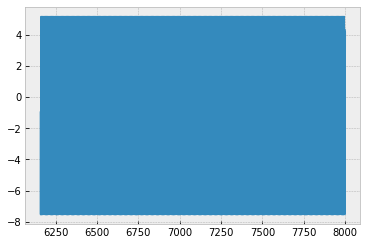

max in egs 6.329138134559171
finish this plot
Omega 0.9498997995991983


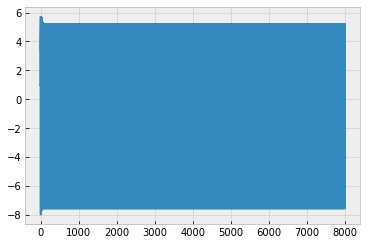

5.196581153340398


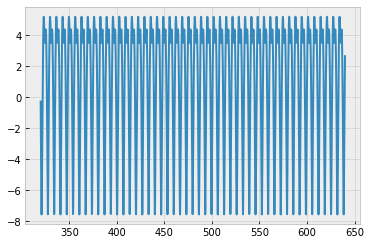

5.196517126724584


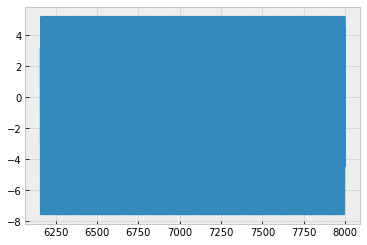

max in egs 6.372290723755064
finish this plot
Omega 0.9559118236472945


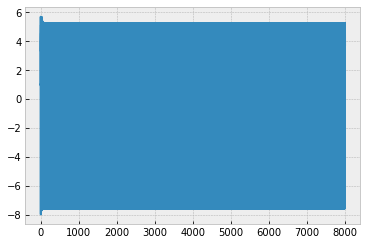

5.25896837213419


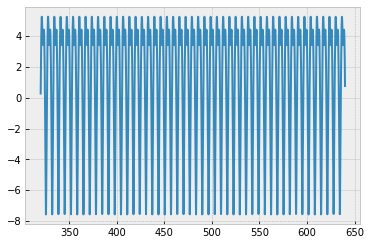

5.258905784091631


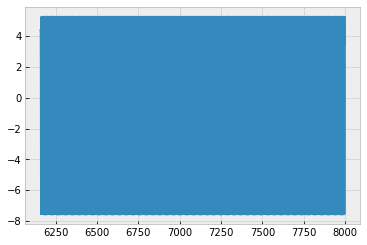

max in egs 6.418686712310112
finish this plot
Omega 0.9619238476953907


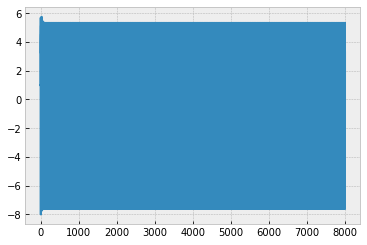

5.326639681182065


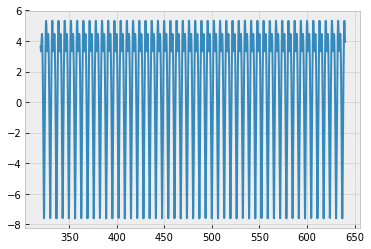

5.32634670581818


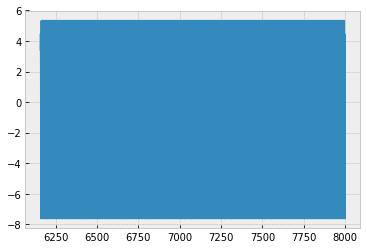

max in egs 6.468598274698335
finish this plot
Omega 0.9679358717434869


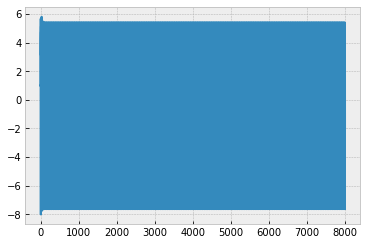

5.399366061418797


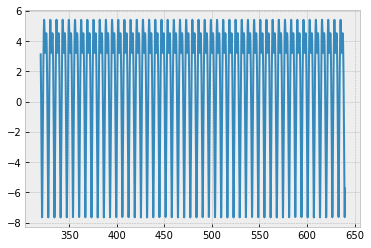

5.399361314043516


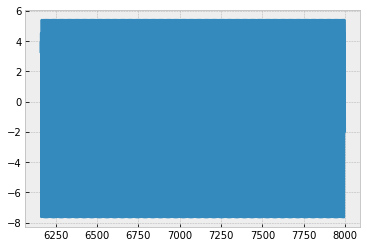

max in egs 6.522383323040944
finish this plot
Omega 0.9739478957915831


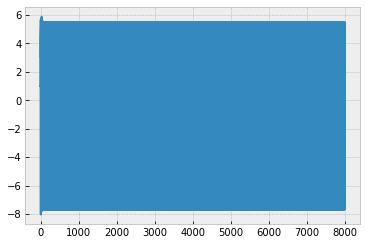

5.47878854802254


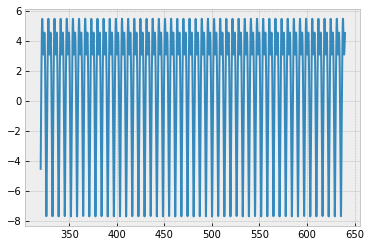

5.478763751727284


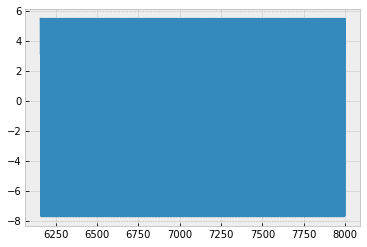

max in egs 6.58061641245721
finish this plot
Omega 0.9799599198396793


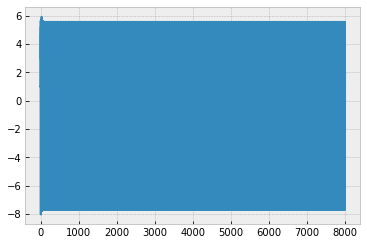

5.565830300399808


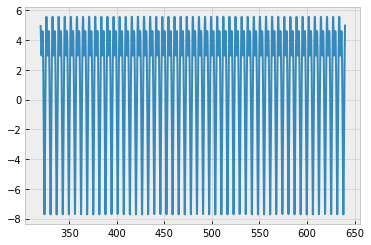

5.5658323543377


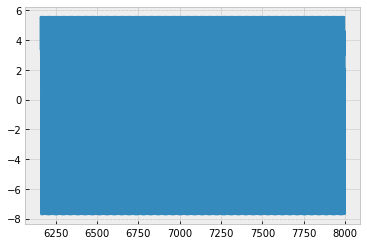

max in egs 6.644167335524941
finish this plot
Omega 0.9859719438877755


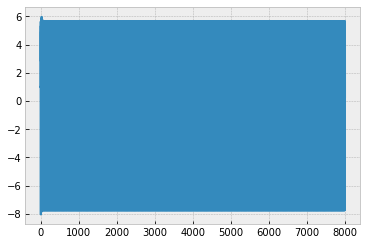

5.662660455338416


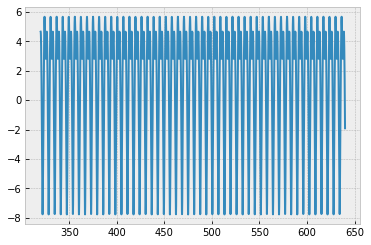

5.66266056720395


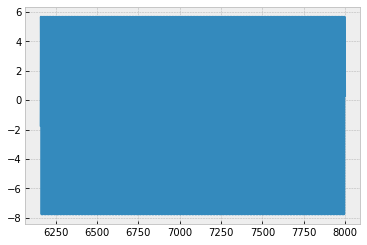

max in egs 6.7144470604394355
finish this plot
Omega 0.9919839679358717


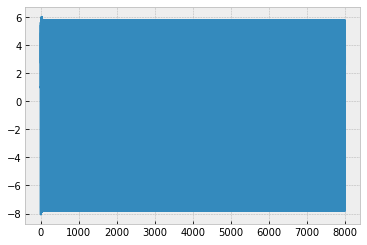

5.773116117603514


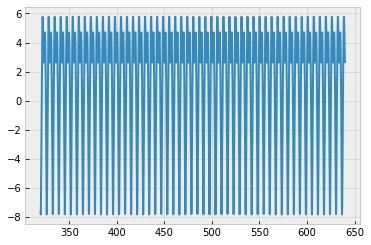

5.77297541512134


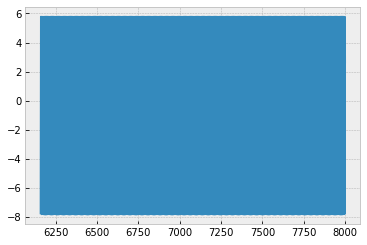

max in egs 6.793906001234045
finish this plot
Omega 0.9979959919839679


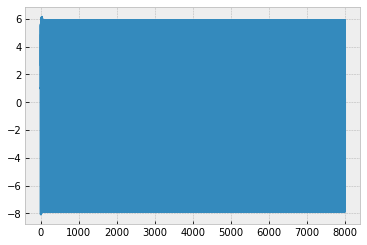

5.90456457331056


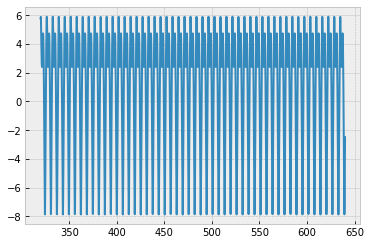

5.904530076025595


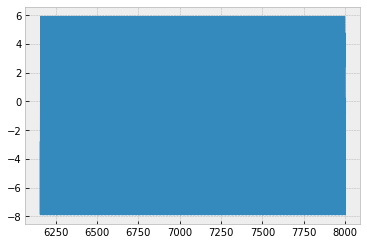

max in egs 6.887615528851557
finish this plot
Omega 1.0040080160320641


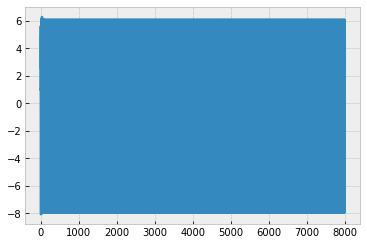

6.079852853334725


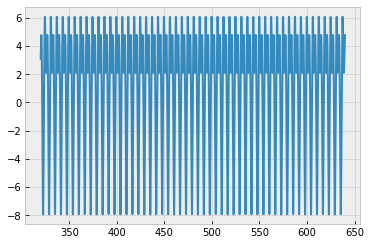

6.079854546932715


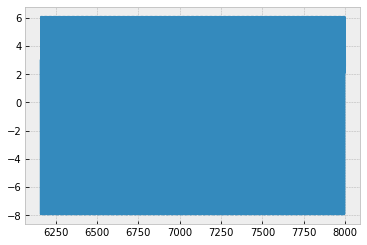

max in egs 7.010071647117622
finish this plot
Omega 1.0100200400801602


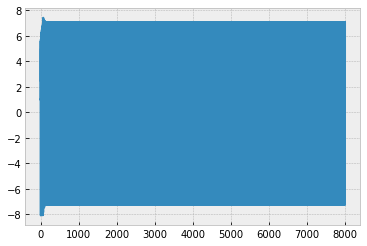

7.067831142465959


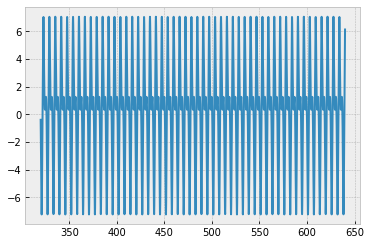

7.065016969353869


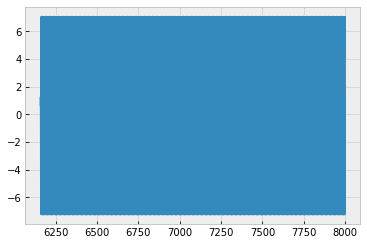

max in egs 7.154322233748066
finish this plot
Omega 1.0160320641282565


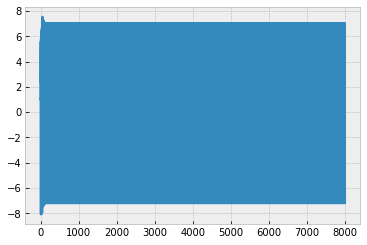

7.035535020740489


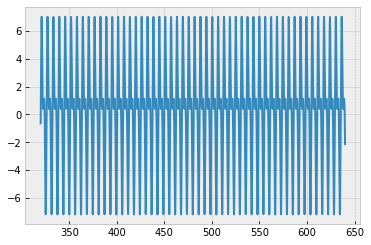

7.033305888712289


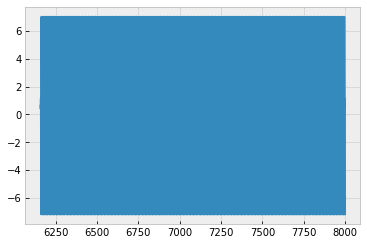

max in egs 7.1183100621912
finish this plot
Omega 1.0220440881763526


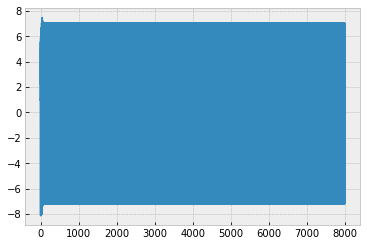

7.001067218230497


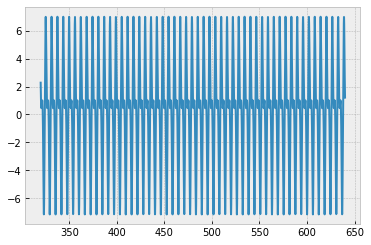

7.001067147645722


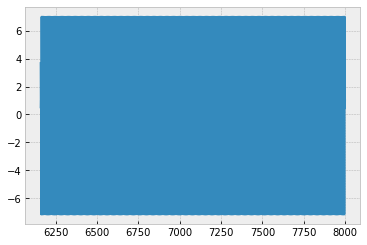

max in egs 7.082776916184326
finish this plot
Omega 1.028056112224449


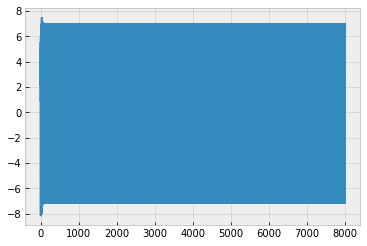

6.968265904253447


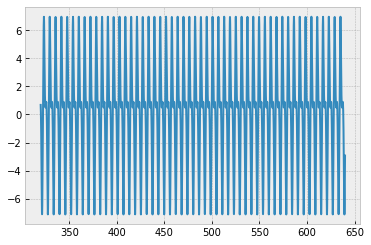

6.968267009757573


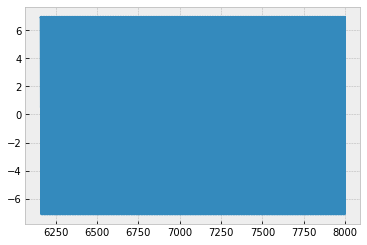

max in egs 7.047293936075629
finish this plot
Omega 1.034068136272545


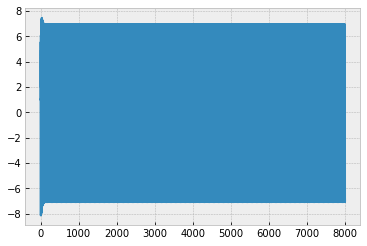

6.93487280175004


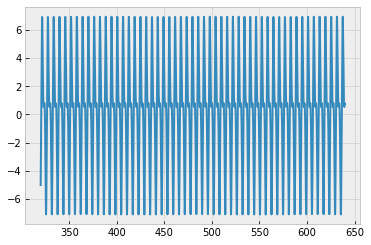

6.934867090103449


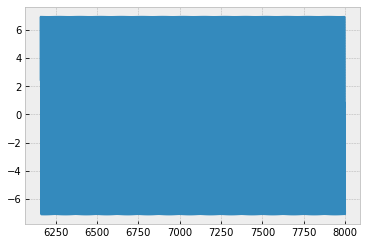

max in egs 7.011677500063406
finish this plot
Omega 1.0400801603206413


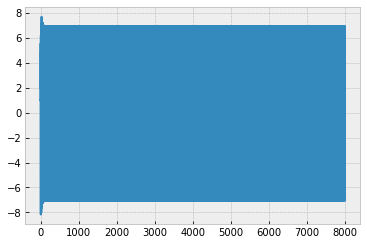

6.900829907781184


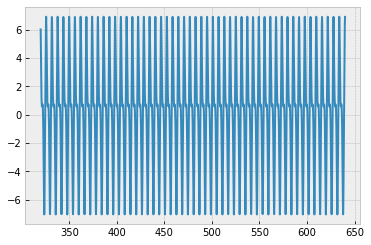

6.900830852090899


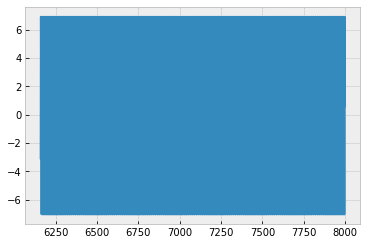

max in egs 6.975737785348885
finish this plot
Omega 1.0460921843687374


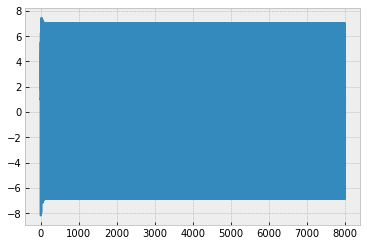

7.012667422603328


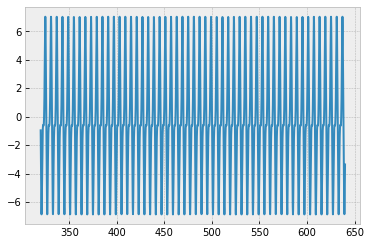

7.012504890726528


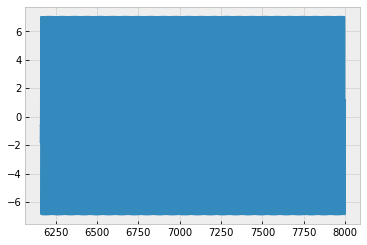

max in egs 6.939311260664702
finish this plot
Omega 1.0521042084168337


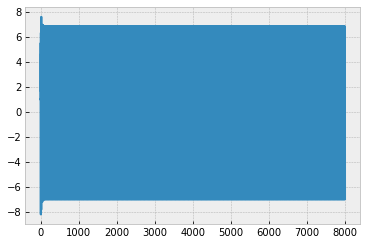

6.830703646408475


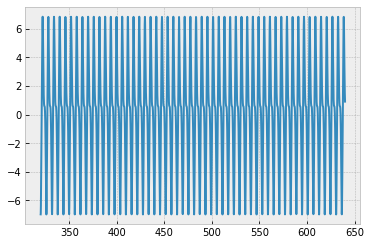

6.830712384737728


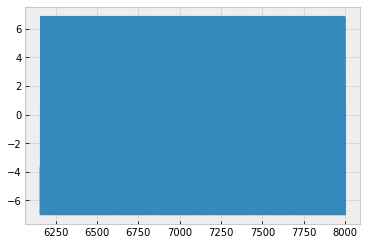

max in egs 6.902252011539277
finish this plot
Omega 1.0581162324649298


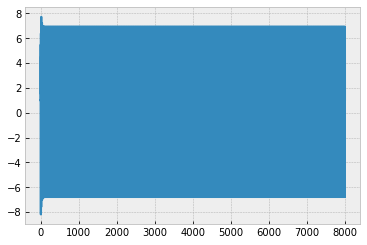

6.934237892637819


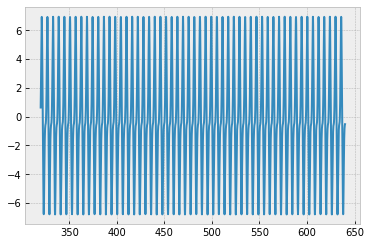

6.934250595847877


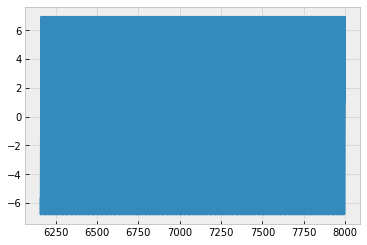

max in egs 6.864412378342237
finish this plot
Omega 1.0641282565130261


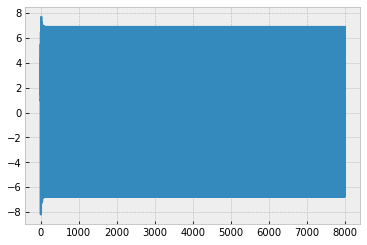

6.893618942997192


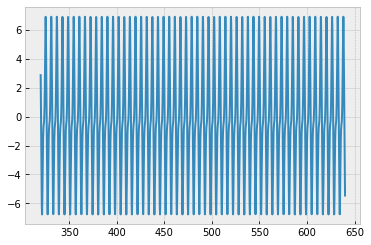

6.8936222741096485


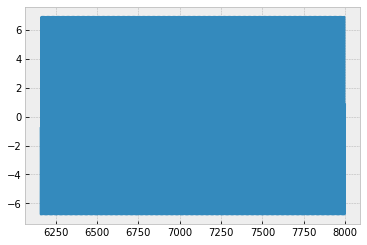

max in egs 6.825656859913487
finish this plot
Omega 1.0701402805611222


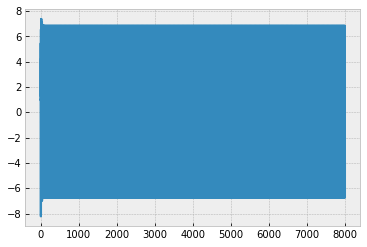

6.851623116255704


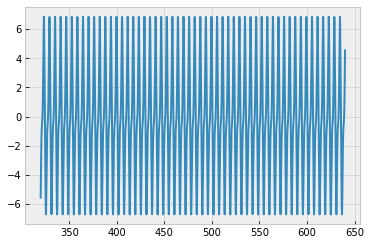

6.851625631855465


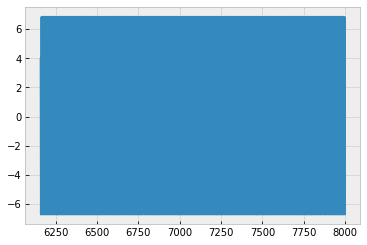

max in egs 6.785839393070569
finish this plot
Omega 1.0761523046092185


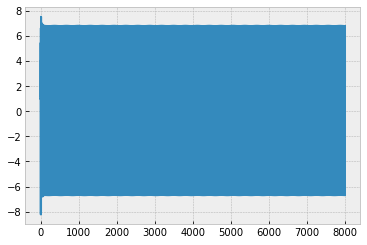

6.807944147111262


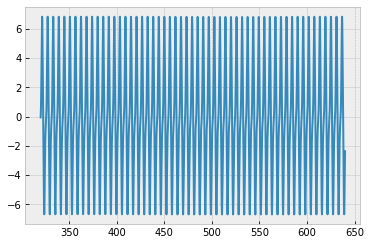

6.80794637088287


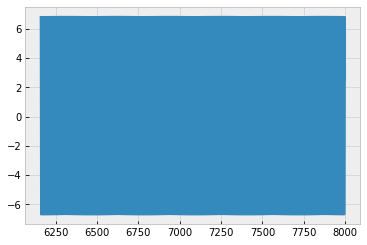

max in egs 6.744856685597286
finish this plot
Omega 1.0821643286573146


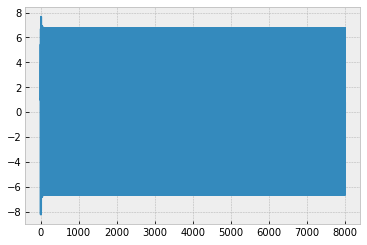

6.762261460693344


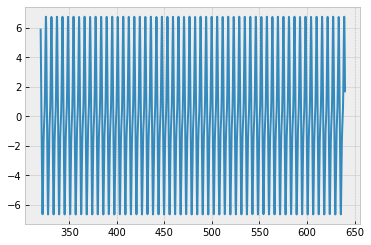

6.762191384324531


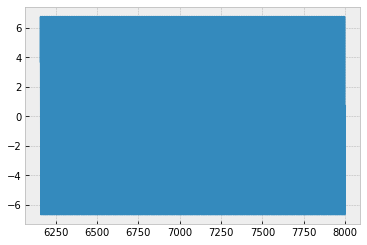

max in egs 6.702515991237528
finish this plot
Omega 1.088176352705411


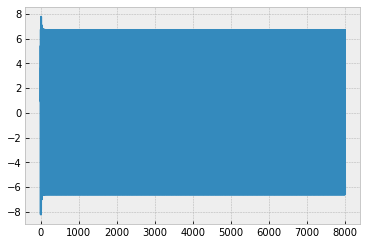

6.713842774238479


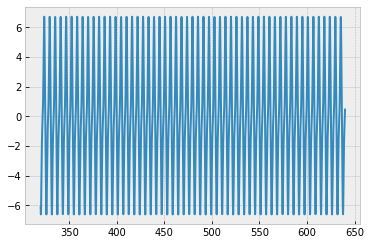

6.7138428768042795


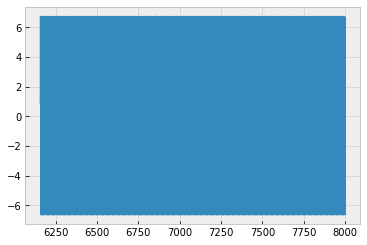

max in egs 6.658676612802587
finish this plot
Omega 1.094188376753507


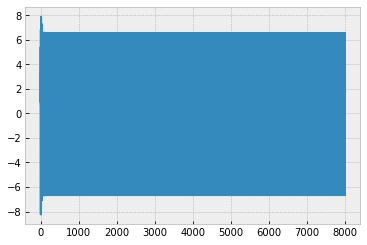

6.5642084894898876


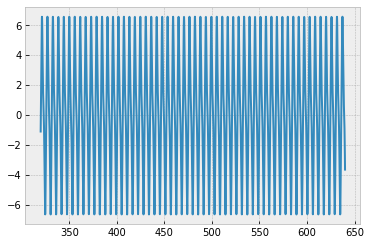

6.564208487057972


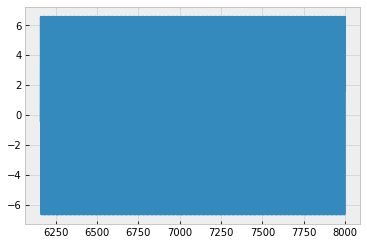

max in egs 6.613161419873998
finish this plot
Omega 1.100200400801603


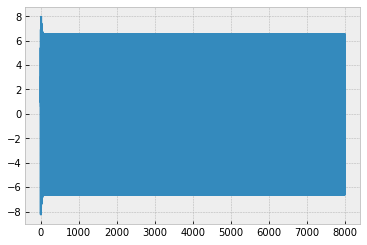

6.525994321244231


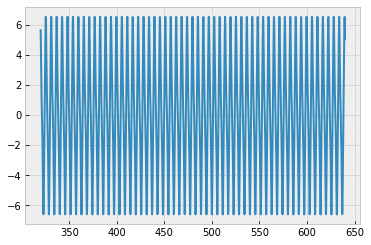

6.525994584437282


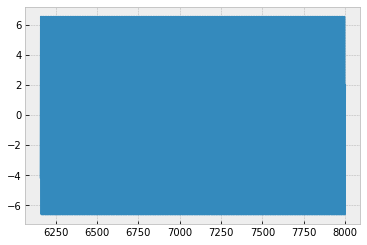

max in egs 6.565779877857732
finish this plot
Omega 1.1062124248496994


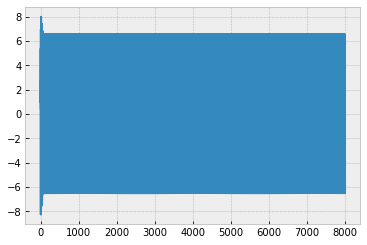

6.539857928016333


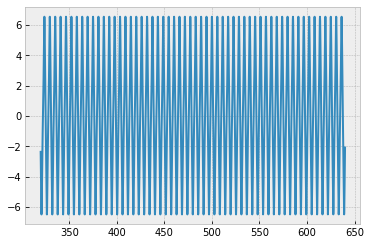

6.539818977333966


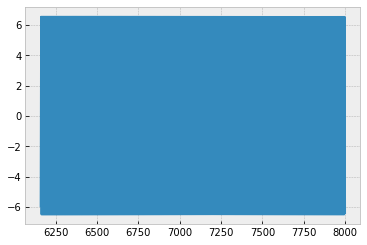

max in egs 6.511257540115283
finish this plot
Omega 1.1122244488977955


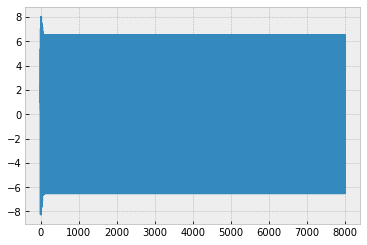

6.496679573333814


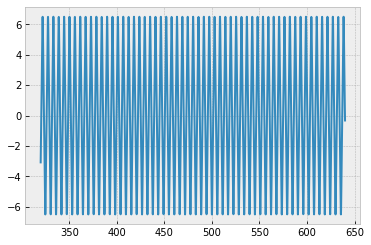

6.496679804231737


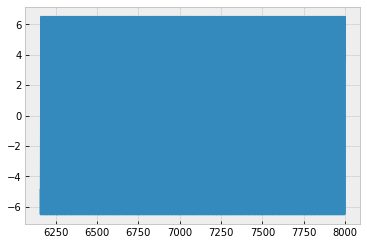

max in egs 6.496679545254091
finish this plot
Omega 1.1182364729458918


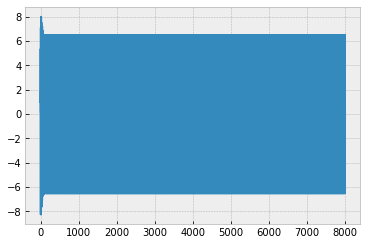

6.503098222703091


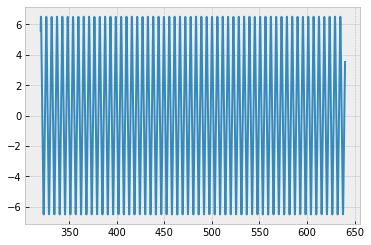

6.503099433506046


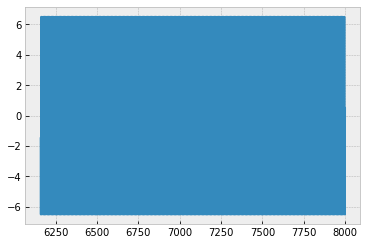

max in egs 6.503099083506953
finish this plot
Omega 1.1242484969939879


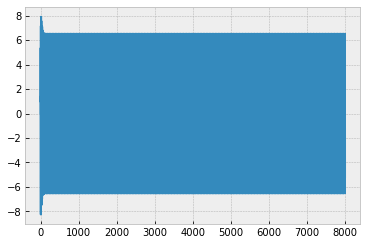

6.50979425942663


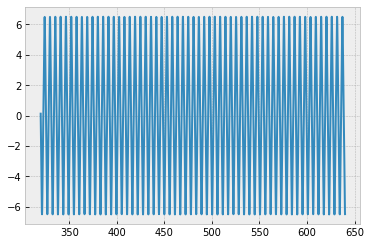

6.509688533061261


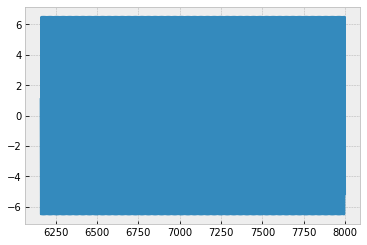

max in egs 6.509688531746672
finish this plot
Omega 1.1302605210420842


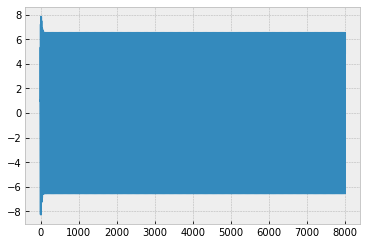

6.516442964963711


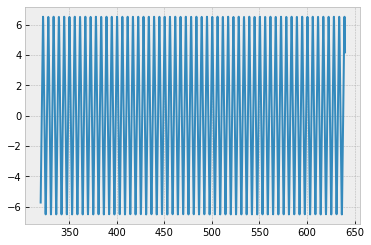

6.516443629246566


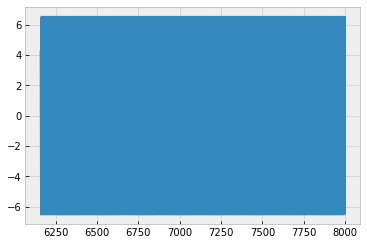

max in egs 6.516443055344269
finish this plot
Omega 1.1362725450901803


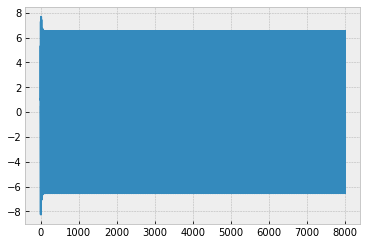

6.523395684385032


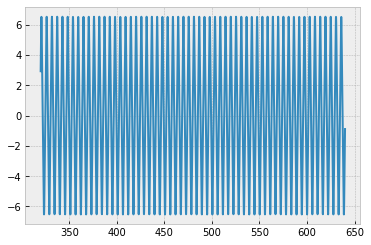

6.523361608313364


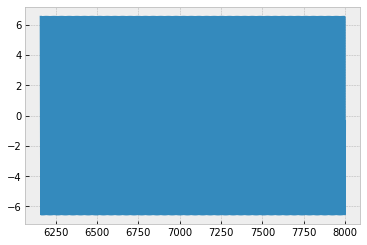

max in egs 6.5233600063529344
finish this plot
Omega 1.1422845691382766


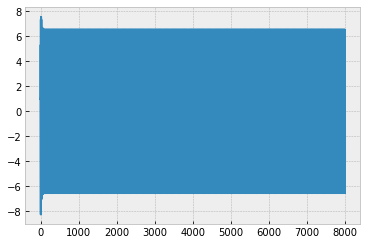

6.530438790780602


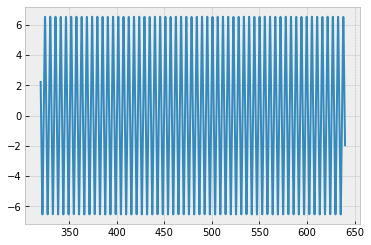

6.53043910552849


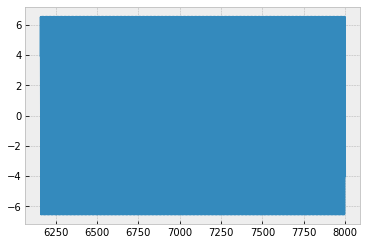

max in egs 6.530434882155047
finish this plot
Omega 1.1482965931863727


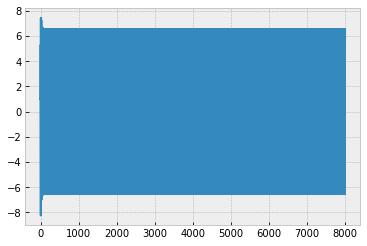

6.53791433472647


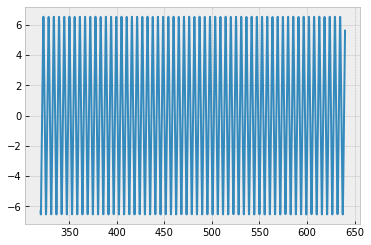

6.5376730602025495


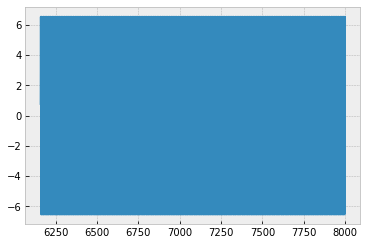

max in egs 6.537673009319783
finish this plot
Omega 1.154308617234469


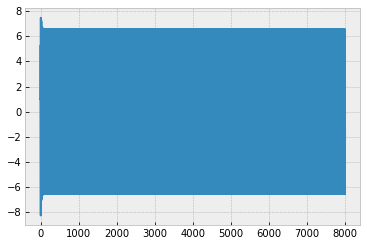

6.545042858746835


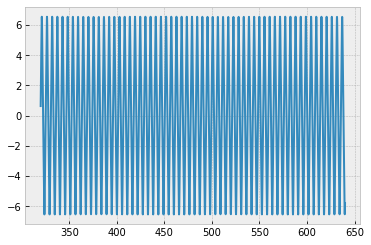

6.5450604635405725


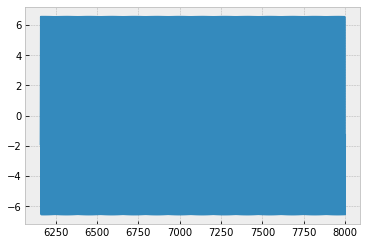

max in egs 6.545058454742054
finish this plot
Omega 1.160320641282565


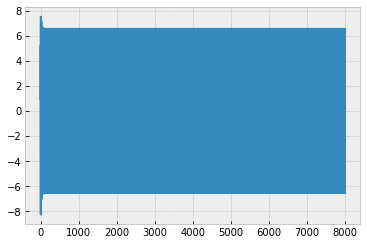

6.552594930914414


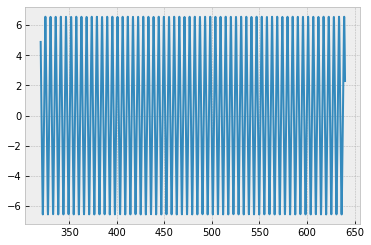

6.5525984209824575


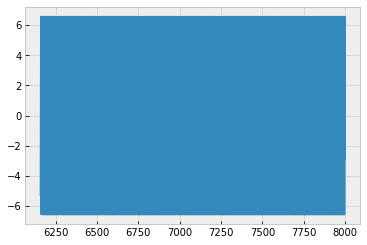

max in egs 6.552586870048338
finish this plot
Omega 1.1663326653306614


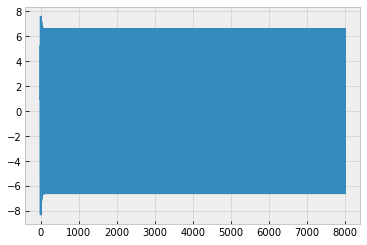

6.5602827256939475


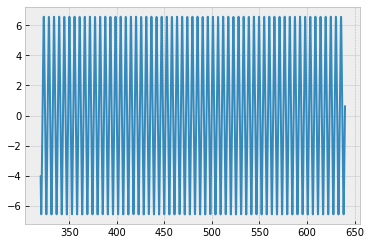

6.560284049577325


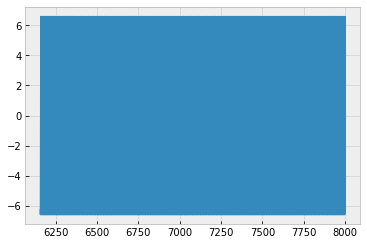

max in egs 6.560283211309519
finish this plot
Omega 1.1723446893787575


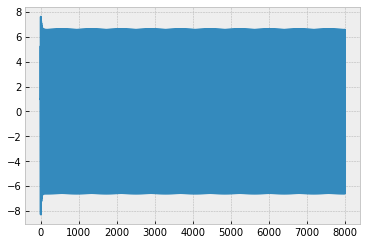

6.568114853489896


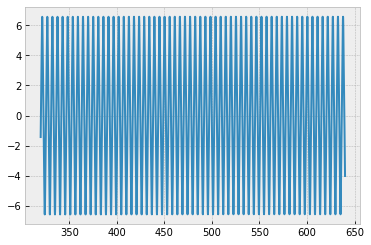

6.568114804665424


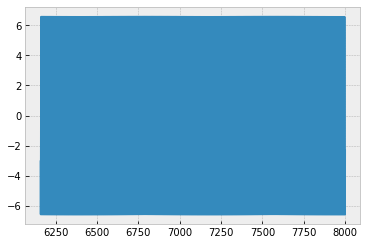

max in egs 6.568114630597883
finish this plot
Omega 1.1783567134268538


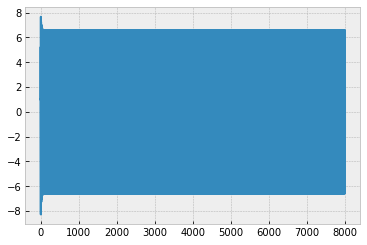

6.5760840124452145


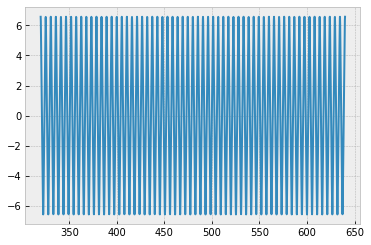

6.576087923988988


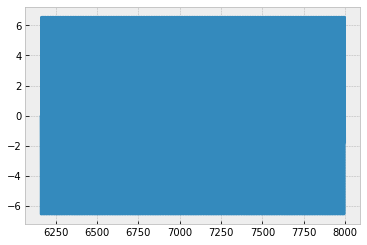

max in egs 6.576086905326973
finish this plot
Omega 1.1843687374749499


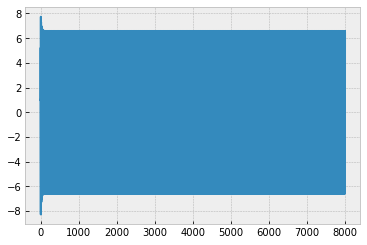

6.584288924848567


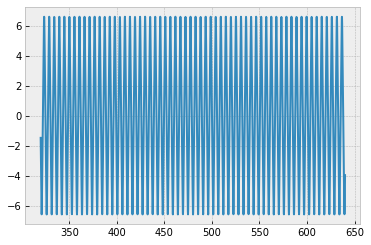

6.584200736969691


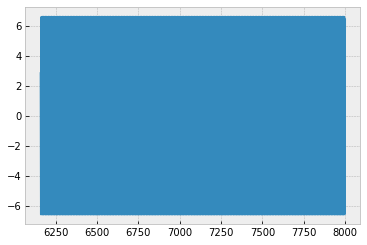

max in egs 6.584200464087338
finish this plot
Omega 1.1903807615230462


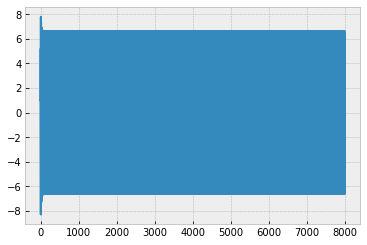

6.592727951959912


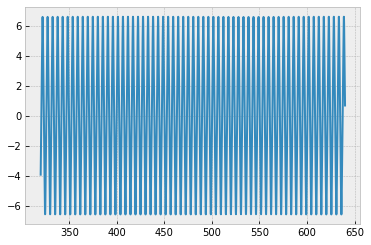

6.592450820585915


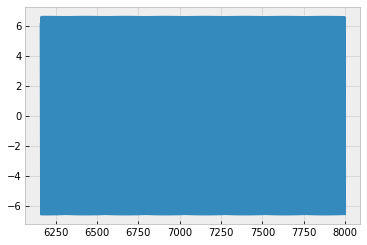

max in egs 6.592450457884468
finish this plot
Omega 1.1963927855711423


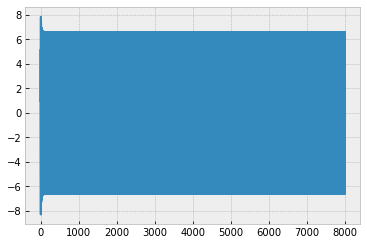

6.600912388329439


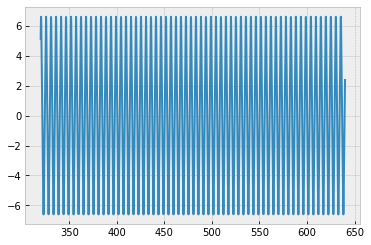

6.60083575531764


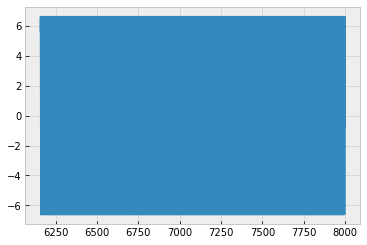

max in egs 6.600835443514901
finish this plot
Omega 1.2024048096192386


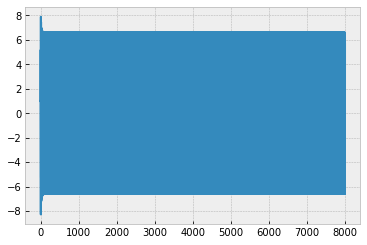

6.609356667126344


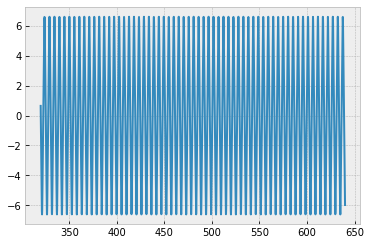

6.609353206861798


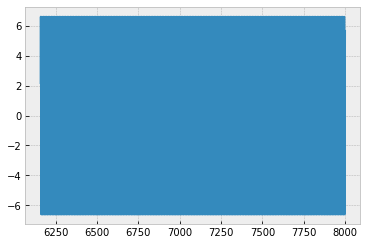

max in egs 6.609348065105587
finish this plot
Omega 1.2084168336673347


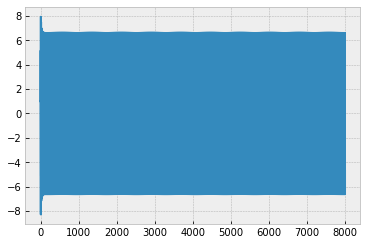

6.618000713722788


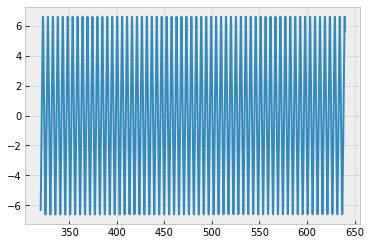

6.6180008713655525


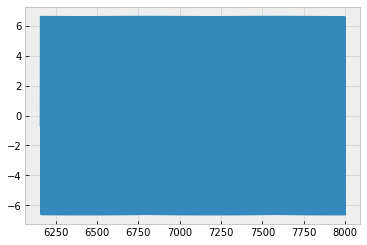

max in egs 6.618000544458801
finish this plot
Omega 1.2144288577154307


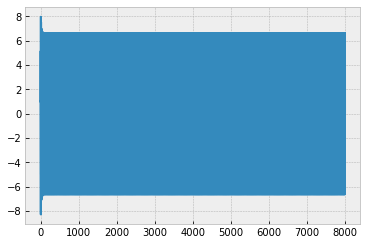

6.626776768218606


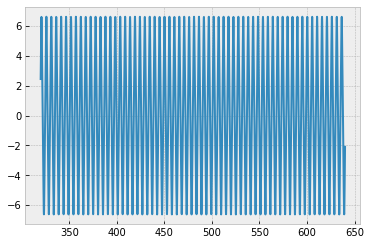

6.626776541632238


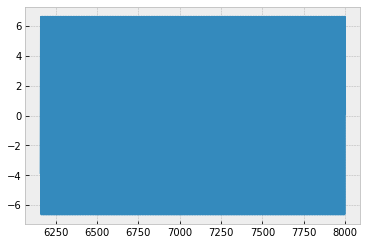

max in egs 6.626776299380785
finish this plot
Omega 1.220440881763527


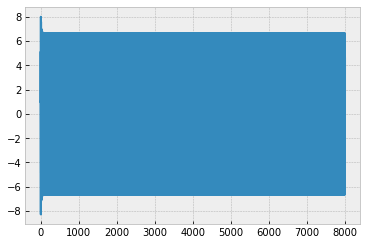

6.635725267895287


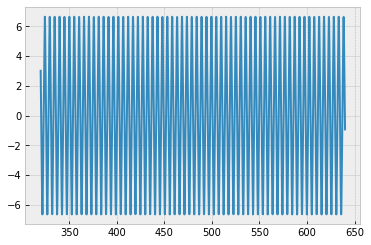

6.635677958960613


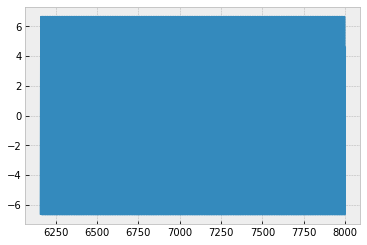

max in egs 6.635677990744005
finish this plot
Omega 1.2264529058116231


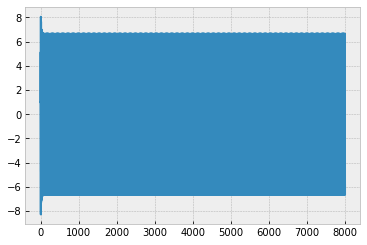

6.644880648498592


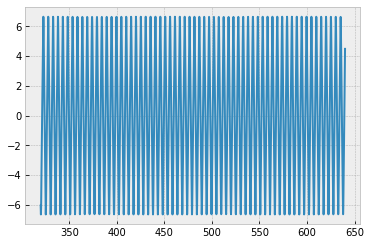

6.644703260553402


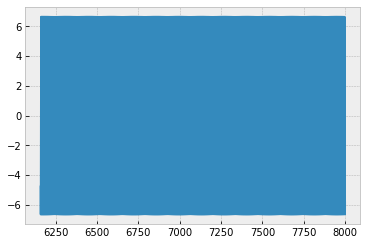

max in egs 6.6447027642129886
finish this plot
Omega 1.2324649298597194


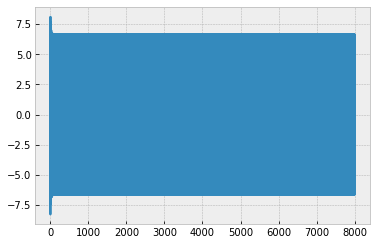

6.653852841943128


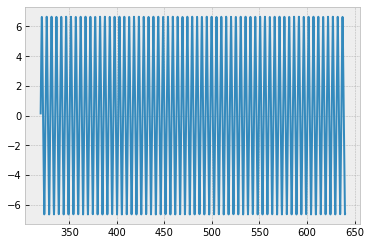

6.653850194639991


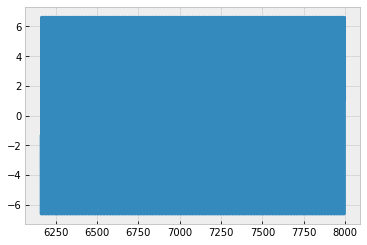

max in egs 6.653849928529192
finish this plot
Omega 1.2384769539078155


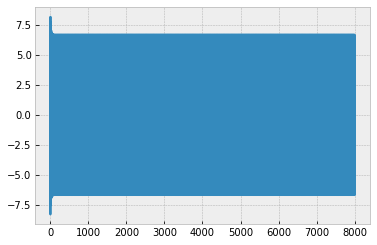

6.663302087963401


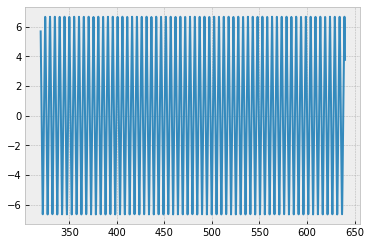

6.663117075533368


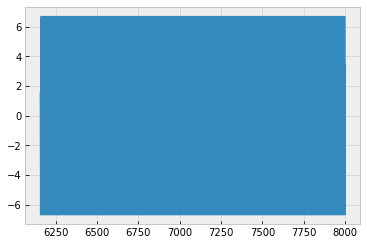

max in egs 6.663116863603685
finish this plot
Omega 1.2444889779559118


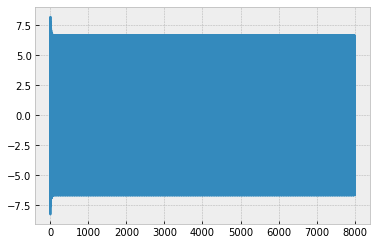

6.672575654111545


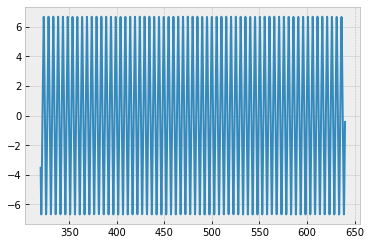

6.672501737179959


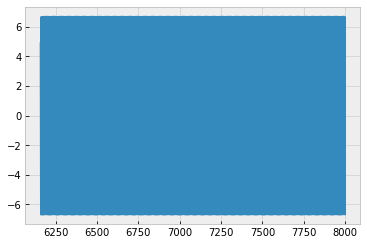

max in egs 6.672501467682938
finish this plot
Omega 1.250501002004008


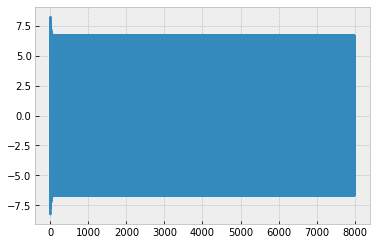

6.682009357667485


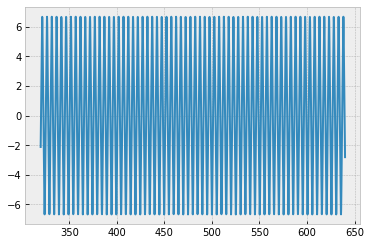

6.6820023278426754


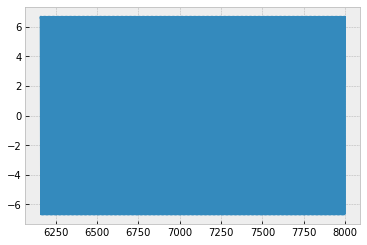

max in egs 6.682002195433906
finish this plot
Omega 1.2565130260521042


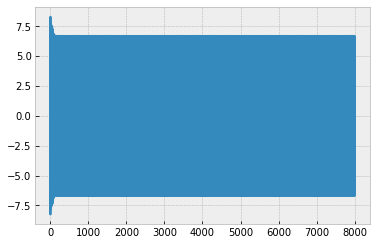

6.695143600449416


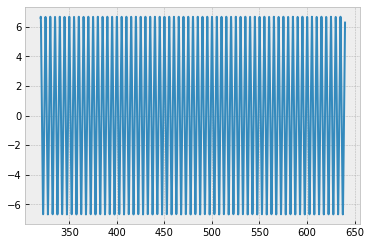

6.69161714196132


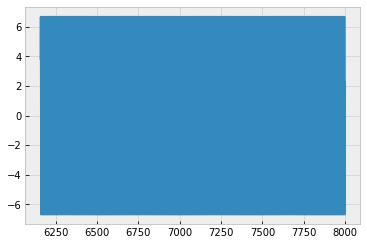

max in egs 6.691617045874032
finish this plot
Omega 1.2625250501002003


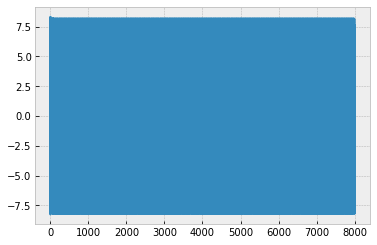

8.190196400907928


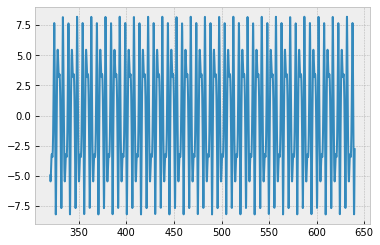

8.190233920326746


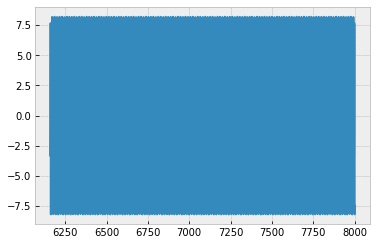

max in egs 8.190231176547849
finish this plot
Omega 1.2685370741482966


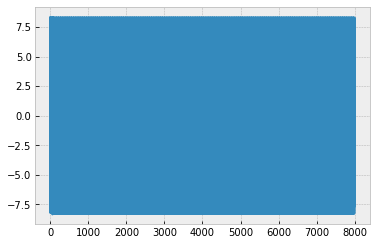

8.312763036276962


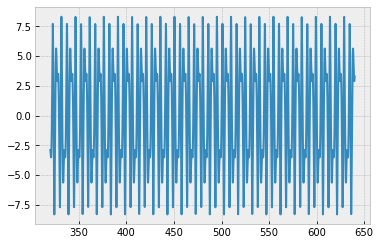

8.312763371425907


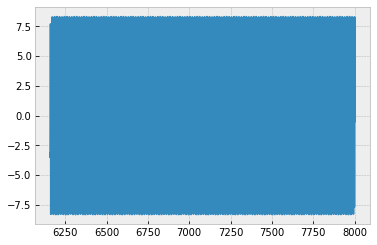

max in egs 8.31276341920161
finish this plot
Omega 1.2745490981963927


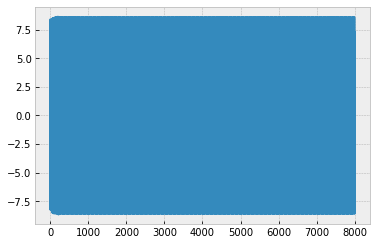

8.620817424094131


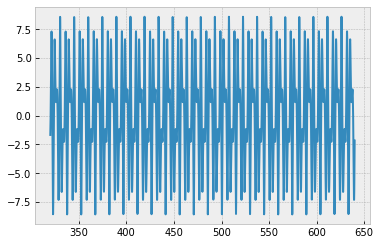

8.58036573259465


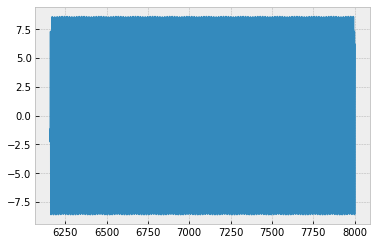

max in egs 8.580361999627252
finish this plot
Omega 1.280561122244489


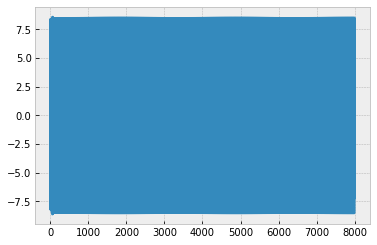

8.505680644354323


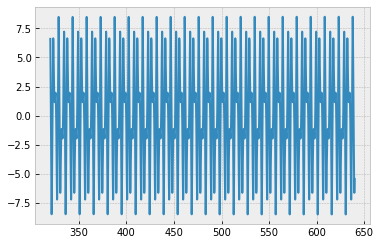

8.531309826477825


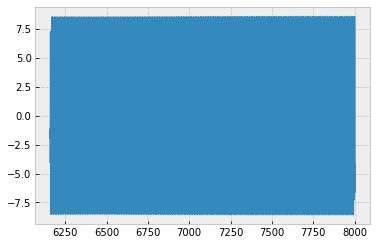

max in egs 8.531310045852008
finish this plot
Omega 1.2865731462925851


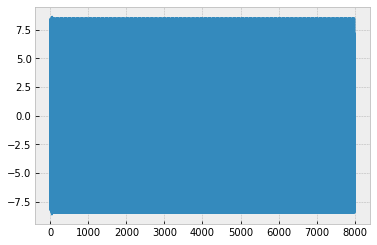

8.48476853382814


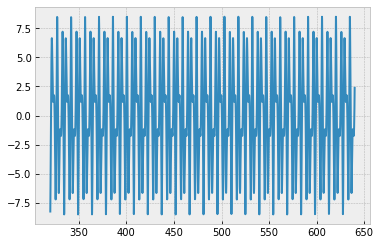

8.484650002071419


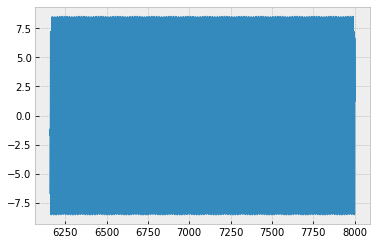

max in egs 8.484628458511866
finish this plot
Omega 1.2925851703406814


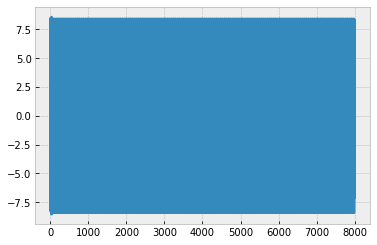

8.437222027721786


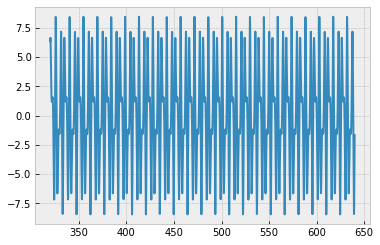

8.437237947512024


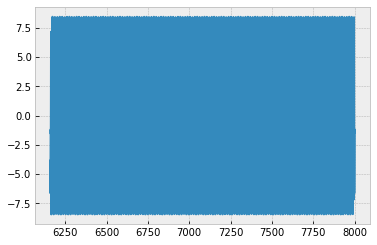

max in egs 8.437239315115256
finish this plot
Omega 1.2985971943887775


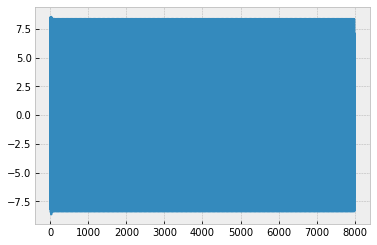

8.387337350704351


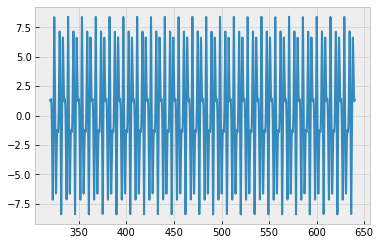

8.387347557778956


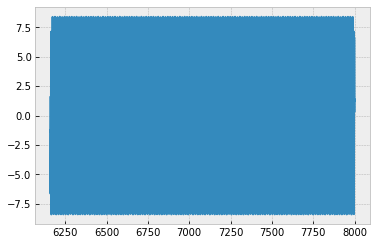

max in egs 8.38732112099203
finish this plot
Omega 1.3046092184368738


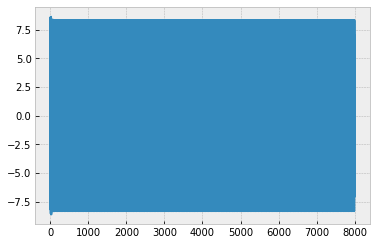

8.333362784677233


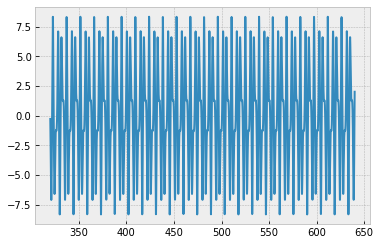

8.333372717584847


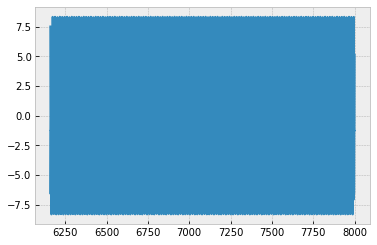

max in egs 8.333371333322363
finish this plot
Omega 1.31062124248497


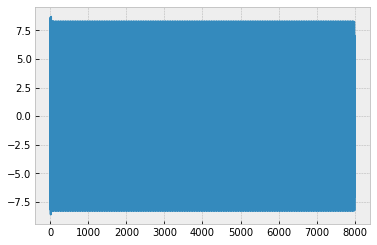

8.273315673872327


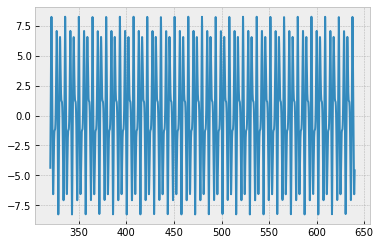

8.273316289147674


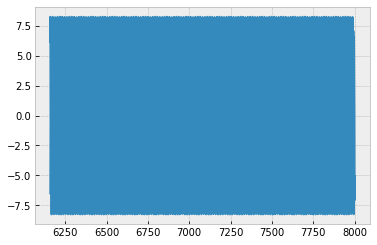

max in egs 8.273311413878025
finish this plot
Omega 1.3166332665330662


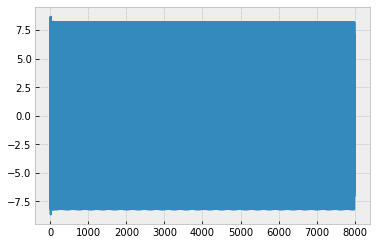

8.204038305644797


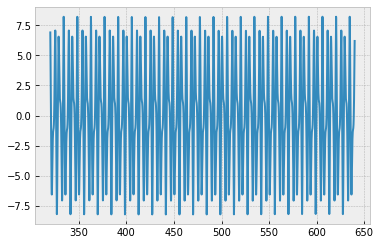

8.204066191499711


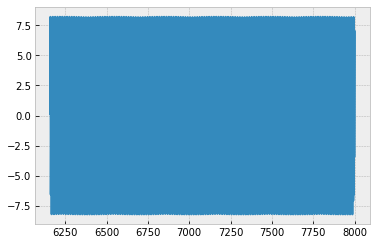

max in egs 8.204059008063727
finish this plot
Omega 1.3226452905811623


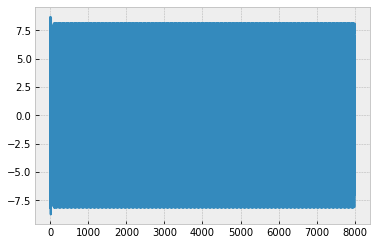

8.11936963189075


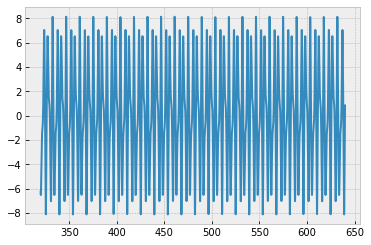

8.119533742615456


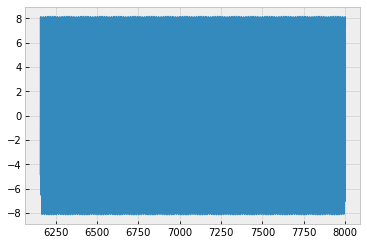

max in egs 8.11953348146195
finish this plot
Omega 1.3286573146292584


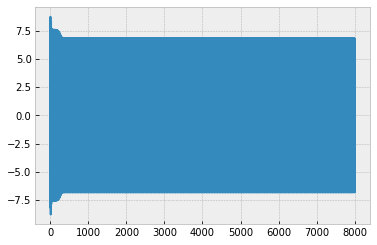

7.5415085320979305


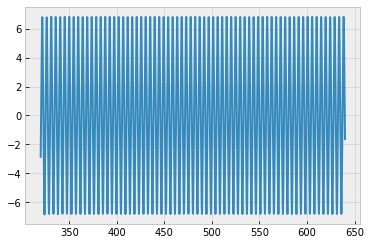

6.815303818143337


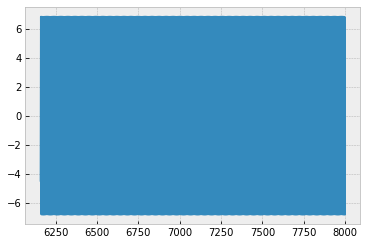

max in egs 6.815303717336121
finish this plot
Omega 1.3346693386773547


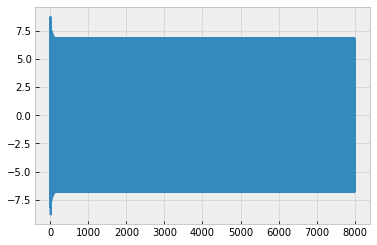

6.828523035701554


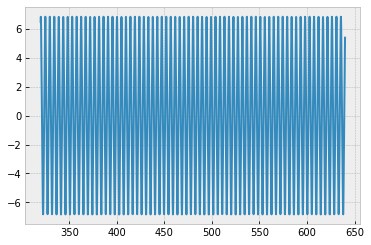

6.8262583529819745


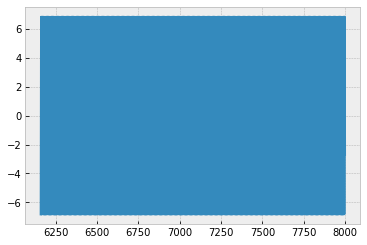

max in egs 6.826258374614163
finish this plot
Omega 1.3406813627254508


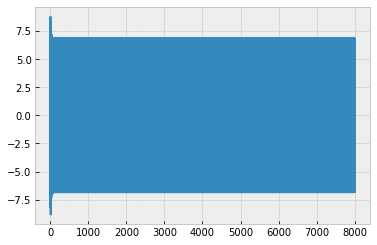

6.8372974365967405


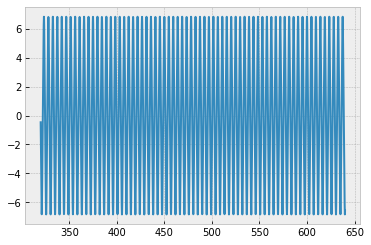

6.837306448795314


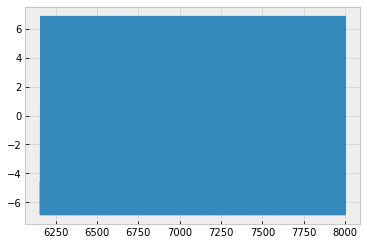

max in egs 6.837305344721447
finish this plot
Omega 1.346693386773547


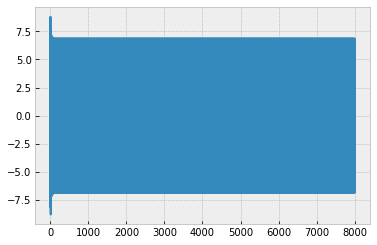

6.849102685272651


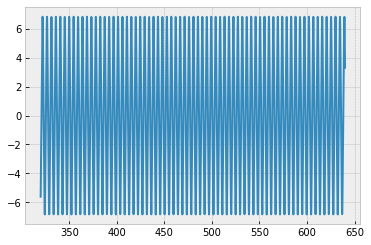

6.84844657989778


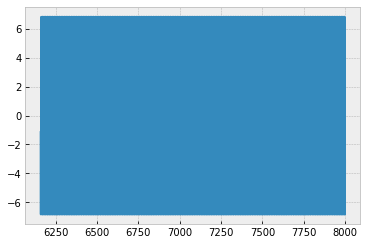

max in egs 6.848439407447791
finish this plot
Omega 1.3527054108216432


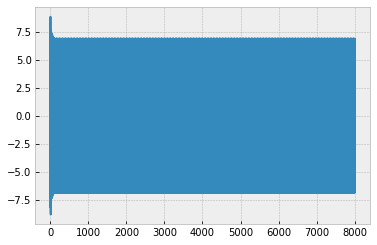

6.8602450263786645


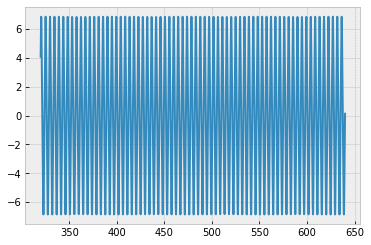

6.8596775852791465


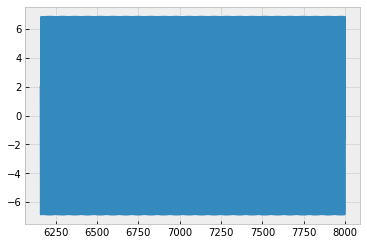

max in egs 6.8596775264024465
finish this plot
Omega 1.3587174348697395


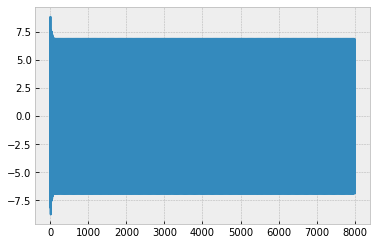

6.87116217743126


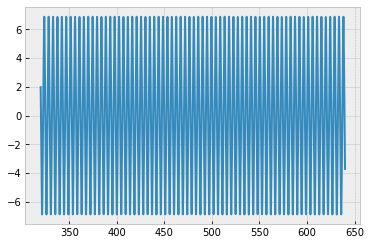

6.870998357329055


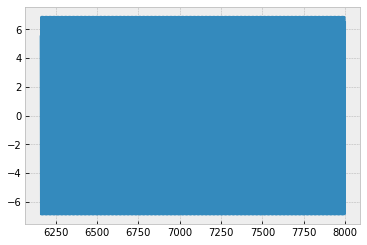

max in egs 6.870998148233895
finish this plot


KeyboardInterrupt: 

In [70]:
D_3 = 0.1
omegas = np.linspace(0, 3, 500)
AmpND3 = []
f = FloatProgress(min=0, max=500)
display(f)
for o in omegas:
    Omega = o
    time = 8000
    steps = 100000
    co, ts, ges = coordForcedOsz(y0, 0, time, steps, D3=True)
    cAmpND3, err = eingeschwungen(co, ts)
    print('Omega', Omega)
    #if round(o) == 1 or round(o) == 2:
    plt.plot(ts, co)
    plt.show()
    plt.plot(ts[4000:8000], co[4000:8000])
    print(max(co[2000:8000]))
    plt.show()
    plt.plot(ts[77000:], co[77000:])
    print(max(co[60000:]))
    plt.show()
    print('max in egs', cAmpND3)
    print('finish this plot')
    #plt.plot(ts, co)
    #plt.show()
    f.value += 1
    AmpND3.append(cAmpND3)

In [ ]:
plt.plot(omegasn, AmpN)
plt.show()
plt.plot(omegas, AmpND3)

In [ ]:
omegas = np.linspace(5, 0, 100)
AmpND3 = []
for o in omegas:
    Omega = o
    time = 8000
    steps = 10000
    co, ts, ges = coordForcedOsz(y0, 0, time, steps, D3=True)
    cAmpND3, err = eingeschwungen(co, ts)
    #plt.plot(ts, co)
    #plt.show()
    AmpND3.append(cAmpND3)

In [ ]:
plt.plot(omegas, AmpND3, 'or')
plt.plot(omegas, Ampold, 'og')

In [ ]:
A, Omega, epsilon = sy.symbols('A, \Omega, \epsilon')
eq = sy.Eq(((Omega**2-omega**2-3/4*D_3*A**2)**2+(gamma*Omega)**2)*A**2, (F0/m)**2)
display(sy.simplify(eq))
eq2 = sy.simplify(eq.subs(epsilon, 1e-16).subs(Omega, 0.65))
display(eq2)

In [ ]:
sol = sy.solve(eq2, A)
display(sol)

In [ ]:
eq3 = sy.Eq(A, sy.sqrt(4*(Omega**2-omega**2)/(3*D_3)))
display(eq3.subs(Omega,1))

In [ ]:
co, ts = coordForcedOsz(y0, 0, 700, 10000, D3=True)
#print(co)
plt.plot(ts, co, 'g')
plt.show()

In [ ]:
F0 = 100     # Kraftamplitude
m = 100       # Masse
c = 10       # Reibungskoeffizient
D = 50       # Federkonstante
gamma = c/(2*m)
omega = np.sqrt(D/m)
Omega = np.pi # äußere Kreisfrequenz

In [ ]:
y0 = [2., 0.]
co, ts = coordForcedOsz(y0, 0, 1000, 1000000)
#print(co)AmpN = []
plt.plot(ts, co)

In [ ]:
omegas = np.linspace(0, 1, 100)
AmpN = []
for o in omegas:
    Omega = o
    time = 8000
    steps = 10000
    co, ts = coordForcedOsz(y0, 0, time, steps)
    cAmpN, err = eingeschwungen(co, ts)
    AmpN.append(cAmpN)

In [ ]:
omegas = np.linspace(0, 5, 100)
AmpND3 = []
for o in omegas:
    Omega = o
    time = 8000
    steps = 10000
    co, ts = coordForcedOsz(y0, 0, time, steps, D3=True)
    cAmpND3, err = eingeschwungen(co, ts)
    AmpND3.append(cAmpND3)

In [ ]:
plt.plot(omegas, AmpND3)

In [ ]:
#omegas = np.linspace(0, 1, 100)
cAmp = coorAmp(omegas)
#AmpN = cooAmpN(omegas)
plt.plot(omegas, AmpN)
plt.plot(omegas, cAmp, ':')
plt.plot(omegas, AmpND3)
l = [i for i in np.arange(min(cAmp), max(cAmp), max(cAmp)/1000)]
om0 = np.sqrt(D/m)
plt.plot([om0 for h in l], l)
#plt.show()
print(om0)
print(D/m)

In [ ]:
plt.plot(ts[500000:], co[500000:])

In [ ]:
xs, ts_a = analyticalForcedOsz(y0, 0, 100, 1000)
plt.plot(ts_a, xs, ':')
plt.show()
co, ts = coordForcedOsz(y0, 0, 100, 1000, D3=True)
#print(co)
plt.plot(ts, co, 'g')
plt.show()
plt.plot(ts[500:], co[500:])
plt.show()

In [ ]:
omegas = np.linspace(0, 5, 1000)
cAmp = coorAmp(omegas)
plt.plot(omegas, cAmp)
l = [i for i in np.arange(min(cAmp), max(cAmp), max(cAmp)/1000)]
om0 = np.sqrt(D/m)
plt.plot([om0 for h in l], l)
plt.show()

In [ ]:
F0 = 100      # Kraftamplitude
m = 1        # Masse
c = 10       # Reibungskoeffizient
D = 5        # Federkonstante
gamma = c/(2*m)
omega = np.sqrt(D/m)
print(omega)
Omega = 0 # äußere Kreisfrequenz

In [ ]:
omegas = np.linspace(0, 5, 100)
AmpN = []
AmpND3 = []
for o in omegas:
    Omega = o
    time = 8000
    steps = 10000
    co, ts = coordForcedOsz(y0, 0, time, steps)
    cAmpN, err = eingeschwungen(co, ts)
    co, ts = coordForcedOsz(y0, 0, time, steps, D3=True)
    cAmpND3, err = eingeschwungen(co, ts)
    AmpN.append(cAmpN)
    AmpND3.append(cAmpND3)
    

In [ ]:
y0 = [1., 0.]
co, ts = coordForcedOsz(y0, 0, 1000, 10000)
#print(co)
plt.plot(ts, co)
#xs, ts_a = analyticalForcedOsz(y0, 0, 100, 100)
#plt.plot(ts_a, xs, ':')
plt.show()
co, ts = coordForcedOsz(y0, 0, 100, 1000, D3=True)
#print(co)
plt.plot(ts, co, 'g')
plt.show()
plt.plot(ts, co)
plt.show()

In [ ]:
omegas = np.linspace(0, 5, 100)
cAmp = coorAmp(omegas)
plt.plot(omegas, cAmp)
print(omegas)
print(AmpN)
plt.plot(omegas, AmpN)
plt.plot(omegas, AmpND3)
l = [i for i in np.arange(min(cAmp), max(cAmp), max(cAmp)/1000)]
om0 = np.sqrt(D/m)
plt.plot([om0 for h in l], l)
plt.show()

In [ ]:
#### F0 = 1      # Kraftamplitude
m = 1        # Masse
D = 5        # Federkonstante
c = np.sqrt((4*D*m))       # Reibungskoeffizient
Omega = 2*np.pi # äußere Kreisfrequenz
gamma = c/(2*m)
omega = np.sqrt(D/m)

In [ ]:
y0 = [2, 0.]
co, ts = coordForcedOsz(y0, 0, 80, 10000)
#print(co)
plt.plot(ts, co)
xs, ts_a = analyticalForcedOsz(y0, 0, 80, 1000)
plt.plot(ts_a, xs, ':')
plt.show()
co, ts = coordForcedOsz(y0, 0, 100, 10000, D3=True)
#print(co)
plt.plot(ts, co, 'g')
plt.show()
plt.plot(ts[500:], co[500:])
plt.show()

In [ ]:
omegas = np.linspace(0, 100, 10000)
cAmp = coorAmp(omegas)
plt.plot(omegas, cAmp)
l = [i for i in np.arange(min(cAmp), max(cAmp), max(cAmp)/1000)]
om0 = np.sqrt(D/m)
plt.plot([om0 for h in l], l)
plt.show()

### 4. Das nichtlineare Pendel II
Betrachten Sie die nichtlineare, erzwungene Schwingung mit der Differentialgleichung:

$$ \ddot{\theta} + c \dot{\theta} + \omega_{0}^2 \mathrm{sin}(\theta) = F_0 \mathrm{cos}(\Omega t)$$

mit $\omega_0 = 1, c= 0.5 \ \mathrm{und} \ \Omega = 0.6$. Stellen Sie $\theta$ als Funktion der Zeit graphisch dar und betrachten Sie den Phasenraum ($\dot{\theta}$ als Funktion von $\theta$) für verschiedene Kraftamplituden $0.1 < F_0 < 1.5$. Die Anfangsbedingungen seien $\theta_0=1$ und $\dot{\theta}_0 = 0$. Beschreiben Sie Ihre Beobachtungen.

###### 